### Name: Silas Kati
### x500: kati0012

## Imports

In [18]:
import os
import pickle
import copy
from pprint import pprint
import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns
%matplotlib inline
import mpl_scatter_density # adds projection='scatter_density'
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt
from scipy import stats
from sklearn.preprocessing import MinMaxScaler, RobustScaler, StandardScaler
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

In [19]:
# %% Importing Cartopy to visualize Earth data
import cartopy
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import cartopy.io.img_tiles as cimgt
import matplotlib.pyplot as plt
import cartopy.mpl.geoaxes
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
%matplotlib inline
import numpy as np
import os
import matplotlib        as mpl
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
from scipy.io import loadmat

In [3]:
# Restore all models
%store -r

## Dataset Understanding

In [3]:
dir_path = "C:\\Users\\silas\\PycharmProjects\\Project\\Dataset"

In [4]:
dataset = "sat_dat_data.csv"

In [5]:
df = pd.read_csv(os.path.join(dir_path, dataset), low_memory=False)

In [20]:
df.size

412110231

In [87]:
df.shape

(31700787, 13)

In [8]:
len(df)

31700787

In [8]:
df.info(memory_usage = "deep")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31700787 entries, 0 to 31700786
Data columns (total 13 columns):
 #   Column        Dtype  
---  ------        -----  
 0   density       float64
 1   snowtemp      float64
 2   soiltemp      float64
 3   omega         float64
 4   Tbh           float64
 5   Tbv           float64
 6   cf            float64
 7   h             float64
 8   bulk_density  float64
 9   lat           float64
 10  lon           float64
 11  date          object 
 12  voc           float64
dtypes: float64(12), object(1)
memory usage: 4.8 GB


In [7]:
df.rename(columns={'density': 'snow_density',
                   'snowtemp': 'snow_temp',
                   'soiltemp': 'soil_temp',
                   'voc': 'vod'}, inplace=True)

In [21]:
df.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,268.206835,273.037231,0.077934,250.853485,255.755310,0.167626,1.250319,0.959070,62.684110,-160.44087,01_01_2019,0.360216
1,161.904102,270.752674,272.944916,0.078347,252.357315,255.754684,0.170824,1.239644,0.973190,62.532246,-160.44087,01_01_2019,0.343348
2,163.183896,270.971431,272.960205,0.079091,254.316711,257.457397,0.176738,1.237796,0.997815,62.381150,-160.44087,01_01_2019,0.363338
3,164.070027,271.314168,272.987762,0.079008,254.165604,258.057922,0.165714,1.237237,0.981988,62.230810,-160.44087,01_01_2019,0.360973
4,158.706063,269.161864,272.945801,0.079000,250.542023,254.916229,0.166220,1.237293,0.953300,62.684110,-160.34750,01_01_2019,0.359798


In [13]:
df.describe().round(2)

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,vod
count,31700787.00,31700787.00,31700787.00,31700787.00,31700787.00,31700787.00,31700787.00,31700787.00,31700787.00,31700787.00,31700787.00,31700787.00
mean,178.59,258.36,268.80,0.07,246.69,254.80,0.17,0.79,1.08,54.15,32.71,0.35
std,43.66,8.85,3.95,0.02,12.71,9.24,0.05,0.47,0.16,10.81,107.49,0.39
min,100.00,218.77,236.15,0.00,32.73,53.23,0.00,0.01,0.49,-55.22,-179.95,-0.00
25%,150.74,252.71,266.93,0.07,240.61,252.37,0.15,0.47,0.97,48.21,-97.05,0.07
50%,157.78,259.42,269.96,0.07,249.52,256.49,0.17,0.72,1.04,55.84,92.10,0.25
75%,193.96,264.96,271.81,0.07,254.84,259.47,0.19,1.03,1.19,62.08,118.24,0.35
max,450.00,273.16,273.10,0.10,339.62,338.98,0.55,9.93,1.64,81.25,179.95,1.50


snow_density       AxesSubplot(0.125,0.536818;0.110714x0.343182)
snow_temp       AxesSubplot(0.257857,0.536818;0.110714x0.343182)
soil_temp       AxesSubplot(0.390714,0.536818;0.110714x0.343182)
omega           AxesSubplot(0.523571,0.536818;0.110714x0.343182)
Tbh             AxesSubplot(0.656429,0.536818;0.110714x0.343182)
Tbv             AxesSubplot(0.789286,0.536818;0.110714x0.343182)
cf                    AxesSubplot(0.125,0.125;0.110714x0.343182)
h                  AxesSubplot(0.257857,0.125;0.110714x0.343182)
bulk_density       AxesSubplot(0.390714,0.125;0.110714x0.343182)
lat                AxesSubplot(0.523571,0.125;0.110714x0.343182)
lon                AxesSubplot(0.656429,0.125;0.110714x0.343182)
vod                AxesSubplot(0.789286,0.125;0.110714x0.343182)
dtype: object

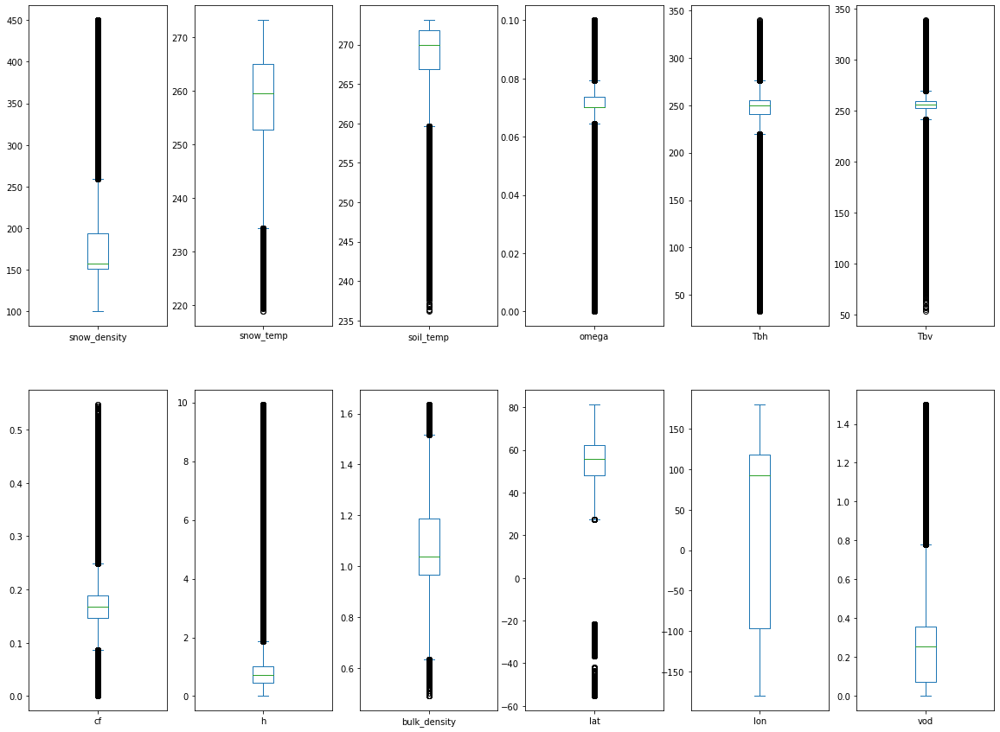

In [17]:
df.plot(kind='box', subplots=True, sharey=False, figsize=(20, 15), layout=(2,6))

In [100]:
corr_mat = df.corr().round(2)

In [16]:
corr_mat

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,vod
snow_density,1.00,0.47,0.29,0.18,0.01,-0.00,0.06,0.11,-0.35,0.37,-0.13,0.03
snow_temp,0.47,1.00,0.36,0.05,-0.06,0.06,0.05,-0.04,0.03,0.04,-0.00,0.02
soil_temp,0.29,0.36,1.00,0.23,0.18,0.17,0.08,-0.01,-0.17,0.17,-0.22,0.19
omega,0.18,0.05,0.23,1.00,0.26,0.04,0.54,-0.00,-0.49,0.49,-0.20,0.29
Tbh,0.01,-0.06,0.18,0.26,1.00,0.89,0.02,0.12,-0.38,0.21,0.05,0.31
Tbv,-0.00,0.06,0.17,0.04,0.89,1.00,-0.10,0.00,-0.13,0.03,0.14,0.14
cf,0.06,0.05,0.08,0.54,0.02,-0.10,1.00,-0.02,-0.09,0.26,-0.18,0.03
h,0.11,-0.04,-0.01,-0.00,0.12,0.00,-0.02,1.00,-0.21,0.07,0.11,-0.13
bulk_density,-0.35,0.03,-0.17,-0.49,-0.38,-0.13,-0.09,-0.21,1.00,-0.61,-0.04,-0.35
lat,0.37,0.04,0.17,0.49,0.21,0.03,0.26,0.07,-0.61,1.00,-0.23,0.11


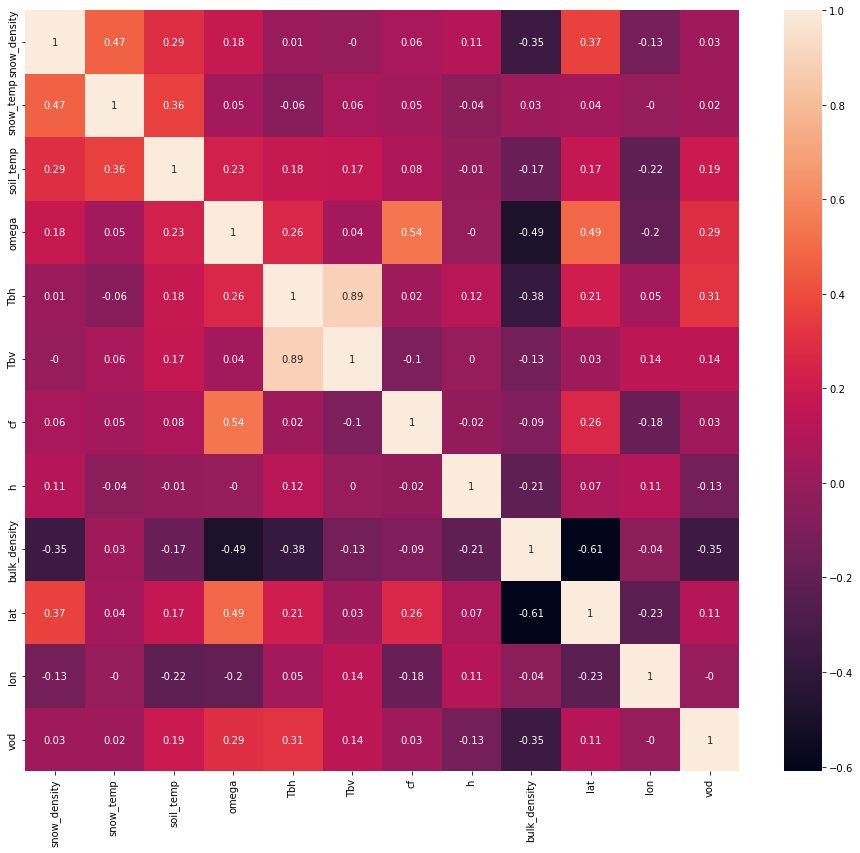

In [17]:
plt.figure(figsize = (16,14))
sns.heatmap(corr_mat, annot=True)
plt.show()

## Univariate analysis on the above features

### For target variable Snow Density

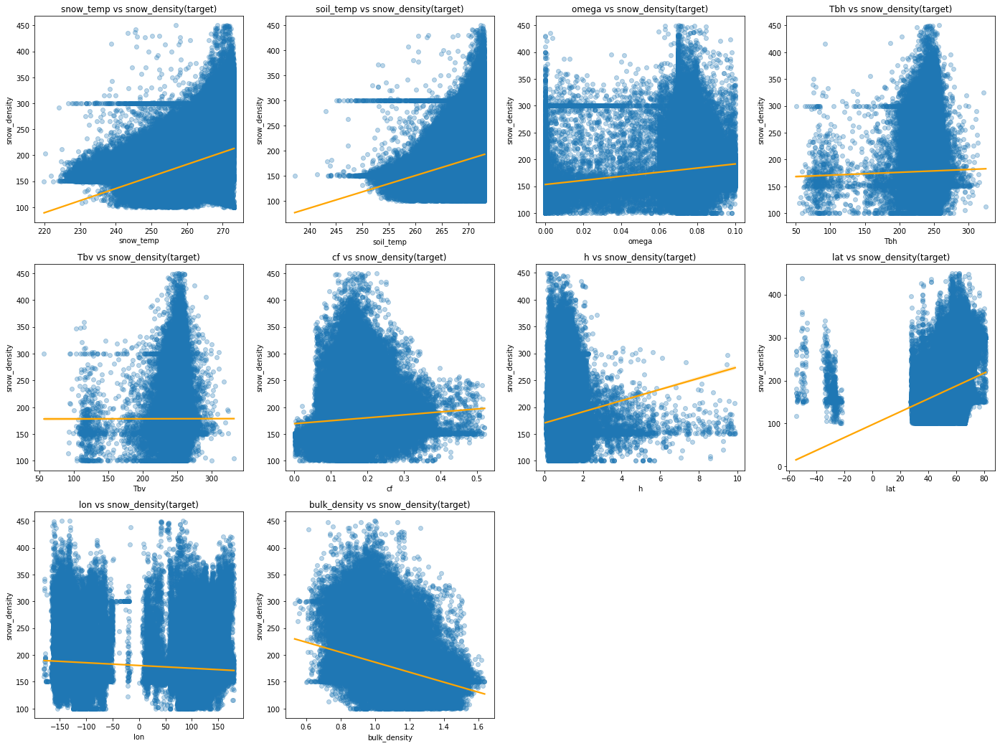

In [19]:
plt.figure(figsize=(24,18))

plt.subplot(3,4,1)
sns.regplot(x='snow_temp', y='snow_density', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('snow_temp vs snow_density(target)')

plt.subplot(3,4,2)
sns.regplot(x='soil_temp', y='snow_density', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('soil_temp vs snow_density(target)')

plt.subplot(3,4,3)
sns.regplot(x='omega', y='snow_density', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('omega vs snow_density(target)')

plt.subplot(3,4,4)
sns.regplot(x='Tbh', y='snow_density', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('Tbh vs snow_density(target)')

plt.subplot(3,4,5)
sns.regplot(x='Tbv', y='snow_density', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('Tbv vs snow_density(target)')

plt.subplot(3,4,6)
sns.regplot(x='cf', y='snow_density', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('cf vs snow_density(target)')

plt.subplot(3,4,7)
sns.regplot(x='h', y='snow_density', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('h vs snow_density(target)')

plt.subplot(3,4,8)
sns.regplot(x='lat', y='snow_density', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('lat vs snow_density(target)')

plt.subplot(3,4,9)
sns.regplot(x='lon', y='snow_density', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('lon vs snow_density(target)')

plt.subplot(3,4,10)
sns.regplot(x='bulk_density', y='snow_density', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('bulk_density vs snow_density(target)')
            
plt.show()

### For target variable VOD

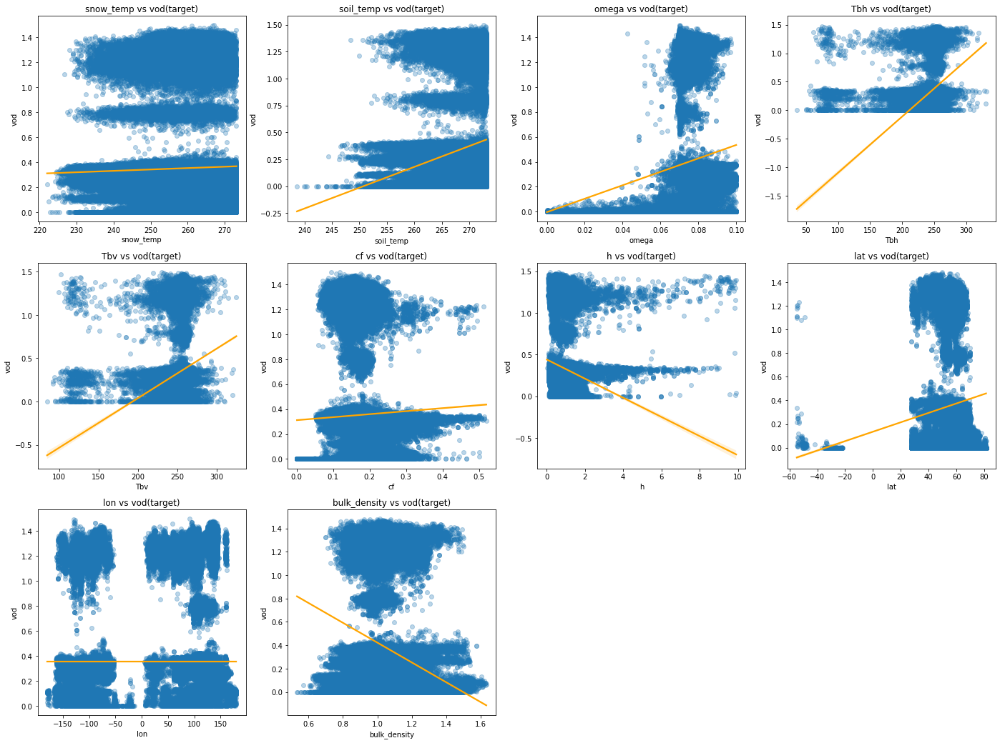

In [22]:
plt.figure(figsize=(24,18))

plt.subplot(3,4,1)
sns.regplot(x='snow_temp', y='vod', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('snow_temp vs vod(target)')

plt.subplot(3,4,2)
sns.regplot(x='soil_temp', y='vod', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('soil_temp vs vod(target)')

plt.subplot(3,4,3)
sns.regplot(x='omega', y='vod', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('omega vs vod(target)')

plt.subplot(3,4,4)
sns.regplot(x='Tbh', y='vod', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('Tbh vs vod(target)')

plt.subplot(3,4,5)
sns.regplot(x='Tbv', y='vod', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('Tbv vs vod(target)')

plt.subplot(3,4,6)
sns.regplot(x='cf', y='vod', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('cf vs vod(target)')

plt.subplot(3,4,7)
sns.regplot(x='h', y='vod', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('h vs vod(target)')

plt.subplot(3,4,8)
sns.regplot(x='lat', y='vod', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('lat vs vod(target)')

plt.subplot(3,4,9)
sns.regplot(x='lon', y='vod', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('lon vs vod(target)')

plt.subplot(3,4,10)
sns.regplot(x='bulk_density', y='vod', data=df.sample(frac = 0.01), scatter_kws={'alpha':0.3}, line_kws={'color':'orange'})
plt.title('bulk_density vs vod(target)')
            
plt.show()

# Snow Density

## Dataset Split

#### Random Test Train Split on only 2019

In [290]:
df1 = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [291]:
X = df1[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y = df1['snow_density']

In [297]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, shuffle=True, random_state=0)

#### Train 2019, Test 2020

In [24]:
train = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [25]:
train.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,268.206835,273.037231,0.077934,250.853485,255.755310,0.167626,1.250319,0.959070,62.684110,-160.44087,01_01_2019,0.360216
1,161.904102,270.752674,272.944916,0.078347,252.357315,255.754684,0.170824,1.239644,0.973190,62.532246,-160.44087,01_01_2019,0.343348
2,163.183896,270.971431,272.960205,0.079091,254.316711,257.457397,0.176738,1.237796,0.997815,62.381150,-160.44087,01_01_2019,0.363338
3,164.070027,271.314168,272.987762,0.079008,254.165604,258.057922,0.165714,1.237237,0.981988,62.230810,-160.44087,01_01_2019,0.360973
4,158.706063,269.161864,272.945801,0.079000,250.542023,254.916229,0.166220,1.237293,0.953300,62.684110,-160.34750,01_01_2019,0.359798


In [26]:
X_train = train[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y_train = train['snow_density']

In [27]:
test = df[df["date"].apply(lambda x: x.split('_')[2] == '2020')]

In [28]:
test.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,0.797174,62.230810,-162.77490,01_01_2020,0.136579
18329588,176.776952,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,0.845337,62.081207,-162.77490,01_01_2020,0.371299
18329589,181.312867,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,0.873384,62.230810,-162.49481,01_01_2020,1.187509
18329590,183.489251,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,0.842133,62.381150,-162.40146,01_01_2020,0.367274
18329591,182.247955,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,0.940199,61.932335,-162.21474,01_01_2020,0.243427


In [29]:
X_test = test[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y_test = test['snow_density']

## Trying Scaling Techniques

#### MinMax

In [94]:
scaler = MinMaxScaler() 

#### Take 2019 and do train, val and test split

In [9]:
df1 = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [10]:
df1.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,268.206835,273.037231,0.077934,250.853485,255.755310,0.167626,1.250319,0.959070,62.684110,-160.44087,01_01_2019,0.360216
1,161.904102,270.752674,272.944916,0.078347,252.357315,255.754684,0.170824,1.239644,0.973190,62.532246,-160.44087,01_01_2019,0.343348
2,163.183896,270.971431,272.960205,0.079091,254.316711,257.457397,0.176738,1.237796,0.997815,62.381150,-160.44087,01_01_2019,0.363338
3,164.070027,271.314168,272.987762,0.079008,254.165604,258.057922,0.165714,1.237237,0.981988,62.230810,-160.44087,01_01_2019,0.360973
4,158.706063,269.161864,272.945801,0.079000,250.542023,254.916229,0.166220,1.237293,0.953300,62.684110,-160.34750,01_01_2019,0.359798


In [11]:
X = df1[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y = df1['snow_density']

In [12]:
X_scaled = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)

In [15]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.20, shuffle=True, random_state=0)

In [16]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
17720940,0.781561,0.941262,0.709649,0.723646,0.716712,0.285109,0.034816,0.843425,0.171725,0.571699
11233780,0.907268,0.945543,0.728440,0.722316,0.727172,0.219747,0.116229,0.846516,0.121920,0.428076
2485422,0.823962,0.849550,0.700000,0.639282,0.631964,0.307740,0.339076,0.760573,0.242283,0.640580
1154291,0.518025,0.803122,0.700000,0.711224,0.705540,0.340568,0.082276,0.800952,0.869780,0.404503
6723943,0.641780,0.902755,0.710169,0.681389,0.673606,0.397789,0.025987,0.814403,0.215305,0.602589


In [18]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
8175713,0.689661,0.898243,0.700000,0.719632,0.716880,0.315937,0.106072,0.832409,0.873930,0.449685
18055958,0.750584,0.919998,0.708403,0.691154,0.690761,0.359609,0.011335,0.832409,0.194812,0.551537
4853484,0.627939,0.984761,0.779338,0.717008,0.719574,0.451925,0.040825,0.773244,0.262776,0.542885
16883108,0.460363,0.940657,0.701653,0.738804,0.722278,0.320924,0.108938,0.819029,0.847211,0.465421
44884,0.696316,0.804377,0.000000,0.640849,0.696834,0.092715,0.032792,0.708750,0.750195,0.823778


#### Take whole of 2019 as train and whole 2020 as test

In [95]:
df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']] = scaler.fit_transform(df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']])


In [96]:
df.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,0.908916,0.998302,0.779338,0.710750,0.708752,0.305672,0.124832,0.408674,0.863969,0.054215,01_01_2019,0.360216
1,161.904102,0.955726,0.995804,0.783470,0.715650,0.708749,0.311526,0.123756,0.421018,0.862857,0.054215,01_01_2019,0.343348
2,163.183896,0.959748,0.996218,0.790908,0.722035,0.714708,0.322348,0.123569,0.442547,0.861749,0.054215,01_01_2019,0.363338
3,164.070027,0.966050,0.996963,0.790081,0.721543,0.716810,0.302173,0.123513,0.428711,0.860648,0.054215,01_01_2019,0.360973
4,158.706063,0.926476,0.995828,0.789999,0.709735,0.705815,0.303099,0.123518,0.403630,0.863969,0.054475,01_01_2019,0.359798


In [97]:
train = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [98]:
train.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,0.908916,0.998302,0.779338,0.710750,0.708752,0.305672,0.124832,0.408674,0.863969,0.054215,01_01_2019,0.360216
1,161.904102,0.955726,0.995804,0.783470,0.715650,0.708749,0.311526,0.123756,0.421018,0.862857,0.054215,01_01_2019,0.343348
2,163.183896,0.959748,0.996218,0.790908,0.722035,0.714708,0.322348,0.123569,0.442547,0.861749,0.054215,01_01_2019,0.363338
3,164.070027,0.966050,0.996963,0.790081,0.721543,0.716810,0.302173,0.123513,0.428711,0.860648,0.054215,01_01_2019,0.360973
4,158.706063,0.926476,0.995828,0.789999,0.709735,0.705815,0.303099,0.123518,0.403630,0.863969,0.054475,01_01_2019,0.359798


In [99]:
X_train = train[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y_train = train['snow_density']

In [100]:
test = df[df["date"].apply(lambda x: x.split('_')[2] == '2020')]

In [101]:
test.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,0.605666,0.979289,0.725619,0.710505,0.715126,0.305186,0.113270,0.267135,0.860648,0.047730,01_01_2020,0.136579
18329588,176.776952,0.608976,0.971580,0.746666,0.701298,0.703409,0.334429,0.104657,0.309242,0.859552,0.047730,01_01_2020,0.371299
18329589,181.312867,0.594961,0.918358,0.745378,0.709829,0.718960,0.299206,0.105855,0.333763,0.860648,0.048508,01_01_2020,1.187509
18329590,183.489251,0.589092,0.946560,0.737288,0.713899,0.722697,0.275514,0.112478,0.306441,0.861749,0.048768,01_01_2020,0.367274
18329591,182.247955,0.567396,0.862735,0.745613,0.695790,0.703448,0.363539,0.096604,0.392176,0.858461,0.049287,01_01_2020,0.243427


In [102]:
X_test = test[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y_test = test['snow_density']

In [103]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
0,0.908916,0.998302,0.779338,0.710750,0.708752,0.305672,0.124832,0.863969,0.054215,0.408674
1,0.955726,0.995804,0.783470,0.715650,0.708749,0.311526,0.123756,0.862857,0.054215,0.421018
2,0.959748,0.996218,0.790908,0.722035,0.714708,0.322348,0.123569,0.861749,0.054215,0.442547
3,0.966050,0.996963,0.790081,0.721543,0.716810,0.302173,0.123513,0.860648,0.054215,0.428711
4,0.926476,0.995828,0.789999,0.709735,0.705815,0.303099,0.123518,0.863969,0.054475,0.403630


In [104]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
18329587,0.605666,0.979289,0.725619,0.710505,0.715126,0.305186,0.113270,0.860648,0.047730,0.267135
18329588,0.608976,0.971580,0.746666,0.701298,0.703409,0.334429,0.104657,0.859552,0.047730,0.309242
18329589,0.594961,0.918358,0.745378,0.709829,0.718960,0.299206,0.105855,0.860648,0.048508,0.333763
18329590,0.589092,0.946560,0.737288,0.713899,0.722697,0.275514,0.112478,0.861749,0.048768,0.306441
18329591,0.567396,0.862735,0.745613,0.695790,0.703448,0.363539,0.096604,0.858461,0.049287,0.392176


<AxesSubplot:>

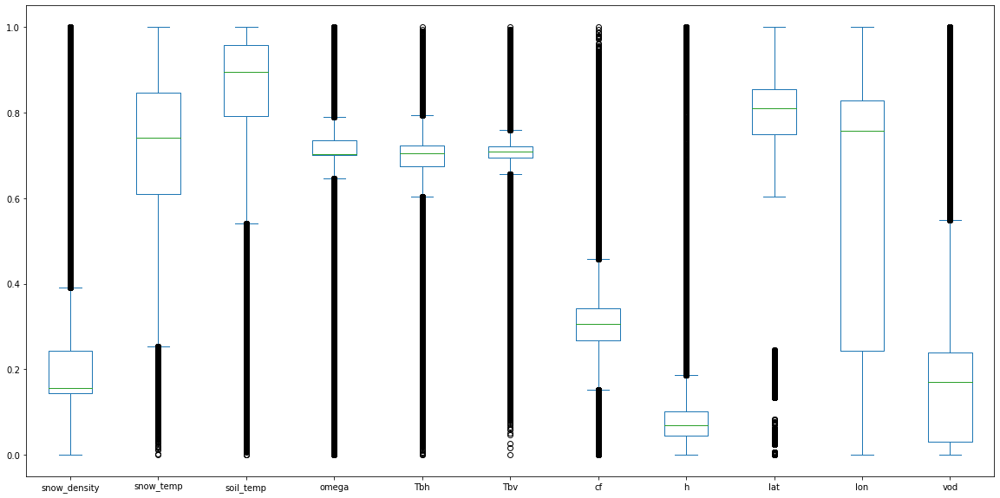

In [224]:
df_minmax_scaled.plot(kind='box', figsize=(20, 10))

#### Robust

In [128]:
scaler = RobustScaler()

#### Take 2019 and do train, val and test split

In [9]:
df1 = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [10]:
df1.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,268.206835,273.037231,0.077934,250.853485,255.755310,0.167626,1.250319,0.959070,62.684110,-160.44087,01_01_2019,0.360216
1,161.904102,270.752674,272.944916,0.078347,252.357315,255.754684,0.170824,1.239644,0.973190,62.532246,-160.44087,01_01_2019,0.343348
2,163.183896,270.971431,272.960205,0.079091,254.316711,257.457397,0.176738,1.237796,0.997815,62.381150,-160.44087,01_01_2019,0.363338
3,164.070027,271.314168,272.987762,0.079008,254.165604,258.057922,0.165714,1.237237,0.981988,62.230810,-160.44087,01_01_2019,0.360973
4,158.706063,269.161864,272.945801,0.079000,250.542023,254.916229,0.166220,1.237293,0.953300,62.684110,-160.34750,01_01_2019,0.359798


In [11]:
X = df1[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y = df1['snow_density']

In [12]:
X_scaled = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)

In [15]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.20, shuffle=True, random_state=0)

In [16]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
17720940,0.781561,0.941262,0.709649,0.723646,0.716712,0.285109,0.034816,0.843425,0.171725,0.571699
11233780,0.907268,0.945543,0.728440,0.722316,0.727172,0.219747,0.116229,0.846516,0.121920,0.428076
2485422,0.823962,0.849550,0.700000,0.639282,0.631964,0.307740,0.339076,0.760573,0.242283,0.640580
1154291,0.518025,0.803122,0.700000,0.711224,0.705540,0.340568,0.082276,0.800952,0.869780,0.404503
6723943,0.641780,0.902755,0.710169,0.681389,0.673606,0.397789,0.025987,0.814403,0.215305,0.602589


In [18]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
8175713,0.689661,0.898243,0.700000,0.719632,0.716880,0.315937,0.106072,0.832409,0.873930,0.449685
18055958,0.750584,0.919998,0.708403,0.691154,0.690761,0.359609,0.011335,0.832409,0.194812,0.551537
4853484,0.627939,0.984761,0.779338,0.717008,0.719574,0.451925,0.040825,0.773244,0.262776,0.542885
16883108,0.460363,0.940657,0.701653,0.738804,0.722278,0.320924,0.108938,0.819029,0.847211,0.465421
44884,0.696316,0.804377,0.000000,0.640849,0.696834,0.092715,0.032792,0.708750,0.750195,0.823778


#### Take whole of 2019 as train and whole 2020 as test

In [129]:
df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']] = scaler.fit_transform(df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']])


In [130]:
df.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,0.716902,0.632292,2.066673,0.093482,-0.103660,-0.018768,0.948204,-0.357570,0.493368,-1.173027,01_01_2019,0.360216
1,161.904102,0.924634,0.613351,2.177784,0.199158,-0.103748,0.059500,0.929132,-0.293506,0.482420,-1.173027,01_01_2019,0.343348
2,163.183896,0.942483,0.616488,2.377786,0.336847,0.135919,0.204211,0.925830,-0.181778,0.471527,-1.173027,01_01_2019,0.363338
3,164.070027,0.970449,0.622142,2.355562,0.326229,0.220447,-0.065557,0.924831,-0.253585,0.460689,-1.173027,01_01_2019,0.360973
4,158.706063,0.794829,0.613533,2.353343,0.071595,-0.221765,-0.053179,0.924931,-0.383749,0.493368,-1.172593,01_01_2019,0.359798


In [131]:
train = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [132]:
train.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,0.716902,0.632292,2.066673,0.093482,-0.103660,-0.018768,0.948204,-0.357570,0.493368,-1.173027,01_01_2019,0.360216
1,161.904102,0.924634,0.613351,2.177784,0.199158,-0.103748,0.059500,0.929132,-0.293506,0.482420,-1.173027,01_01_2019,0.343348
2,163.183896,0.942483,0.616488,2.377786,0.336847,0.135919,0.204211,0.925830,-0.181778,0.471527,-1.173027,01_01_2019,0.363338
3,164.070027,0.970449,0.622142,2.355562,0.326229,0.220447,-0.065557,0.924831,-0.253585,0.460689,-1.173027,01_01_2019,0.360973
4,158.706063,0.794829,0.613533,2.353343,0.071595,-0.221765,-0.053179,0.924931,-0.383749,0.493368,-1.172593,01_01_2019,0.359798


In [133]:
X_train = train[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y_train = train['snow_density']

In [134]:
test = df[df["date"].apply(lambda x: x.split('_')[2] == '2020')]

In [135]:
test.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,-0.628844,0.488143,0.622224,0.088194,0.152715,-0.025272,0.743431,-1.092131,0.460689,-1.183868,01_01_2020,0.136579
18329588,176.776952,-0.614156,0.429693,1.188158,-0.110352,-0.318561,0.365746,0.590880,-0.873605,0.449904,-1.183868,01_01_2020,0.371299
18329589,181.312867,-0.676350,0.026179,1.153509,0.073632,0.306933,-0.105226,0.612101,-0.746346,0.460689,-1.182567,01_01_2020,1.187509
18329590,183.489251,-0.702396,0.239998,0.935977,0.161392,0.457242,-0.422027,0.729401,-0.888140,0.471527,-1.182134,01_01_2020,0.367274
18329591,182.247955,-0.798676,-0.395543,1.159850,-0.229139,-0.316959,0.754991,0.448262,-0.443193,0.439172,-1.181266,01_01_2020,0.243427


In [136]:
X_test = test[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y_test = test['snow_density']

In [137]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
0,0.716902,0.632292,2.066673,0.093482,-0.103660,-0.018768,0.948204,0.493368,-1.173027,-0.357570
1,0.924634,0.613351,2.177784,0.199158,-0.103748,0.059500,0.929132,0.482420,-1.173027,-0.293506
2,0.942483,0.616488,2.377786,0.336847,0.135919,0.204211,0.925830,0.471527,-1.173027,-0.181778
3,0.970449,0.622142,2.355562,0.326229,0.220447,-0.065557,0.924831,0.460689,-1.173027,-0.253585
4,0.794829,0.613533,2.353343,0.071595,-0.221765,-0.053179,0.924931,0.493368,-1.172593,-0.383749


In [138]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
18329587,-0.628844,0.488143,0.622224,0.088194,0.152715,-0.025272,0.743431,0.460689,-1.183868,-1.092131
18329588,-0.614156,0.429693,1.188158,-0.110352,-0.318561,0.365746,0.590880,0.449904,-1.183868,-0.873605
18329589,-0.676350,0.026179,1.153509,0.073632,0.306933,-0.105226,0.612101,0.460689,-1.182567,-0.746346
18329590,-0.702396,0.239998,0.935977,0.161392,0.457242,-0.422027,0.729401,0.471527,-1.182134,-0.888140
18329591,-0.798676,-0.395543,1.159850,-0.229139,-0.316959,0.754991,0.448262,0.439172,-1.181266,-0.443193


<AxesSubplot:>

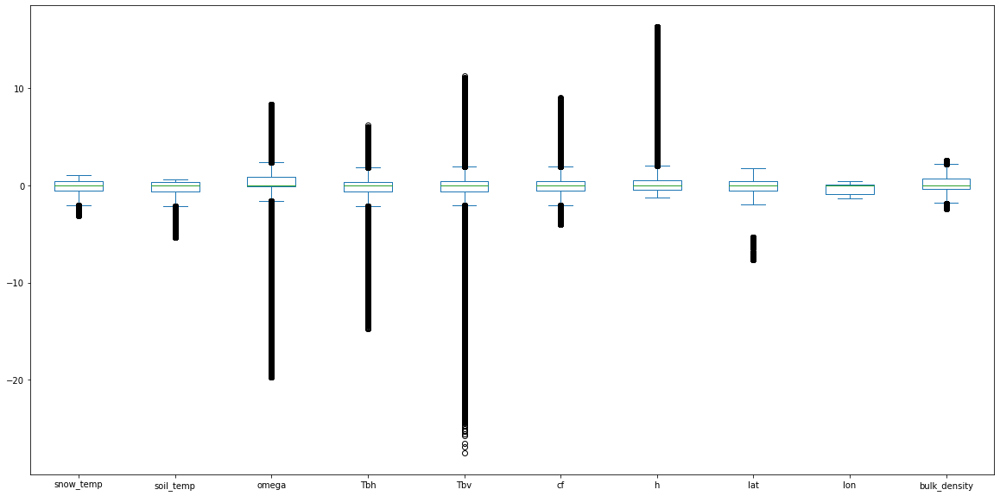

In [150]:
X_train_scaled.plot(kind='box', figsize=(20, 10))

#### Standard

In [162]:
scaler = StandardScaler() 

#### Take 2019 and do train, val and test split

In [9]:
df1 = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [10]:
df1.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,268.206835,273.037231,0.077934,250.853485,255.755310,0.167626,1.250319,0.959070,62.684110,-160.44087,01_01_2019,0.360216
1,161.904102,270.752674,272.944916,0.078347,252.357315,255.754684,0.170824,1.239644,0.973190,62.532246,-160.44087,01_01_2019,0.343348
2,163.183896,270.971431,272.960205,0.079091,254.316711,257.457397,0.176738,1.237796,0.997815,62.381150,-160.44087,01_01_2019,0.363338
3,164.070027,271.314168,272.987762,0.079008,254.165604,258.057922,0.165714,1.237237,0.981988,62.230810,-160.44087,01_01_2019,0.360973
4,158.706063,269.161864,272.945801,0.079000,250.542023,254.916229,0.166220,1.237293,0.953300,62.684110,-160.34750,01_01_2019,0.359798


In [11]:
X = df1[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y = df1['snow_density']

In [12]:
X_scaled = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)

In [15]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.20, shuffle=True, random_state=0)

In [16]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
17720940,0.781561,0.941262,0.709649,0.723646,0.716712,0.285109,0.034816,0.843425,0.171725,0.571699
11233780,0.907268,0.945543,0.728440,0.722316,0.727172,0.219747,0.116229,0.846516,0.121920,0.428076
2485422,0.823962,0.849550,0.700000,0.639282,0.631964,0.307740,0.339076,0.760573,0.242283,0.640580
1154291,0.518025,0.803122,0.700000,0.711224,0.705540,0.340568,0.082276,0.800952,0.869780,0.404503
6723943,0.641780,0.902755,0.710169,0.681389,0.673606,0.397789,0.025987,0.814403,0.215305,0.602589


In [18]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
8175713,0.689661,0.898243,0.700000,0.719632,0.716880,0.315937,0.106072,0.832409,0.873930,0.449685
18055958,0.750584,0.919998,0.708403,0.691154,0.690761,0.359609,0.011335,0.832409,0.194812,0.551537
4853484,0.627939,0.984761,0.779338,0.717008,0.719574,0.451925,0.040825,0.773244,0.262776,0.542885
16883108,0.460363,0.940657,0.701653,0.738804,0.722278,0.320924,0.108938,0.819029,0.847211,0.465421
44884,0.696316,0.804377,0.000000,0.640849,0.696834,0.092715,0.032792,0.708750,0.750195,0.823778


#### Take whole of 2019 as train and whole 2020 as test

In [163]:
df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']] = scaler.fit_transform(df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']])


In [164]:
df.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,1.113262,1.073475,0.569779,0.327774,0.103444,-0.025829,0.983535,-0.759116,0.789650,-1.796875,01_01_2019,0.360216
1,161.904102,1.400972,1.050109,0.589497,0.446137,0.103376,0.042764,0.960934,-0.672687,0.775604,-1.796875,01_01_2019,0.343348
2,163.183896,1.425694,1.053979,0.624992,0.600355,0.287561,0.169587,0.957021,-0.521954,0.761629,-1.796875,01_01_2019,0.363338
3,164.070027,1.464427,1.060954,0.621048,0.588462,0.352520,-0.066834,0.955837,-0.618830,0.747724,-1.796875,01_01_2019,0.360973
4,158.706063,1.221191,1.050333,0.620654,0.303260,0.012680,-0.055986,0.955955,-0.794435,0.789650,-1.796006,01_01_2019,0.359798


In [165]:
train = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [166]:
train.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,1.113262,1.073475,0.569779,0.327774,0.103444,-0.025829,0.983535,-0.759116,0.789650,-1.796875,01_01_2019,0.360216
1,161.904102,1.400972,1.050109,0.589497,0.446137,0.103376,0.042764,0.960934,-0.672687,0.775604,-1.796875,01_01_2019,0.343348
2,163.183896,1.425694,1.053979,0.624992,0.600355,0.287561,0.169587,0.957021,-0.521954,0.761629,-1.796875,01_01_2019,0.363338
3,164.070027,1.464427,1.060954,0.621048,0.588462,0.352520,-0.066834,0.955837,-0.618830,0.747724,-1.796875,01_01_2019,0.360973
4,158.706063,1.221191,1.050333,0.620654,0.303260,0.012680,-0.055986,0.955955,-0.794435,0.789650,-1.796006,01_01_2019,0.359798


In [167]:
X_train = train[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y_train = train['snow_density']

In [168]:
test = df[df["date"].apply(lambda x: x.split('_')[2] == '2020')]

In [169]:
test.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,-0.750608,0.895647,0.313434,0.321851,0.300468,-0.031529,0.740869,-1.750119,0.747724,-1.818588,01_01_2020,0.136579
18329588,176.776952,-0.730265,0.823541,0.413870,0.099469,-0.061708,0.311154,0.560089,-1.455303,0.733888,-1.818588,01_01_2020,0.371299
18329589,181.312867,-0.816404,0.325752,0.407721,0.305540,0.418985,-0.101600,0.585237,-1.283617,0.747724,-1.815982,01_01_2020,1.187509
18329590,183.489251,-0.852478,0.589527,0.369116,0.403837,0.534498,-0.379240,0.724243,-1.474913,0.761629,-1.815114,01_01_2020,0.367274
18329591,182.247955,-0.985826,-0.194500,0.408846,-0.033579,-0.060477,0.652284,0.391080,-0.874631,0.720118,-1.813377,01_01_2020,0.243427


In [170]:
X_test = test[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y_test = test['snow_density']

In [171]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
0,1.113262,1.073475,0.569779,0.327774,0.103444,-0.025829,0.983535,0.789650,-1.796875,-0.759116
1,1.400972,1.050109,0.589497,0.446137,0.103376,0.042764,0.960934,0.775604,-1.796875,-0.672687
2,1.425694,1.053979,0.624992,0.600355,0.287561,0.169587,0.957021,0.761629,-1.796875,-0.521954
3,1.464427,1.060954,0.621048,0.588462,0.352520,-0.066834,0.955837,0.747724,-1.796875,-0.618830
4,1.221191,1.050333,0.620654,0.303260,0.012680,-0.055986,0.955955,0.789650,-1.796006,-0.794435


In [172]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
18329587,-0.750608,0.895647,0.313434,0.321851,0.300468,-0.031529,0.740869,0.747724,-1.818588,-1.750119
18329588,-0.730265,0.823541,0.413870,0.099469,-0.061708,0.311154,0.560089,0.733888,-1.818588,-1.455303
18329589,-0.816404,0.325752,0.407721,0.305540,0.418985,-0.101600,0.585237,0.747724,-1.815982,-1.283617
18329590,-0.852478,0.589527,0.369116,0.403837,0.534498,-0.379240,0.724243,0.761629,-1.815114,-1.474913
18329591,-0.985826,-0.194500,0.408846,-0.033579,-0.060477,0.652284,0.391080,0.720118,-1.813377,-0.874631


<AxesSubplot:>

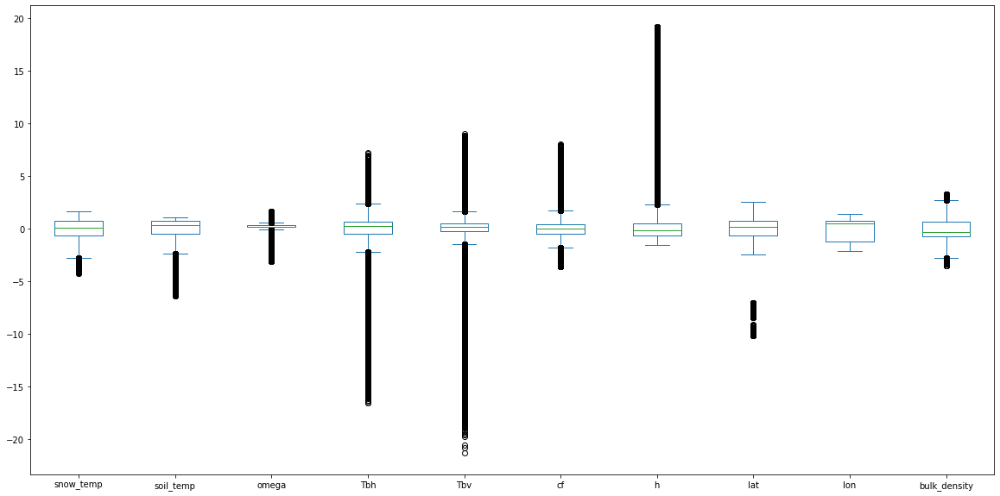

In [296]:
X_train_scaled.plot(kind='box', figsize=(20, 10))

## Actual Data Projection

In [56]:
org = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

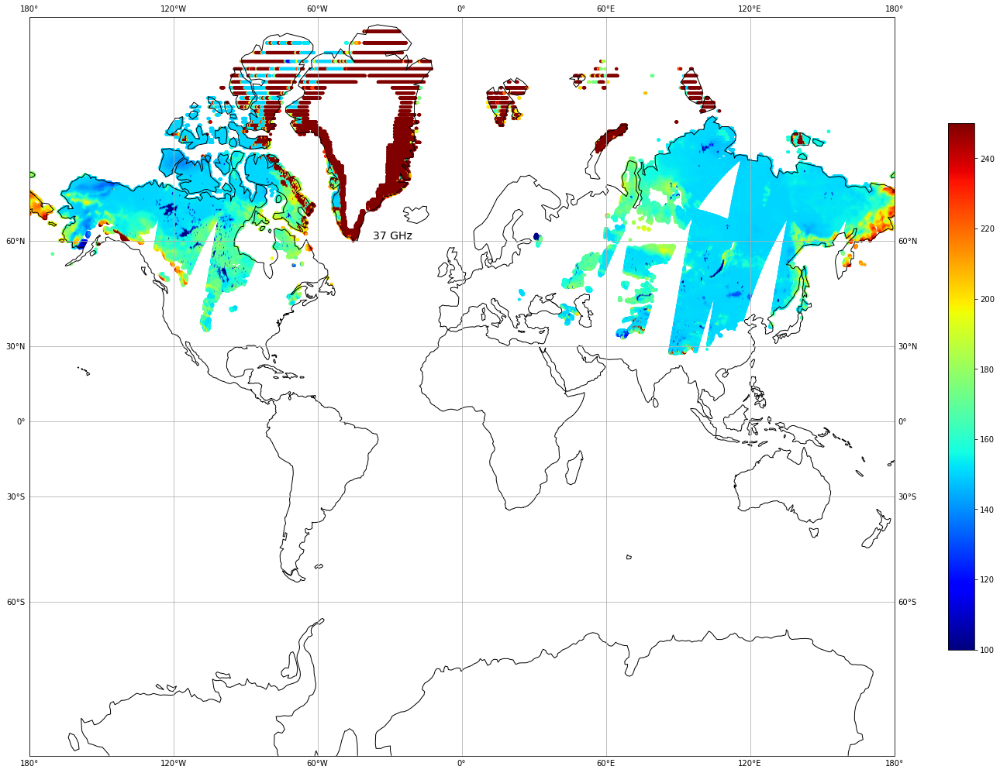

In [64]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(org["lon"], org["lat"], c=org["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

# Model Training

## Feature Selection

In [59]:
def select_features(X_train, y_train, X_test):
    # configure to select a subset of features
    fs = SelectKBest(score_func=f_regression, k=8)
    # learn relationship from training data
    fs.fit(X_train, y_train)
    
    fs.get_feature_names_out()
    # transform train input data
    X_train_fs = fs.transform(X_train)
    # transform test input data
    X_test_fs = fs.transform(X_test)
    
    return X_train_fs, X_test_fs, fs

In [60]:
X_train_fs, X_test_fs, fs = select_features(X_train, y_train, X_test)

In [179]:
fs.get_feature_names_out()

array(['soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'bulk_density',
       'lat'], dtype=object)

In [182]:
fs.get_support()

array([False,  True,  True,  True,  True,  True,  True,  True,  True,
       False])

Feature 0: 5919596.389974
Feature 1: 1969043.012554
Feature 2: 719944.526761
Feature 3: 3156.281764
Feature 4: 131.798035
Feature 5: 73555.336998
Feature 6: 267231.433801
Feature 7: 2888651.920929
Feature 8: 3368164.643166
Feature 9: 341846.211429


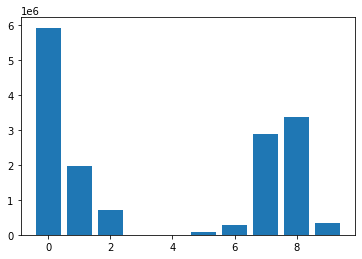

In [58]:
# what are scores for the features
for i in range(len(fs.scores_)):
    print('Feature %d: %f' % (i, fs.scores_[i]))
# plot the scores
plt.bar([i for i in range(len(fs.scores_))], fs.scores_)
plt.show()

## Decision Tree Regressor

### 2019 as Train/Test

#### Original Data

In [11]:
model = DecisionTreeRegressor(random_state=0) 

In [12]:
%%time
model.fit(X_train, y_train)

CPU times: total: 6min 43s
Wall time: 7min 19s


DecisionTreeRegressor(random_state=0)

In [13]:
model.score(X_train, y_train)

1.0

In [14]:
model.score(X_test, y_test)

0.8763228716433066

In [20]:
with open("Models\\DTR\\sd_dtr_model_org_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(model, file)

In [15]:
y_pred = model.predict(X_test)

In [16]:
mae = mean_absolute_error(y_test, y_pred)
mae

5.687177489527122

In [17]:
mse = mean_squared_error(y_test, y_pred)
mse

221.67378326504175

In [18]:
rmse = mse**(1/2.0)
rmse

14.888713284399083

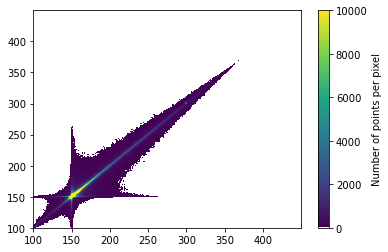

In [22]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [23]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [24]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [25]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [26]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN


In [30]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [31]:
y_sample_pred = model.predict(X_sample)

In [34]:
X_sample["snow_density"] = y_sample_pred

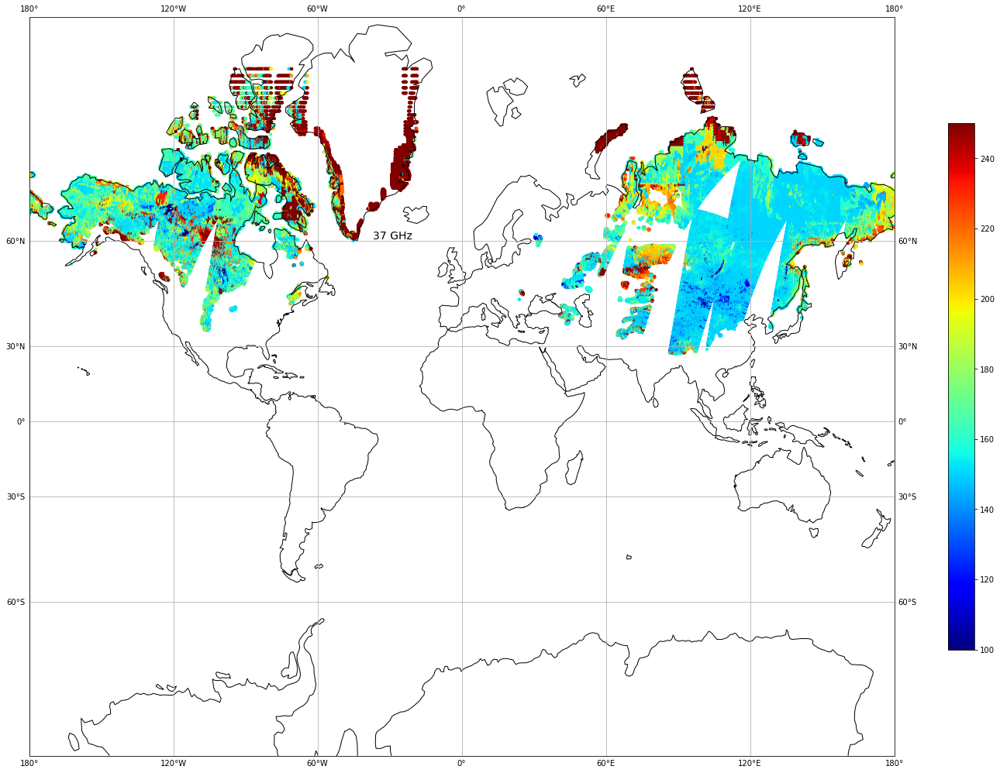

In [36]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

In [ ]:
import plotly.express as px
fig = px.density_mapbox(predict_sample, lat='lat', lon='lon', z='snow_density', radius=1, color_continuous_scale='Blues',
                        center=dict(lat=0, lon=180), zoom=0,
                        mapbox_style="open-street-map")
fig.show()

#### Pruning

In [42]:
# Taking too much time to run.

In [ ]:
path = model.cost_complexity_pruning_path(X_train, y_train)

In [ ]:
alphas = path['ccp_alphas']

In [ ]:
alphas

In [ ]:
train_acc = []
test_acc = []

In [ ]:
train_mse= []
test_mse = []

In [ ]:
for i in alphas:
    model = DecisionTreeRegressor(ccp_alpha=i)
    model.fit(X_train, y_train)
    
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)
    
    train_acc.append(model.score(X_train, y_train))
    test_acc.append(model.score(X_test, y_test))
    
    train_mse.append(mean_squared_error(y_test, y_train_pred))
    test_mse.append(mean_squared_error(y_test, y_test_pred))

In [35]:
sns.set()
plt.figure(figsize=(14,7))
sns.lineplot(y=train_acc, x=alphas, label="Model Train R2 Score")
sns.lineplot(y=test_acc, x=alphas, label="Model Test R2 Score")
plt.xticks(ticks=np.arange())
plt.show()

In [ ]:
sns.set()
plt.figure(figsize=(14,7))
sns.lineplot(y=train_mse, x=alphas, label="Model Train MSE")
sns.lineplot(y=test_mse, x=alphas, label="Model Test MSE")
plt.xticks(ticks=np.arange())
plt.show()

#### MinMax Scaled

In [19]:
model = DecisionTreeRegressor(random_state=0) 

In [20]:
%%time
model.fit(X_train, y_train)

CPU times: total: 6min 32s
Wall time: 7min 35s


DecisionTreeRegressor(random_state=0)

In [21]:
model.score(X_train, y_train)

1.0

In [22]:
model.score(X_test, y_test)

0.8759746166285957

In [23]:
with open("Models\\DTR\\sd_dtr_model_min_max_scaled_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(model, file)

In [24]:
y_pred = model.predict(X_test)

In [25]:
mae = mean_absolute_error(y_test, y_pred)
mae

5.693531267881096

In [26]:
mse = mean_squared_error(y_test, y_pred)
mse

222.29798118811567

In [27]:
rmse = mse**(1/2.0)
rmse

14.909660666430865

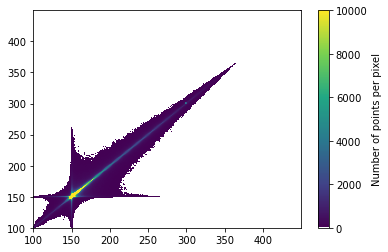

In [28]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [29]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [30]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [31]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [32]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN


In [33]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [34]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [35]:
y_sample_pred = model.predict(X_sample_scaled)

In [36]:
X_sample["snow_density"] = y_sample_pred

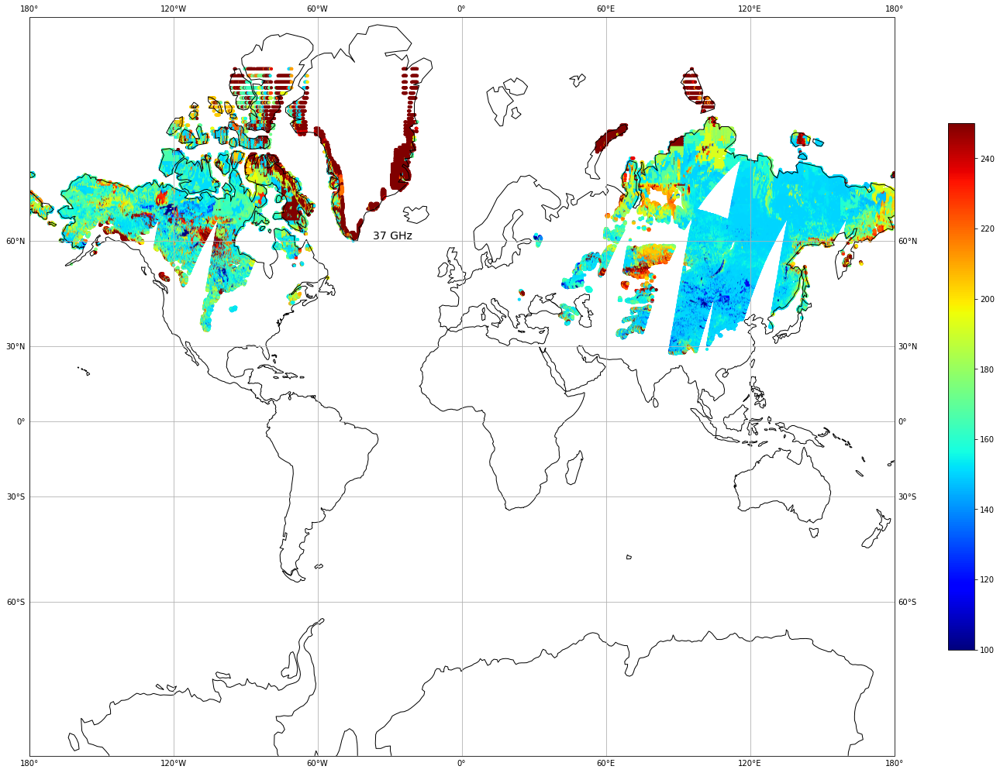

In [37]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

#### Robust Scaled

In [56]:
model = DecisionTreeRegressor(random_state=0) 

In [57]:
%%time
model.fit(X_train, y_train)

CPU times: total: 6min 40s
Wall time: 7min 42s


DecisionTreeRegressor(random_state=0)

In [58]:
model.score(X_train, y_train)

1.0

In [59]:
model.score(X_test, y_test)

0.8756073732185835

In [60]:
with open("Models\\DTR\\sd_dtr_model_robust_scaled_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(model, file)

In [61]:
y_pred = model.predict(X_test)

In [62]:
mae = mean_absolute_error(y_test, y_pred)
mae

5.703126057014899

In [63]:
mse = mean_squared_error(y_test, y_pred)
mse

222.95621312766843

In [64]:
rmse = mse**(1/2.0)
rmse

14.931718358168574

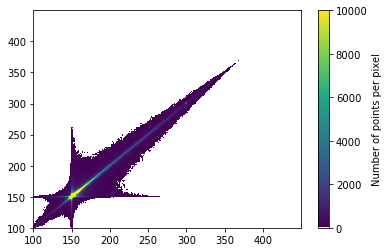

In [65]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [66]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [67]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [68]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [69]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN


In [70]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [71]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [72]:
y_sample_pred = model.predict(X_sample_scaled)

In [73]:
X_sample["snow_density"] = y_sample_pred

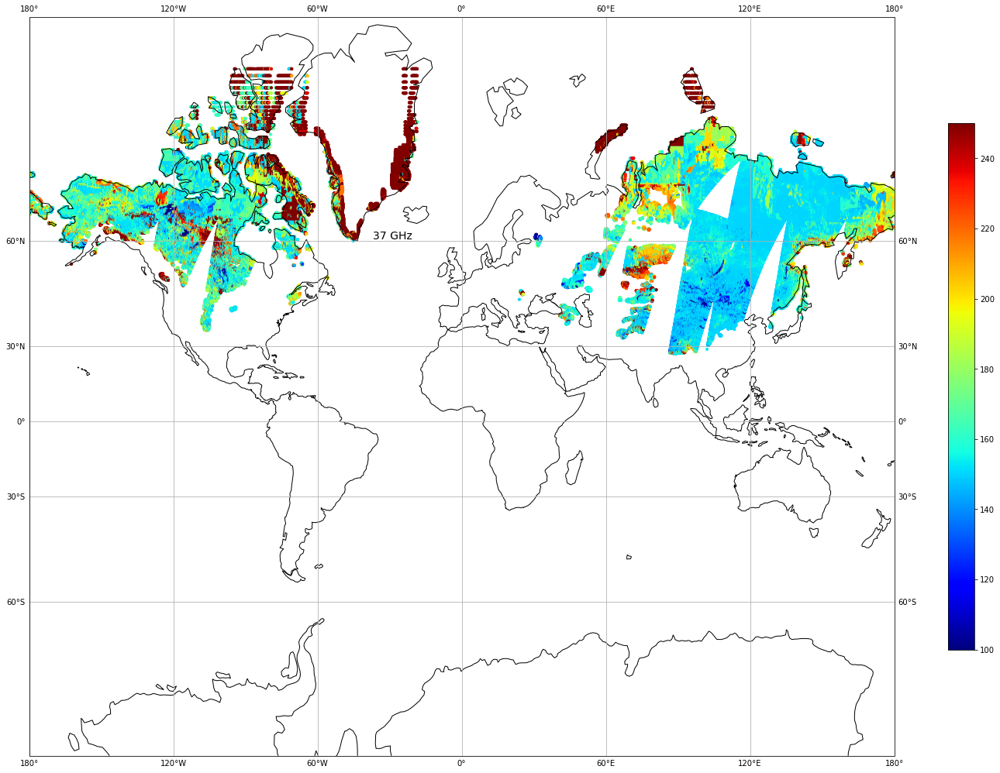

In [74]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

#### Standard Scaled

In [89]:
model = DecisionTreeRegressor(random_state=0) 

In [90]:
%%time
model.fit(X_train, y_train)

CPU times: total: 5min 46s
Wall time: 6min 31s


DecisionTreeRegressor(random_state=0)

In [91]:
model.score(X_train, y_train)

1.0

In [92]:
model.score(X_test, y_test)

0.8675480767775043

In [93]:
with open("Models\\DTR\\sd_dtr_model_standard_scaled_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(model, file)

In [94]:
y_pred = model.predict(X_test)

In [95]:
mae = mean_absolute_error(y_test, y_pred)
mae

5.982602422641975

In [96]:
mse = mean_squared_error(y_test, y_pred)
mse

237.47135135796526

In [97]:
rmse = mse**(1/2.0)
rmse

15.41010549470591

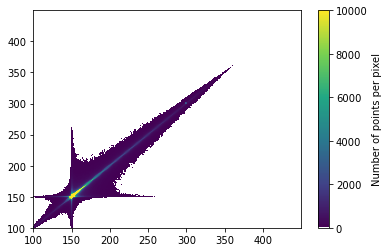

In [98]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [99]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [100]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [101]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [102]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN


In [103]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [104]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [105]:
y_sample_pred = model.predict(X_sample_scaled)

In [106]:
X_sample["snow_density"] = y_sample_pred

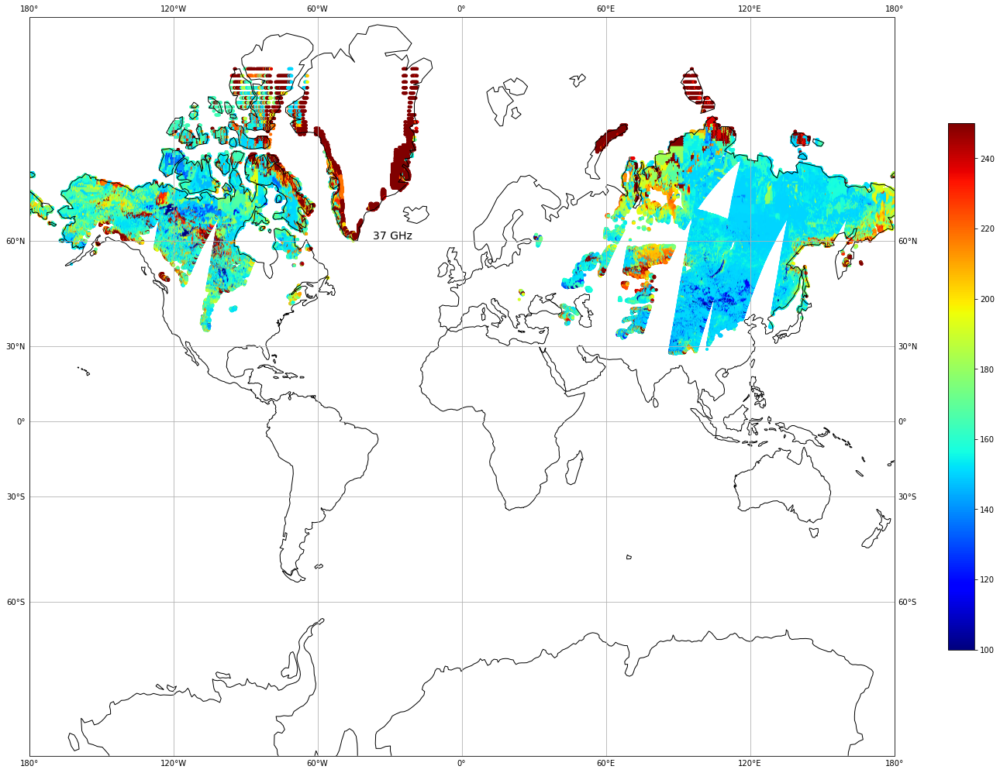

In [107]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

### 2019 as Train and 2020 as Test

#### Original Data

In [30]:
model = DecisionTreeRegressor(random_state=0) 

In [31]:
%%time
model.fit(X_train, y_train)

CPU times: total: 7min 27s
Wall time: 8min 18s


DecisionTreeRegressor(random_state=0)

In [32]:
model.score(X_train, y_train)

1.0

In [33]:
model.score(X_test, y_test)

0.39239225424506696

In [34]:
with open("Models\\DTR\\sd_dtr_model_org_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(model, file)

In [35]:
y_pred = model.predict(X_test)

In [36]:
mae = mean_absolute_error(y_test, y_pred)
mae

22.199754601185624

In [37]:
mse = mean_squared_error(y_test, y_pred)
mse

1232.0228819749088

In [38]:
rmse = mse**(1/2.0)
rmse

35.1001835034364

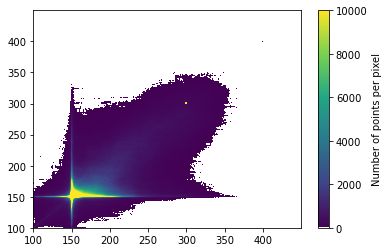

In [39]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [40]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [41]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [42]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [43]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN


In [125]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [126]:
y_sample_pred = model.predict(X_sample)

In [127]:
X_sample["snow_density"] = y_sample_pred

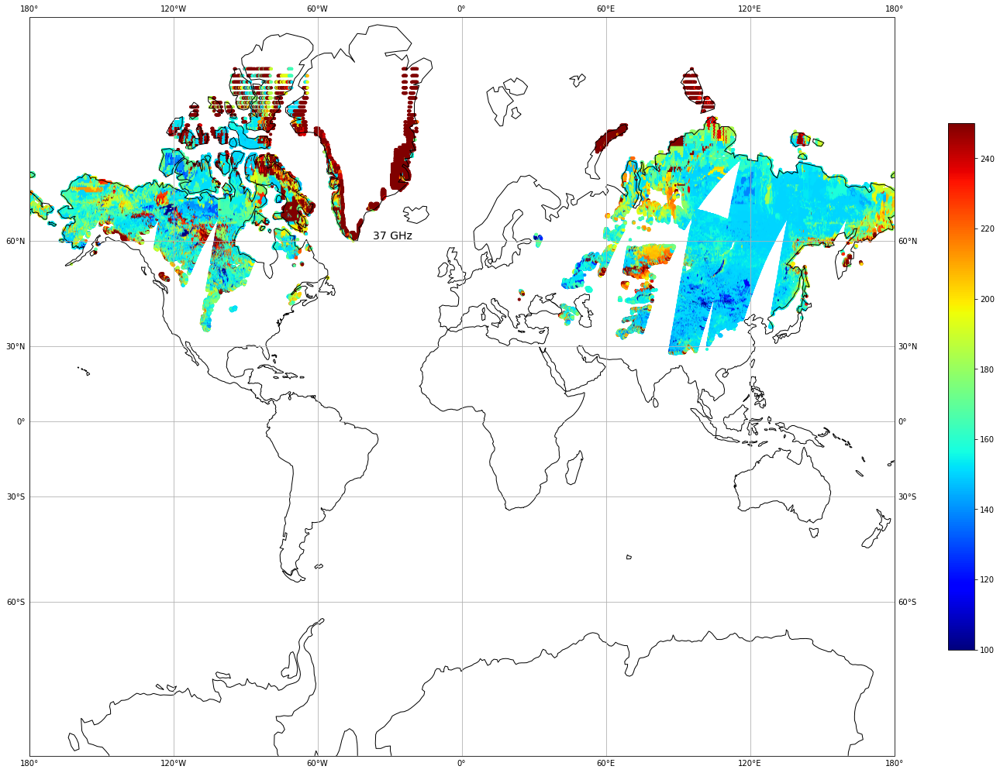

In [128]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

In [ ]:
import plotly.express as px
fig = px.density_mapbox(predict_sample, lat='lat', lon='lon', z='snow_density', radius=1, color_continuous_scale='Blues',
                        center=dict(lat=0, lon=180), zoom=0,
                        mapbox_style="open-street-map")
fig.show()

#### MinMax Scaled

In [105]:
model = DecisionTreeRegressor(random_state=0) 

In [106]:
%%time
model.fit(X_train, y_train)

CPU times: total: 7min 34s
Wall time: 8min 13s


DecisionTreeRegressor(random_state=0)

In [107]:
model.score(X_train, y_train)

1.0

In [108]:
model.score(X_test, y_test)

0.39298128417567324

In [109]:
with open("Models\\DTR\\sd_dtr_model_min_max_scaled_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(model, file)

In [110]:
y_pred = model.predict(X_test)

In [111]:
mae = mean_absolute_error(y_test, y_pred)
mae

22.19725054969715

In [112]:
mse = mean_squared_error(y_test, y_pred)
mse

1230.8285286149573

In [113]:
rmse = mse**(1/2.0)
rmse

35.08316588643273

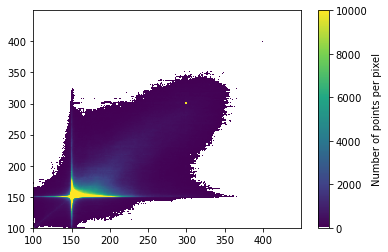

In [114]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [115]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [116]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [117]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [118]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN


In [119]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [120]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [121]:
y_sample_pred = model.predict(X_sample_scaled)

In [122]:
X_sample["snow_density"] = y_sample_pred

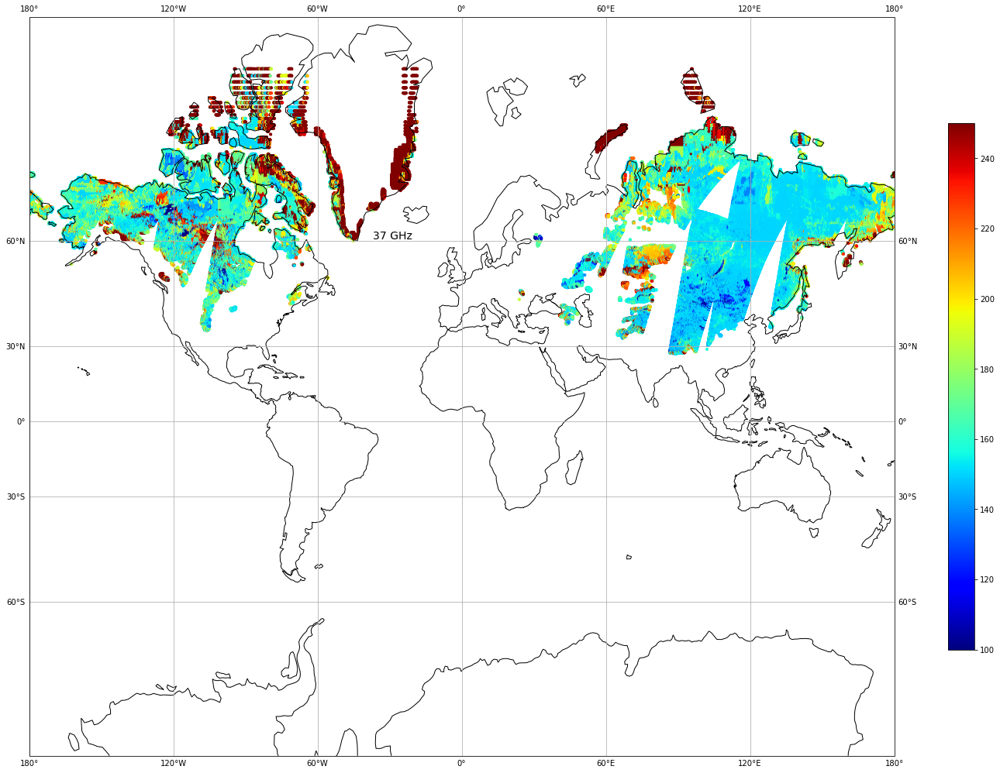

In [123]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

#### Robust Scaled

In [139]:
model = DecisionTreeRegressor(random_state=0) 

In [140]:
%%time
model.fit(X_train, y_train)

CPU times: total: 7min 46s
Wall time: 8min 18s


DecisionTreeRegressor(random_state=0)

In [141]:
model.score(X_train, y_train)

1.0

In [142]:
model.score(X_test, y_test)

0.3911185221405

In [143]:
with open("Models\\DTR\\sd_dtr_model_robust_scaled_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(model, file)

In [144]:
y_pred = model.predict(X_test)

In [145]:
mae = mean_absolute_error(y_test, y_pred)
mae

22.22118644631338

In [146]:
mse = mean_squared_error(y_test, y_pred)
mse

1234.6055796269652

In [147]:
rmse = mse**(1/2.0)
rmse

35.13695461514793

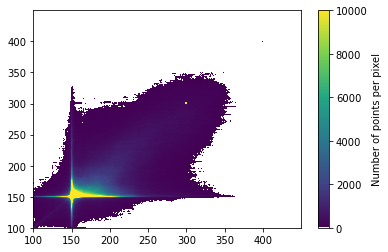

In [148]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [149]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [150]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [151]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [152]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN


In [153]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [154]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [155]:
y_sample_pred = model.predict(X_sample_scaled)

In [156]:
X_sample["snow_density"] = y_sample_pred

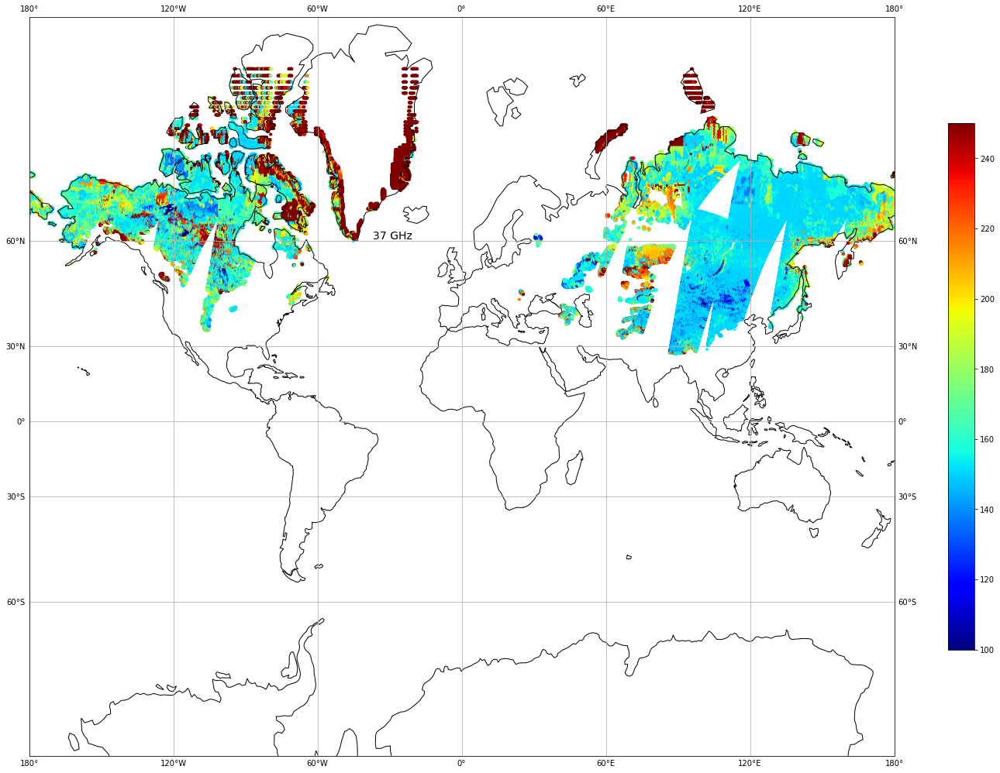

In [157]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

#### Standard Scaled

In [173]:
model = DecisionTreeRegressor(random_state=0) 

In [174]:
%%time
model.fit(X_train, y_train)

CPU times: total: 7min 42s
Wall time: 8min 18s


DecisionTreeRegressor(random_state=0)

In [175]:
model.score(X_train, y_train)

1.0

In [176]:
model.score(X_test, y_test)

0.3918055135140013

In [177]:
with open("Models\\DTR\\sd_dtr_model_standard_scaled_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(model, file)

In [178]:
y_pred = model.predict(X_test)

In [179]:
mae = mean_absolute_error(y_test, y_pred)
mae

22.208113321046508

In [180]:
mse = mean_squared_error(y_test, y_pred)
mse

1233.2125936129023

In [181]:
rmse = mse**(1/2.0)
rmse

35.11712678470296

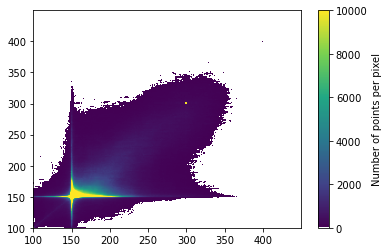

In [182]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [183]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [184]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [185]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [186]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN


In [187]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [188]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [189]:
y_sample_pred = model.predict(X_sample_scaled)

In [190]:
X_sample["snow_density"] = y_sample_pred

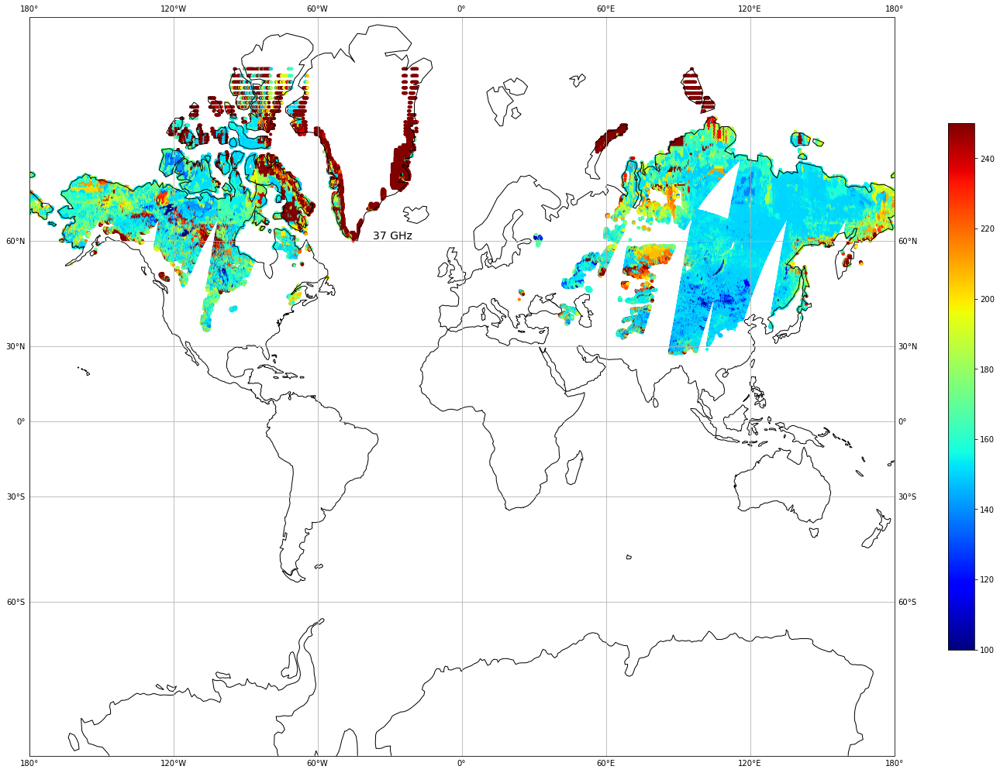

In [191]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

## Random Forest Regressor

### Hyperparameter Tuning

In [22]:
model_rf = RandomForestRegressor(random_state = 0)

In [23]:
print('Parameters currently in use:\n')
pprint(model_rf.get_params())

Parameters currently in use:

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'criterion': 'squared_error',
 'max_depth': None,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 100,
 'n_jobs': None,
 'oob_score': False,
 'random_state': 0,
 'verbose': 0,
 'warm_start': False}


#### Important parameters to focus on:
- n_estimators = number of trees in the foreset
- max_features = max number of features considered for splitting a node
- max_depth = max number of levels in each decision tree
- min_samples_split = min number of data points placed in a node before the node is split
- min_samples_leaf = min number of data points allowed in a leaf node
- bootstrap = method for sampling data points (with or without replacement)

In [24]:
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]

In [25]:
# Number of features to consider at every split
max_features = ['auto', 'sqrt']

In [26]:
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)

In [27]:
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]

In [28]:
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]

In [29]:
# Method of selecting samples for training each tree
bootstrap = [True, False]

In [30]:
# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}
pprint(random_grid)

{'bootstrap': [True, False],
 'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, None],
 'max_features': ['auto', 'sqrt'],
 'min_samples_leaf': [1, 2, 4],
 'min_samples_split': [2, 5, 10],
 'n_estimators': [200, 400, 600, 800, 1000, 1200, 1400, 1600, 1800, 2000]}


In [31]:
# Altogether, there are 2 * 12 * 2 * 3 * 3 * 10 = 4320 settings! 
# However, the benefit of a random search is that we are not trying every combination, but selecting at random to sample a wide range of values.

In [32]:
# Use the random grid to search for best hyperparameters
# First create the base model to tune
rf = RandomForestRegressor()

In [33]:
# Random search of parameters, using 3 fold cross validation, 
# search across 100 different combinations, and use all available cores
rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, n_iter = 100, cv = 3, verbose=10, random_state=0, n_jobs = -1)

In [20]:
new_X_train = X_train.sample(frac = 0.01)
new_y_train = y_train.sample(frac = 0.01)

In [21]:
new_X_train.shape

(122808, 9)

In [22]:
new_y_train.shape

(122808,)

In [37]:
# Fit the random search model
rf_random.fit(new_X_train, new_y_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits


RandomizedSearchCV(cv=3, estimator=RandomForestRegressor(), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [10, 20, 30, 40, 50, 60,
                                                      70, 80, 90, 100, 110,
                                                      None],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [200, 400, 600, 800,
                                                         1000, 1200, 1400, 1600,
                                                         1800, 2000]},
                   random_state=0, verbose=10)

In [38]:
# List of best params found
rf_random.best_params_

{'n_estimators': 1200,
 'min_samples_split': 2,
 'min_samples_leaf': 2,
 'max_features': 'sqrt',
 'max_depth': 10,
 'bootstrap': True}

In [20]:
tuned_model = RandomForestRegressor(n_estimators = 1200, 
                                    min_samples_split = 2,
                                    min_samples_leaf = 2,
                                    max_features = 'sqrt',
                                    max_depth = 10,
                                    bootstrap = True,
                                    random_state = 0)

In [21]:
tuned_model.fit(X_train, y_train)

RandomForestRegressor(max_depth=10, max_features='sqrt', min_samples_leaf=2,
                      n_estimators=1200, random_state=0)

In [22]:
tuned_model.score(X_train, y_train)

0.6855531687864809

In [23]:
tuned_model.score(X_test, y_test)

0.6845460984099415

In [34]:
y_pred = tuned_model.predict(X_test)

In [35]:
mae = mean_absolute_error(y_test, y_pred)

In [36]:
mae

15.186355440094673

In [37]:
mse = mean_squared_error(y_test, y_pred)

In [38]:
mse

564.6126230774038

In [39]:
rmse = mse**(1/2.0)
rmse

23.761578716015563

In [41]:
%store tuned_model

Stored 'tuned_model' (RandomForestRegressor)


In [148]:
with open("Models\\RFR\\sd_rfr_tuned_model_2019_test_train_split_66_33.pkl", 'wb') as file:
    pickle.dump(tuned_model, file)

### 2019 as Train/Test

In [176]:
base_model = RandomForestRegressor(n_estimators=10, random_state=0)

In [177]:
%%time
base_model.fit(X_train, y_train)

CPU times: total: 43min 33s
Wall time: 48min 15s


RandomForestRegressor(n_estimators=10, random_state=0)

In [178]:
base_model.score(X_train, y_train)

0.9875780451746382

In [179]:
base_model.score(X_test, y_test)

0.9347493826874411

In [180]:
y_pred = base_model.predict(X_test)

In [181]:
mae = mean_absolute_error(y_test, y_pred)
mae

5.173853516409201

In [182]:
mse = mean_squared_error(y_test, y_pred)
mse

116.95251492529947

In [183]:
rmse = mse**(1/2.0)
rmse

10.814458605279299

In [184]:
with open("Models\\RFR\\sd_rfr_base_model_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(base_model, file)

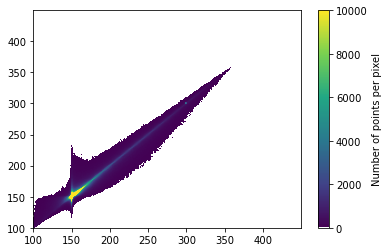

In [185]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [186]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [187]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [188]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [189]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN


In [190]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [191]:
y_sample_pred = base_model.predict(X_sample)

In [192]:
X_sample["snow_density"] = y_sample_pred

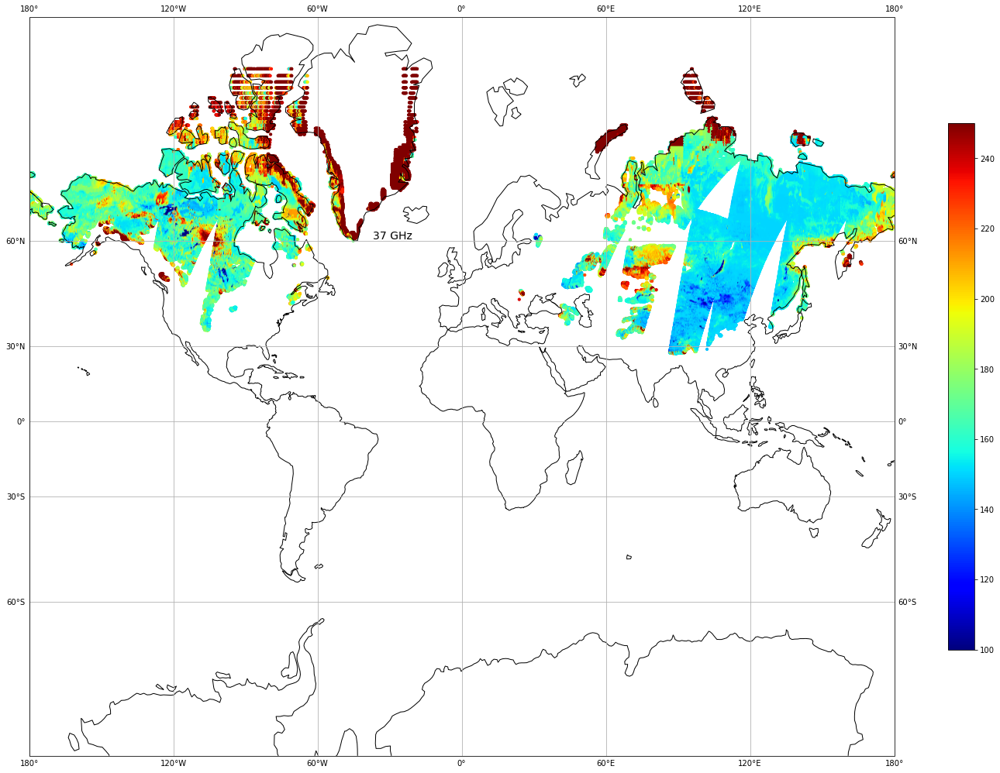

In [193]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

### 2019 as Train and 2020 as Test

In [203]:
base_model_2019_train = RandomForestRegressor(n_estimators=10, random_state=0)

In [204]:
%%time
base_model_2019_train.fit(X_train, y_train)

CPU times: total: 48min 50s
Wall time: 53min 13s


RandomForestRegressor(n_estimators=10, random_state=0)

In [205]:
base_model_2019_train.score(X_train, y_train)

0.9887083137646245

In [206]:
base_model_2019_train.score(X_test, y_test)

0.53075563948599

In [207]:
y_pred = base_model_2019_train.predict(X_test)

In [208]:
mae = mean_absolute_error(y_test, y_pred)
mae

19.777903006471693

In [209]:
mse = mean_squared_error(y_test, y_pred)
mse

951.4687615982388

In [210]:
rmse = mse**(1/2.0)
rmse

30.845887272021187

In [211]:
with open("Models\\RFR\\sd_rfr_base_model_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(base_model_2019_train, file)

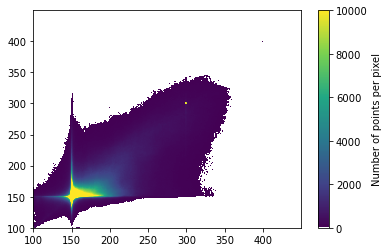

In [212]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [213]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [214]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [215]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [216]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN


In [217]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [218]:
y_sample_pred = base_model_2019_train.predict(X_sample)

In [219]:
X_sample["snow_density"] = y_sample_pred

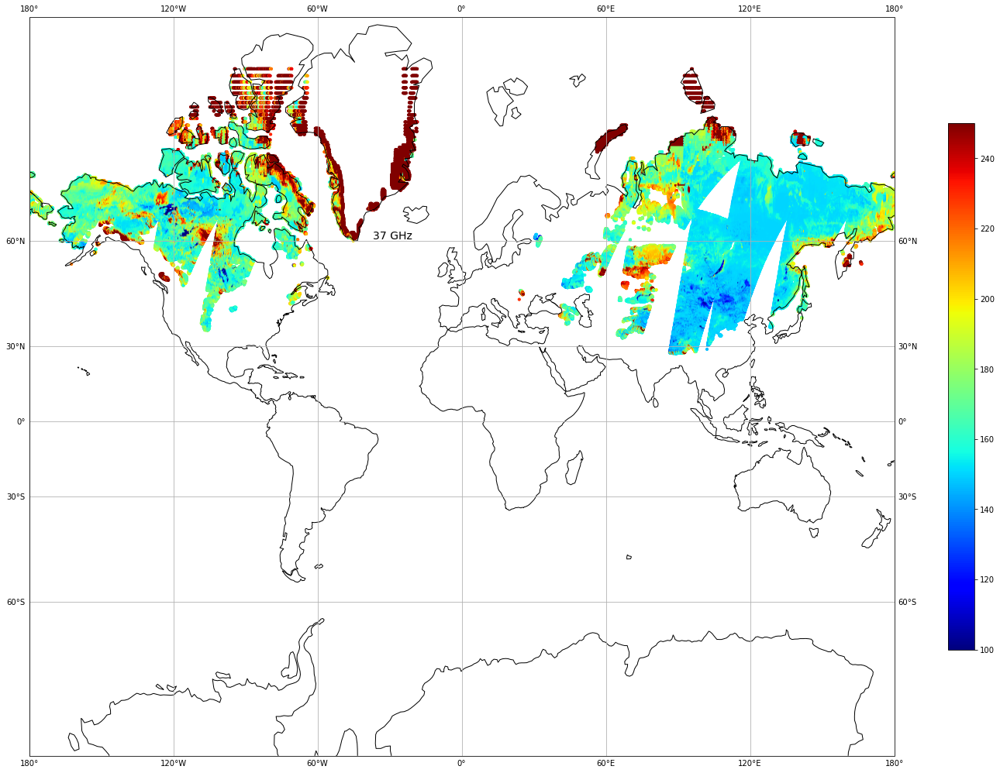

In [220]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

# VOD

## Dataset Split

#### Random Test Train Split on only 2019

In [9]:
df1 = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [10]:
X = df1[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y = df1['vod']

In [11]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, shuffle=True, random_state=0)

#### Train 2019, Test 2020

In [483]:
train = pd.read_csv(os.path.join(dir_path, "train.csv"))

In [32]:
train = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [33]:
train.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,268.206835,273.037231,0.077934,250.853485,255.755310,0.167626,1.250319,0.959070,62.684110,-160.44087,01_01_2019,0.360216
1,161.904102,270.752674,272.944916,0.078347,252.357315,255.754684,0.170824,1.239644,0.973190,62.532246,-160.44087,01_01_2019,0.343348
2,163.183896,270.971431,272.960205,0.079091,254.316711,257.457397,0.176738,1.237796,0.997815,62.381150,-160.44087,01_01_2019,0.363338
3,164.070027,271.314168,272.987762,0.079008,254.165604,258.057922,0.165714,1.237237,0.981988,62.230810,-160.44087,01_01_2019,0.360973
4,158.706063,269.161864,272.945801,0.079000,250.542023,254.916229,0.166220,1.237293,0.953300,62.684110,-160.34750,01_01_2019,0.359798


In [34]:
X_train = train[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y_train = train['vod']

In [485]:
test = pd.read_csv(os.path.join(dir_path, "test.csv"))

In [35]:
test = df[df["date"].apply(lambda x: x.split('_')[2] == '2020')]

In [36]:
test.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,0.797174,62.230810,-162.77490,01_01_2020,0.136579
18329588,176.776952,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,0.845337,62.081207,-162.77490,01_01_2020,0.371299
18329589,181.312867,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,0.873384,62.230810,-162.49481,01_01_2020,1.187509
18329590,183.489251,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,0.842133,62.381150,-162.40146,01_01_2020,0.367274
18329591,182.247955,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,0.940199,61.932335,-162.21474,01_01_2020,0.243427


In [37]:
X_test = test[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y_test = test['vod']

## Trying Scaling Techniques

#### MinMax

In [295]:
scaler = MinMaxScaler() 

#### Take 2019 and do train, val and test split

In [197]:
df1 = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [198]:
df1.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,268.206835,273.037231,0.077934,250.853485,255.755310,0.167626,1.250319,0.959070,62.684110,-160.44087,01_01_2019,0.360216
1,161.904102,270.752674,272.944916,0.078347,252.357315,255.754684,0.170824,1.239644,0.973190,62.532246,-160.44087,01_01_2019,0.343348
2,163.183896,270.971431,272.960205,0.079091,254.316711,257.457397,0.176738,1.237796,0.997815,62.381150,-160.44087,01_01_2019,0.363338
3,164.070027,271.314168,272.987762,0.079008,254.165604,258.057922,0.165714,1.237237,0.981988,62.230810,-160.44087,01_01_2019,0.360973
4,158.706063,269.161864,272.945801,0.079000,250.542023,254.916229,0.166220,1.237293,0.953300,62.684110,-160.34750,01_01_2019,0.359798


In [199]:
X = df1[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y = df1['vod']

In [200]:
X_scaled = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)

In [201]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.20, shuffle=True, random_state=0)

In [202]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
17720940,0.781561,0.941262,0.709649,0.723646,0.716712,0.285109,0.034816,0.843425,0.171725,0.571699
11233780,0.907268,0.945543,0.728440,0.722316,0.727172,0.219747,0.116229,0.846516,0.121920,0.428076
2485422,0.823962,0.849550,0.700000,0.639282,0.631964,0.307740,0.339076,0.760573,0.242283,0.640580
1154291,0.518025,0.803122,0.700000,0.711224,0.705540,0.340568,0.082276,0.800952,0.869780,0.404503
6723943,0.641780,0.902755,0.710169,0.681389,0.673606,0.397789,0.025987,0.814403,0.215305,0.602589


In [203]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
8175713,0.689661,0.898243,0.700000,0.719632,0.716880,0.315937,0.106072,0.832409,0.873930,0.449685
18055958,0.750584,0.919998,0.708403,0.691154,0.690761,0.359609,0.011335,0.832409,0.194812,0.551537
4853484,0.627939,0.984761,0.779338,0.717008,0.719574,0.451925,0.040825,0.773244,0.262776,0.542885
16883108,0.460363,0.940657,0.701653,0.738804,0.722278,0.320924,0.108938,0.819029,0.847211,0.465421
44884,0.696316,0.804377,0.000000,0.640849,0.696834,0.092715,0.032792,0.708750,0.750195,0.823778


#### Take whole of 2019 as train and whole 2020 as test

In [296]:
df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']] = scaler.fit_transform(df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']])


In [297]:
df.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,0.908916,0.998302,0.779338,0.710750,0.708752,0.305672,0.124832,0.408674,0.863969,0.054215,01_01_2019,0.360216
1,161.904102,0.955726,0.995804,0.783470,0.715650,0.708749,0.311526,0.123756,0.421018,0.862857,0.054215,01_01_2019,0.343348
2,163.183896,0.959748,0.996218,0.790908,0.722035,0.714708,0.322348,0.123569,0.442547,0.861749,0.054215,01_01_2019,0.363338
3,164.070027,0.966050,0.996963,0.790081,0.721543,0.716810,0.302173,0.123513,0.428711,0.860648,0.054215,01_01_2019,0.360973
4,158.706063,0.926476,0.995828,0.789999,0.709735,0.705815,0.303099,0.123518,0.403630,0.863969,0.054475,01_01_2019,0.359798


In [298]:
train = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [299]:
train.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,0.908916,0.998302,0.779338,0.710750,0.708752,0.305672,0.124832,0.408674,0.863969,0.054215,01_01_2019,0.360216
1,161.904102,0.955726,0.995804,0.783470,0.715650,0.708749,0.311526,0.123756,0.421018,0.862857,0.054215,01_01_2019,0.343348
2,163.183896,0.959748,0.996218,0.790908,0.722035,0.714708,0.322348,0.123569,0.442547,0.861749,0.054215,01_01_2019,0.363338
3,164.070027,0.966050,0.996963,0.790081,0.721543,0.716810,0.302173,0.123513,0.428711,0.860648,0.054215,01_01_2019,0.360973
4,158.706063,0.926476,0.995828,0.789999,0.709735,0.705815,0.303099,0.123518,0.403630,0.863969,0.054475,01_01_2019,0.359798


In [300]:
X_train = train[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y_train = train['vod']

In [301]:
test = df[df["date"].apply(lambda x: x.split('_')[2] == '2020')]

In [302]:
test.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,0.605666,0.979289,0.725619,0.710505,0.715126,0.305186,0.113270,0.267135,0.860648,0.047730,01_01_2020,0.136579
18329588,176.776952,0.608976,0.971580,0.746666,0.701298,0.703409,0.334429,0.104657,0.309242,0.859552,0.047730,01_01_2020,0.371299
18329589,181.312867,0.594961,0.918358,0.745378,0.709829,0.718960,0.299206,0.105855,0.333763,0.860648,0.048508,01_01_2020,1.187509
18329590,183.489251,0.589092,0.946560,0.737288,0.713899,0.722697,0.275514,0.112478,0.306441,0.861749,0.048768,01_01_2020,0.367274
18329591,182.247955,0.567396,0.862735,0.745613,0.695790,0.703448,0.363539,0.096604,0.392176,0.858461,0.049287,01_01_2020,0.243427


In [303]:
X_test = test[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y_test = test['vod']

In [304]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
0,0.908916,0.998302,0.779338,0.710750,0.708752,0.305672,0.124832,0.863969,0.054215,0.408674
1,0.955726,0.995804,0.783470,0.715650,0.708749,0.311526,0.123756,0.862857,0.054215,0.421018
2,0.959748,0.996218,0.790908,0.722035,0.714708,0.322348,0.123569,0.861749,0.054215,0.442547
3,0.966050,0.996963,0.790081,0.721543,0.716810,0.302173,0.123513,0.860648,0.054215,0.428711
4,0.926476,0.995828,0.789999,0.709735,0.705815,0.303099,0.123518,0.863969,0.054475,0.403630


In [305]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
18329587,0.605666,0.979289,0.725619,0.710505,0.715126,0.305186,0.113270,0.860648,0.047730,0.267135
18329588,0.608976,0.971580,0.746666,0.701298,0.703409,0.334429,0.104657,0.859552,0.047730,0.309242
18329589,0.594961,0.918358,0.745378,0.709829,0.718960,0.299206,0.105855,0.860648,0.048508,0.333763
18329590,0.589092,0.946560,0.737288,0.713899,0.722697,0.275514,0.112478,0.861749,0.048768,0.306441
18329591,0.567396,0.862735,0.745613,0.695790,0.703448,0.363539,0.096604,0.858461,0.049287,0.392176


<AxesSubplot:>

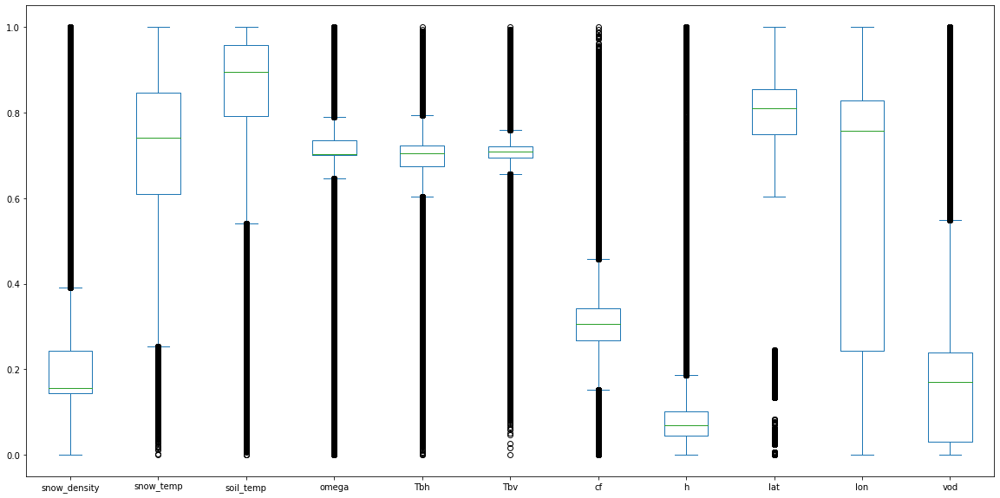

In [224]:
df_minmax_scaled.plot(kind='box', figsize=(20, 10))

#### Robust

In [342]:
scaler = RobustScaler()

#### Take 2019 and do train, val and test split

In [234]:
df1 = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [235]:
df1.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,268.206835,273.037231,0.077934,250.853485,255.755310,0.167626,1.250319,0.959070,62.684110,-160.44087,01_01_2019,0.360216
1,161.904102,270.752674,272.944916,0.078347,252.357315,255.754684,0.170824,1.239644,0.973190,62.532246,-160.44087,01_01_2019,0.343348
2,163.183896,270.971431,272.960205,0.079091,254.316711,257.457397,0.176738,1.237796,0.997815,62.381150,-160.44087,01_01_2019,0.363338
3,164.070027,271.314168,272.987762,0.079008,254.165604,258.057922,0.165714,1.237237,0.981988,62.230810,-160.44087,01_01_2019,0.360973
4,158.706063,269.161864,272.945801,0.079000,250.542023,254.916229,0.166220,1.237293,0.953300,62.684110,-160.34750,01_01_2019,0.359798


In [236]:
X = df1[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y = df1['vod']

In [237]:
X_scaled = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)

In [238]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.20, shuffle=True, random_state=0)

In [239]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
17720940,0.168703,0.280450,0.201532,0.392603,0.280260,-0.281963,-0.599797,0.317071,-1.003107,0.451021
11233780,0.699074,0.306066,0.729715,0.364715,0.686521,-1.139818,0.829793,0.346261,-1.088327,-0.254425
2485422,0.347599,-0.268204,-0.069685,-1.375717,-3.011007,0.015067,4.742910,-0.465382,-0.882379,0.789349
1154291,-0.943187,-0.545952,-0.069685,0.132225,-0.153606,0.445917,0.233576,-0.084040,0.191300,-0.370214
6723943,-0.421051,0.050091,0.216156,-0.493120,-1.393788,1.196928,-0.754831,0.042989,-0.928540,0.602746


In [240]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
8175713,-0.219035,0.023098,-0.069685,0.308464,0.286795,0.122641,0.651433,0.213038,0.198402,-0.148287
18055958,0.038006,0.153244,0.166517,-0.288456,-0.727570,0.695827,-1.012120,0.213038,-0.963604,0.351990
4853484,-0.479448,0.540678,2.160358,0.253457,0.391435,1.907455,-0.494292,-0.345722,-0.847315,0.309492
16883108,-1.186469,0.276833,-0.023229,0.710317,0.496428,0.188098,0.701761,0.086672,0.152685,-0.070997
44884,-0.190955,-0.538445,-19.745311,-1.342862,-0.491714,-2.807078,-0.635349,-0.954799,-0.013316,1.689184


#### Take whole of 2019 as train and whole 2020 as test

In [343]:
df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']] = scaler.fit_transform(df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']])


In [344]:
df.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,0.716902,0.632292,2.066673,0.093482,-0.103660,-0.018768,0.948204,-0.357570,0.493368,-1.173027,01_01_2019,0.360216
1,161.904102,0.924634,0.613351,2.177784,0.199158,-0.103748,0.059500,0.929132,-0.293506,0.482420,-1.173027,01_01_2019,0.343348
2,163.183896,0.942483,0.616488,2.377786,0.336847,0.135919,0.204211,0.925830,-0.181778,0.471527,-1.173027,01_01_2019,0.363338
3,164.070027,0.970449,0.622142,2.355562,0.326229,0.220447,-0.065557,0.924831,-0.253585,0.460689,-1.173027,01_01_2019,0.360973
4,158.706063,0.794829,0.613533,2.353343,0.071595,-0.221765,-0.053179,0.924931,-0.383749,0.493368,-1.172593,01_01_2019,0.359798


In [345]:
train = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [346]:
train.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,0.716902,0.632292,2.066673,0.093482,-0.103660,-0.018768,0.948204,-0.357570,0.493368,-1.173027,01_01_2019,0.360216
1,161.904102,0.924634,0.613351,2.177784,0.199158,-0.103748,0.059500,0.929132,-0.293506,0.482420,-1.173027,01_01_2019,0.343348
2,163.183896,0.942483,0.616488,2.377786,0.336847,0.135919,0.204211,0.925830,-0.181778,0.471527,-1.173027,01_01_2019,0.363338
3,164.070027,0.970449,0.622142,2.355562,0.326229,0.220447,-0.065557,0.924831,-0.253585,0.460689,-1.173027,01_01_2019,0.360973
4,158.706063,0.794829,0.613533,2.353343,0.071595,-0.221765,-0.053179,0.924931,-0.383749,0.493368,-1.172593,01_01_2019,0.359798


In [347]:
X_train = train[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y_train = train['vod']

In [348]:
test = df[df["date"].apply(lambda x: x.split('_')[2] == '2020')]

In [349]:
test.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,-0.628844,0.488143,0.622224,0.088194,0.152715,-0.025272,0.743431,-1.092131,0.460689,-1.183868,01_01_2020,0.136579
18329588,176.776952,-0.614156,0.429693,1.188158,-0.110352,-0.318561,0.365746,0.590880,-0.873605,0.449904,-1.183868,01_01_2020,0.371299
18329589,181.312867,-0.676350,0.026179,1.153509,0.073632,0.306933,-0.105226,0.612101,-0.746346,0.460689,-1.182567,01_01_2020,1.187509
18329590,183.489251,-0.702396,0.239998,0.935977,0.161392,0.457242,-0.422027,0.729401,-0.888140,0.471527,-1.182134,01_01_2020,0.367274
18329591,182.247955,-0.798676,-0.395543,1.159850,-0.229139,-0.316959,0.754991,0.448262,-0.443193,0.439172,-1.181266,01_01_2020,0.243427


In [350]:
X_test = test[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y_test = test['vod']

In [351]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
0,0.716902,0.632292,2.066673,0.093482,-0.103660,-0.018768,0.948204,0.493368,-1.173027,-0.357570
1,0.924634,0.613351,2.177784,0.199158,-0.103748,0.059500,0.929132,0.482420,-1.173027,-0.293506
2,0.942483,0.616488,2.377786,0.336847,0.135919,0.204211,0.925830,0.471527,-1.173027,-0.181778
3,0.970449,0.622142,2.355562,0.326229,0.220447,-0.065557,0.924831,0.460689,-1.173027,-0.253585
4,0.794829,0.613533,2.353343,0.071595,-0.221765,-0.053179,0.924931,0.493368,-1.172593,-0.383749


In [352]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
18329587,-0.628844,0.488143,0.622224,0.088194,0.152715,-0.025272,0.743431,0.460689,-1.183868,-1.092131
18329588,-0.614156,0.429693,1.188158,-0.110352,-0.318561,0.365746,0.590880,0.449904,-1.183868,-0.873605
18329589,-0.676350,0.026179,1.153509,0.073632,0.306933,-0.105226,0.612101,0.460689,-1.182567,-0.746346
18329590,-0.702396,0.239998,0.935977,0.161392,0.457242,-0.422027,0.729401,0.471527,-1.182134,-0.888140
18329591,-0.798676,-0.395543,1.159850,-0.229139,-0.316959,0.754991,0.448262,0.439172,-1.181266,-0.443193


<AxesSubplot:>

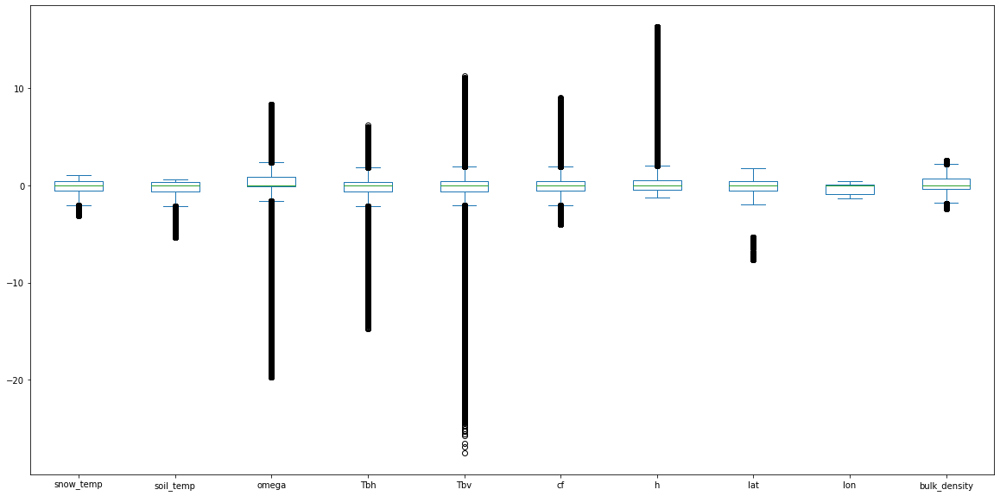

In [150]:
X_train_scaled.plot(kind='box', figsize=(20, 10))

#### Standard

In [11]:
scaler = StandardScaler() 

#### Take 2019 and do train, val and test split

In [265]:
df1 = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [266]:
df1.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,268.206835,273.037231,0.077934,250.853485,255.755310,0.167626,1.250319,0.959070,62.684110,-160.44087,01_01_2019,0.360216
1,161.904102,270.752674,272.944916,0.078347,252.357315,255.754684,0.170824,1.239644,0.973190,62.532246,-160.44087,01_01_2019,0.343348
2,163.183896,270.971431,272.960205,0.079091,254.316711,257.457397,0.176738,1.237796,0.997815,62.381150,-160.44087,01_01_2019,0.363338
3,164.070027,271.314168,272.987762,0.079008,254.165604,258.057922,0.165714,1.237237,0.981988,62.230810,-160.44087,01_01_2019,0.360973
4,158.706063,269.161864,272.945801,0.079000,250.542023,254.916229,0.166220,1.237293,0.953300,62.684110,-160.34750,01_01_2019,0.359798


In [267]:
X = df1[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y = df1['vod']

In [268]:
X_scaled = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)

In [269]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.20, shuffle=True, random_state=0)

In [270]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
17720940,0.365254,0.645153,0.241296,0.668387,0.397419,-0.251514,-0.865250,0.583841,-1.499111,0.341554
11233780,1.116670,0.677221,0.330183,0.636686,0.714745,-1.011708,0.828445,0.623352,-1.671083,-0.637564
2485422,0.618709,-0.041689,0.195653,-1.341671,-2.173358,0.011701,5.464479,-0.475251,-1.255484,0.811133
1154291,-1.210042,-0.389393,0.195653,0.372415,0.058530,0.393502,0.122082,0.040915,0.911184,-0.798271
6723943,-0.470293,0.356774,0.243757,-0.338419,-0.910164,1.059015,-1.048926,0.212856,-1.348636,0.552140


In [271]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
8175713,-0.184082,0.322982,0.195653,0.572746,0.402523,0.107029,0.617134,0.443027,0.925515,-0.490250
18055958,0.180086,0.485908,0.235403,-0.105776,-0.389788,0.614961,-1.353746,0.443027,-1.419395,0.204105
4853484,-0.553029,0.970923,0.570943,0.510220,0.484256,1.688652,-0.740254,-0.313284,-1.184725,0.145121
16883108,-1.554717,0.640625,0.203471,1.029535,0.566266,0.165033,0.676760,0.271984,0.833259,-0.382975
44884,-0.144300,-0.379995,-3.115520,-1.304325,-0.205562,-2.489160,-0.907370,-1.137702,0.498272,2.060052


#### Take whole of 2019 as train and whole 2020 as test

In [12]:
df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']] = scaler.fit_transform(df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']])


In [13]:
df.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,1.113262,1.073475,0.569779,0.327774,0.103444,-0.025829,0.983535,-0.759116,0.789650,-1.796875,01_01_2019,0.360216
1,161.904102,1.400972,1.050109,0.589497,0.446137,0.103376,0.042764,0.960934,-0.672687,0.775604,-1.796875,01_01_2019,0.343348
2,163.183896,1.425694,1.053979,0.624992,0.600355,0.287561,0.169587,0.957021,-0.521954,0.761629,-1.796875,01_01_2019,0.363338
3,164.070027,1.464427,1.060954,0.621048,0.588462,0.352520,-0.066834,0.955837,-0.618830,0.747724,-1.796875,01_01_2019,0.360973
4,158.706063,1.221191,1.050333,0.620654,0.303260,0.012680,-0.055986,0.955955,-0.794435,0.789650,-1.796006,01_01_2019,0.359798


In [14]:
train = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [15]:
train.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,1.113262,1.073475,0.569779,0.327774,0.103444,-0.025829,0.983535,-0.759116,0.789650,-1.796875,01_01_2019,0.360216
1,161.904102,1.400972,1.050109,0.589497,0.446137,0.103376,0.042764,0.960934,-0.672687,0.775604,-1.796875,01_01_2019,0.343348
2,163.183896,1.425694,1.053979,0.624992,0.600355,0.287561,0.169587,0.957021,-0.521954,0.761629,-1.796875,01_01_2019,0.363338
3,164.070027,1.464427,1.060954,0.621048,0.588462,0.352520,-0.066834,0.955837,-0.618830,0.747724,-1.796875,01_01_2019,0.360973
4,158.706063,1.221191,1.050333,0.620654,0.303260,0.012680,-0.055986,0.955955,-0.794435,0.789650,-1.796006,01_01_2019,0.359798


In [16]:
X_train = train[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y_train = train['vod']

In [17]:
test = df[df["date"].apply(lambda x: x.split('_')[2] == '2020')]

In [18]:
test.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,-0.750608,0.895647,0.313434,0.321851,0.300468,-0.031529,0.740869,-1.750119,0.747724,-1.818588,01_01_2020,0.136579
18329588,176.776952,-0.730265,0.823541,0.413870,0.099469,-0.061708,0.311154,0.560089,-1.455303,0.733888,-1.818588,01_01_2020,0.371299
18329589,181.312867,-0.816404,0.325752,0.407721,0.305540,0.418985,-0.101600,0.585237,-1.283617,0.747724,-1.815982,01_01_2020,1.187509
18329590,183.489251,-0.852478,0.589527,0.369116,0.403837,0.534498,-0.379240,0.724243,-1.474913,0.761629,-1.815114,01_01_2020,0.367274
18329591,182.247955,-0.985826,-0.194500,0.408846,-0.033579,-0.060477,0.652284,0.391080,-0.874631,0.720118,-1.813377,01_01_2020,0.243427


In [19]:
X_test = test[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]
y_test = test['vod']

In [20]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
0,1.113262,1.073475,0.569779,0.327774,0.103444,-0.025829,0.983535,0.789650,-1.796875,-0.759116
1,1.400972,1.050109,0.589497,0.446137,0.103376,0.042764,0.960934,0.775604,-1.796875,-0.672687
2,1.425694,1.053979,0.624992,0.600355,0.287561,0.169587,0.957021,0.761629,-1.796875,-0.521954
3,1.464427,1.060954,0.621048,0.588462,0.352520,-0.066834,0.955837,0.747724,-1.796875,-0.618830
4,1.221191,1.050333,0.620654,0.303260,0.012680,-0.055986,0.955955,0.789650,-1.796006,-0.794435


In [21]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
18329587,-0.750608,0.895647,0.313434,0.321851,0.300468,-0.031529,0.740869,0.747724,-1.818588,-1.750119
18329588,-0.730265,0.823541,0.413870,0.099469,-0.061708,0.311154,0.560089,0.733888,-1.818588,-1.455303
18329589,-0.816404,0.325752,0.407721,0.305540,0.418985,-0.101600,0.585237,0.747724,-1.815982,-1.283617
18329590,-0.852478,0.589527,0.369116,0.403837,0.534498,-0.379240,0.724243,0.761629,-1.815114,-1.474913
18329591,-0.985826,-0.194500,0.408846,-0.033579,-0.060477,0.652284,0.391080,0.720118,-1.813377,-0.874631


<AxesSubplot:>

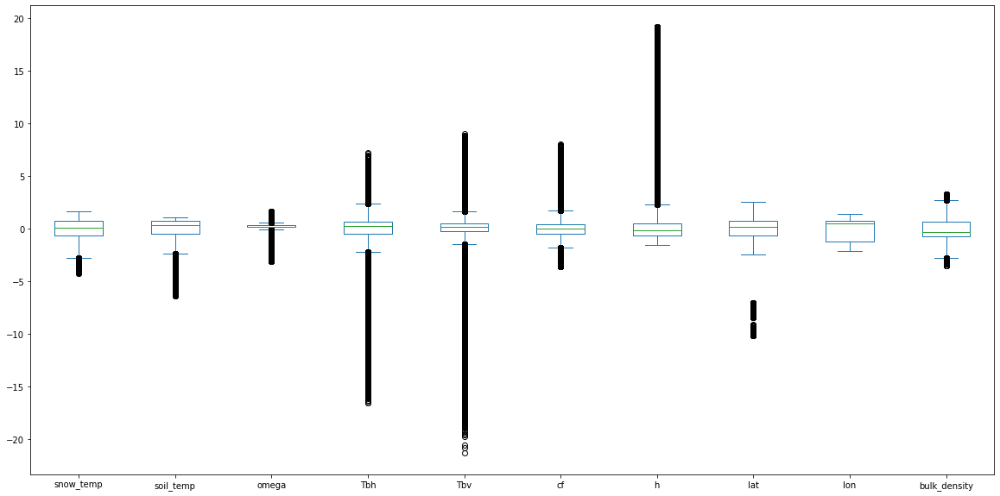

In [296]:
X_train_scaled.plot(kind='box', figsize=(20, 10))

## Actual Data Projection

In [226]:
org = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

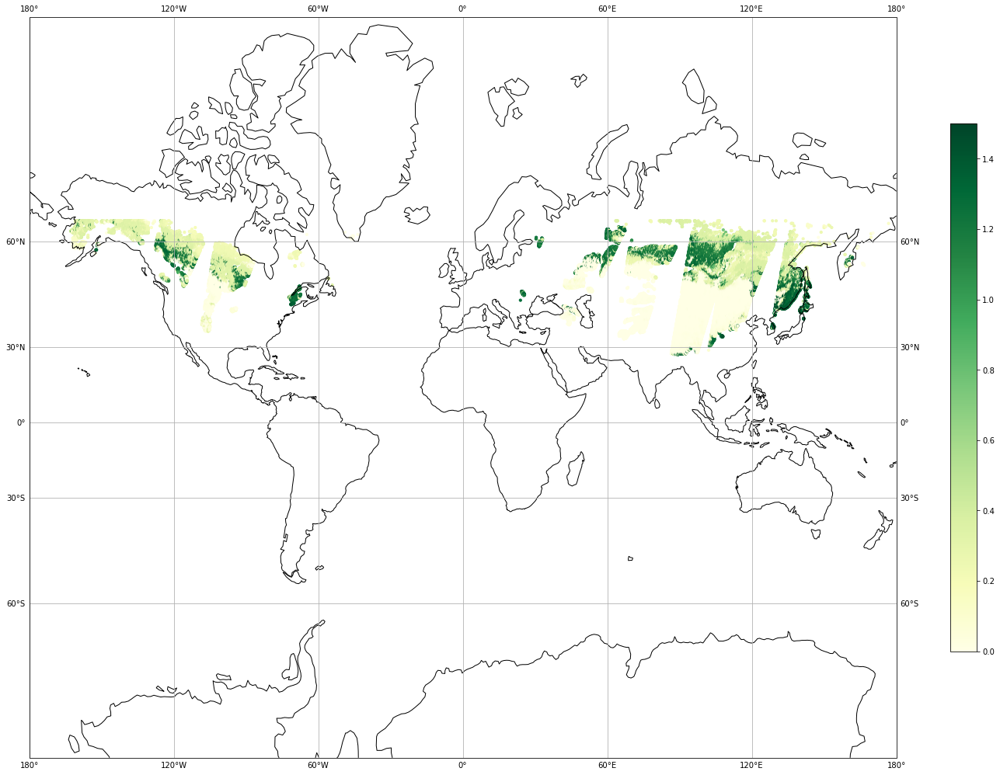

In [227]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(org["lon"], org["lat"], c=org["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

# Model Training

## Decision Tree Regressor

### 2019 as Train/Test

#### Original Data

In [324]:
model = DecisionTreeRegressor(random_state=0) 

In [325]:
%%time
model.fit(X_train, y_train)

CPU times: total: 5min 55s
Wall time: 6min 21s


DecisionTreeRegressor(random_state=0)

In [326]:
model.score(X_train, y_train)

1.0

In [327]:
model.score(X_test, y_test)

0.9947707581807752

In [235]:
with open("Models\\DTR\\vod_dtr_model_org_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(model, file)

In [328]:
y_pred = model.predict(X_test)

In [329]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.0032242228075109788

In [330]:
mse = mean_squared_error(y_test, y_pred)
mse

0.0008571171594390527

In [331]:
rmse = mse**(1/2.0)
rmse

0.029276563313323727

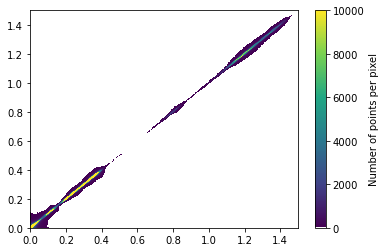

In [332]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [350]:
sample = df[df["date"] == '01_01_2020']

In [351]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,0.797174,62.230810,-162.77490,01_01_2020,0.136579
18329588,176.776952,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,0.845337,62.081207,-162.77490,01_01_2020,0.371299
18329589,181.312867,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,0.873384,62.230810,-162.49481,01_01_2020,1.187509
18329590,183.489251,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,0.842133,62.381150,-162.40146,01_01_2020,0.367274
18329591,182.247955,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,0.940199,61.932335,-162.21474,01_01_2020,0.243427


In [352]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [353]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
18329587,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,62.230810,-162.77490,0.797174
18329588,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,62.081207,-162.77490,0.845337
18329589,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,62.230810,-162.49481,0.873384
18329590,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,62.381150,-162.40146,0.842133
18329591,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,61.932335,-162.21474,0.940199


In [354]:
y_sample_pred = model.predict(X_sample)

In [355]:
y_sample_pred

array([0.14080018, 0.37984227, 1.20518452, ..., 0.12653071, 0.12413857,
       0.12332729])

In [356]:
X_sample["vod"] = y_sample_pred

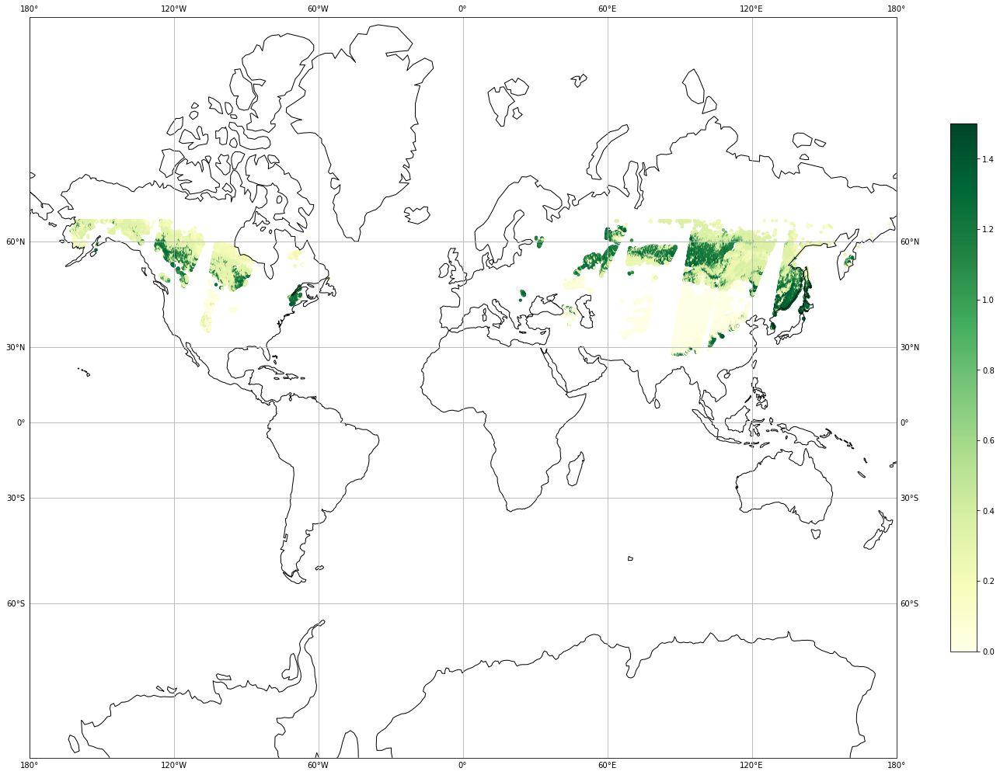

In [357]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

In [ ]:
import plotly.express as px
fig = px.density_mapbox(X_sample, lat='lat', lon='lon', z='vod', radius=1, color_continuous_scale='YlGn',
                        center=dict(lat=0, lon=180), zoom=0,
                        mapbox_style="open-street-map")
fig.show()

#### MinMax Scaled

In [210]:
model = DecisionTreeRegressor(random_state=0) 

In [211]:
%%time
model.fit(X_train, y_train)

CPU times: total: 5min 32s
Wall time: 5min 59s


DecisionTreeRegressor(random_state=0)

In [212]:
model.score(X_train, y_train)

1.0

In [213]:
model.score(X_test, y_test)

0.9931934516370792

In [214]:
with open("Models\\DTR\\vod_dtr_model_min_max_scaled_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(model, file)

In [215]:
y_pred = model.predict(X_test)

In [216]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.0036589834500306614

In [217]:
mse = mean_squared_error(y_test, y_pred)
mse

0.0011156511020322536

In [218]:
rmse = mse**(1/2.0)
rmse

0.0334013637750355

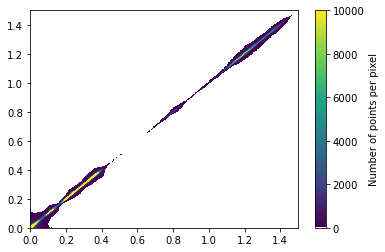

In [219]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [220]:
sample = df[df["date"] == '01_01_2020']

In [221]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,0.797174,62.230810,-162.77490,01_01_2020,0.136579
18329588,176.776952,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,0.845337,62.081207,-162.77490,01_01_2020,0.371299
18329589,181.312867,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,0.873384,62.230810,-162.49481,01_01_2020,1.187509
18329590,183.489251,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,0.842133,62.381150,-162.40146,01_01_2020,0.367274
18329591,182.247955,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,0.940199,61.932335,-162.21474,01_01_2020,0.243427


In [222]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [223]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
18329587,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,62.230810,-162.77490,0.797174
18329588,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,62.081207,-162.77490,0.845337
18329589,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,62.230810,-162.49481,0.873384
18329590,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,62.381150,-162.40146,0.842133
18329591,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,61.932335,-162.21474,0.940199


In [224]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [225]:
y_sample_pred = model.predict(X_sample_scaled)

In [226]:
y_sample_pred

array([0.14080018, 0.37984227, 1.20518452, ..., 0.12584195, 0.12413857,
       0.12332729])

In [227]:
X_sample["vod"] = y_sample_pred

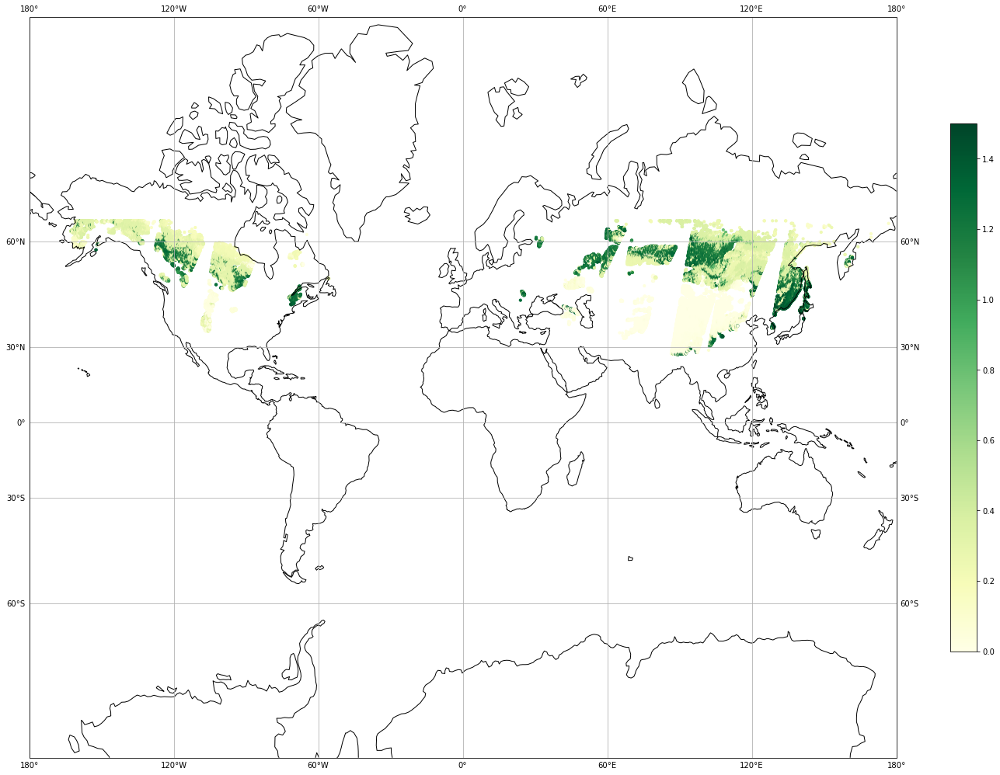

In [228]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

#### Robust Scaled

In [241]:
model = DecisionTreeRegressor(random_state=0) 

In [242]:
%%time
model.fit(X_train, y_train)

CPU times: total: 5min 18s
Wall time: 6min 6s


DecisionTreeRegressor(random_state=0)

In [243]:
model.score(X_train, y_train)

1.0

In [244]:
model.score(X_test, y_test)

0.9942185298892681

In [245]:
with open("Models\\DTR\\vod_dtr_model_robust_scaled_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(model, file)

In [246]:
y_pred = model.predict(X_test)

In [247]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.003341941797290063

In [248]:
mse = mean_squared_error(y_test, y_pred)
mse

0.0009476320678983326

In [249]:
rmse = mse**(1/2.0)
rmse

0.03078363311726432

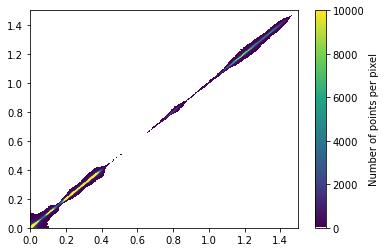

In [250]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [251]:
sample = df[df["date"] == '01_01_2020']

In [252]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,0.797174,62.230810,-162.77490,01_01_2020,0.136579
18329588,176.776952,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,0.845337,62.081207,-162.77490,01_01_2020,0.371299
18329589,181.312867,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,0.873384,62.230810,-162.49481,01_01_2020,1.187509
18329590,183.489251,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,0.842133,62.381150,-162.40146,01_01_2020,0.367274
18329591,182.247955,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,0.940199,61.932335,-162.21474,01_01_2020,0.243427


In [253]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [254]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
18329587,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,62.230810,-162.77490,0.797174
18329588,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,62.081207,-162.77490,0.845337
18329589,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,62.230810,-162.49481,0.873384
18329590,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,62.381150,-162.40146,0.842133
18329591,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,61.932335,-162.21474,0.940199


In [255]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [256]:
y_sample_pred = model.predict(X_sample_scaled)

In [257]:
y_sample_pred

array([0.14080018, 0.37984227, 1.20518452, ..., 0.12653071, 0.12413857,
       0.12332729])

In [258]:
X_sample["vod"] = y_sample_pred

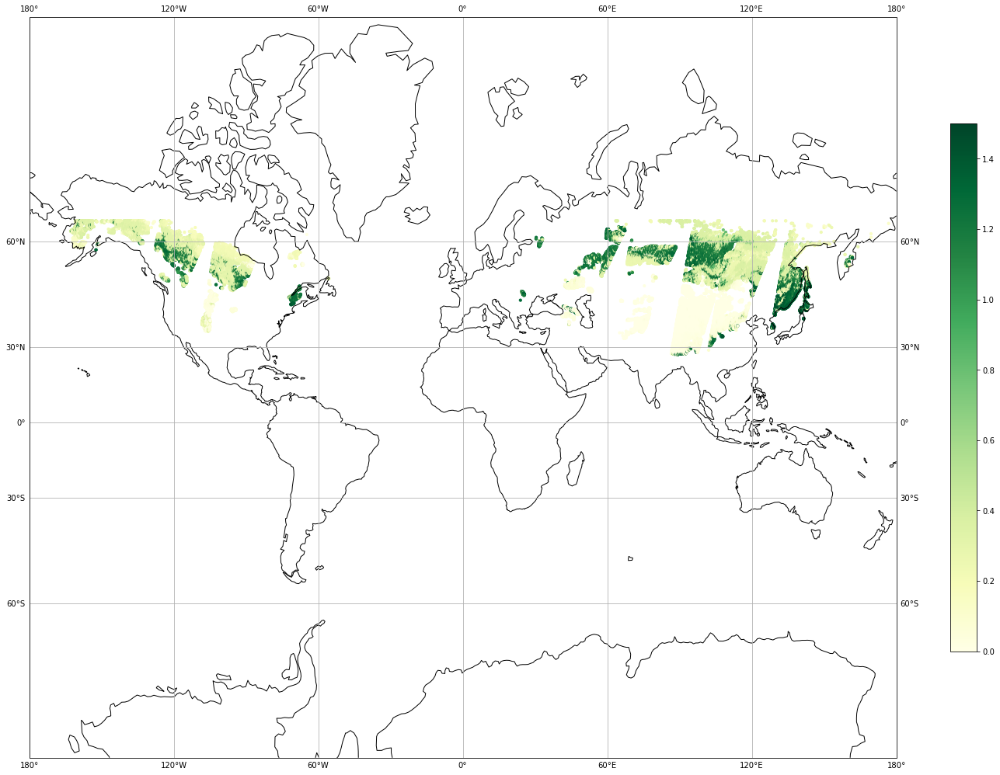

In [259]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

#### Standard Scaled

In [272]:
model = DecisionTreeRegressor(random_state=0) 

In [273]:
%%time
model.fit(X_train, y_train)

CPU times: total: 5min 16s
Wall time: 5min 57s


DecisionTreeRegressor(random_state=0)

In [274]:
model.score(X_train, y_train)

1.0

In [275]:
model.score(X_test, y_test)

0.9942806397588685

In [276]:
with open("Models\\DTR\\vod_dtr_model_standard_scaled_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(model, file)

In [277]:
y_pred = model.predict(X_test)

In [278]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.0033274170653238145

In [279]:
mse = mean_squared_error(y_test, y_pred)
mse

0.0009374517326135196

In [280]:
rmse = mse**(1/2.0)
rmse

0.03061783357152363

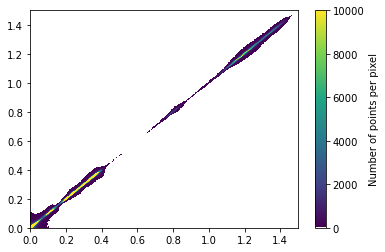

In [281]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [282]:
sample = df[df["date"] == '01_01_2020']

In [283]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,0.797174,62.230810,-162.77490,01_01_2020,0.136579
18329588,176.776952,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,0.845337,62.081207,-162.77490,01_01_2020,0.371299
18329589,181.312867,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,0.873384,62.230810,-162.49481,01_01_2020,1.187509
18329590,183.489251,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,0.842133,62.381150,-162.40146,01_01_2020,0.367274
18329591,182.247955,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,0.940199,61.932335,-162.21474,01_01_2020,0.243427


In [284]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [285]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
18329587,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,62.230810,-162.77490,0.797174
18329588,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,62.081207,-162.77490,0.845337
18329589,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,62.230810,-162.49481,0.873384
18329590,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,62.381150,-162.40146,0.842133
18329591,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,61.932335,-162.21474,0.940199


In [286]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [287]:
y_sample_pred = model.predict(X_sample_scaled)

In [288]:
y_sample_pred

array([0.14080018, 0.37984227, 1.20518452, ..., 0.12653071, 0.12413857,
       0.12332729])

In [289]:
X_sample["vod"] = y_sample_pred

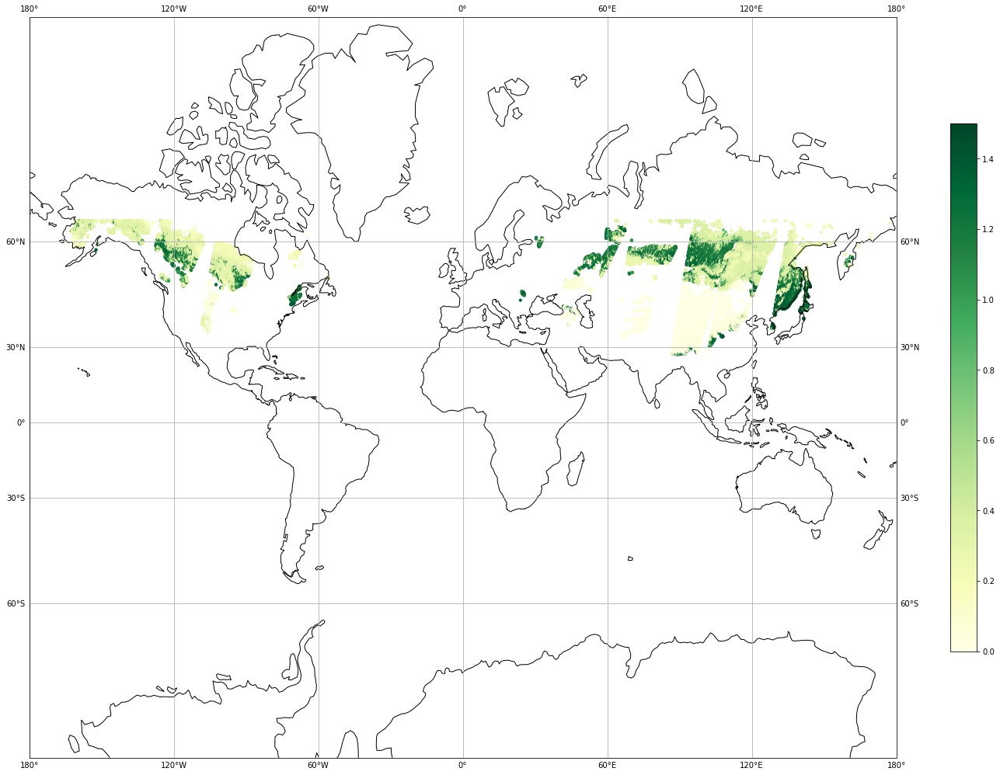

In [290]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

### 2019 as Train and 2020 as Test

#### Original Data

In [407]:
model = DecisionTreeRegressor(random_state=0) 

In [408]:
%%time
model.fit(X_train, y_train)

CPU times: total: 6min 26s
Wall time: 6min 58s


DecisionTreeRegressor(random_state=0)

In [409]:
model.score(X_train, y_train)

1.0

In [410]:
model.score(X_test, y_test)

0.9807659134075202

In [411]:
with open("Models\\DTR\\vod_dtr_model_org_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(model, file)

In [412]:
y_pred = model.predict(X_test)

In [413]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.014891918833658166

In [414]:
mse = mean_squared_error(y_test, y_pred)
mse

0.002752111908955819

In [415]:
rmse = mse**(1/2.0)
rmse

0.052460574805808395

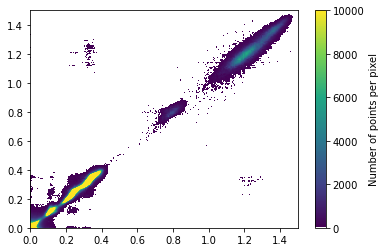

In [416]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [350]:
sample = df[df["date"] == '01_01_2020']

In [417]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,0.797174,62.230810,-162.77490,01_01_2020,0.136579
18329588,176.776952,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,0.845337,62.081207,-162.77490,01_01_2020,0.371299
18329589,181.312867,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,0.873384,62.230810,-162.49481,01_01_2020,1.187509
18329590,183.489251,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,0.842133,62.381150,-162.40146,01_01_2020,0.367274
18329591,182.247955,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,0.940199,61.932335,-162.21474,01_01_2020,0.243427


In [418]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [419]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
18329587,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,62.230810,-162.77490,0.797174
18329588,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,62.081207,-162.77490,0.845337
18329589,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,62.230810,-162.49481,0.873384
18329590,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,62.381150,-162.40146,0.842133
18329591,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,61.932335,-162.21474,0.940199


In [420]:
y_sample_pred = model.predict(X_sample)

In [421]:
y_sample_pred

array([0.14080018, 0.37984227, 1.20518452, ..., 0.12584195, 0.12413857,
       0.12332729])

In [422]:
X_sample["vod"] = y_sample_pred

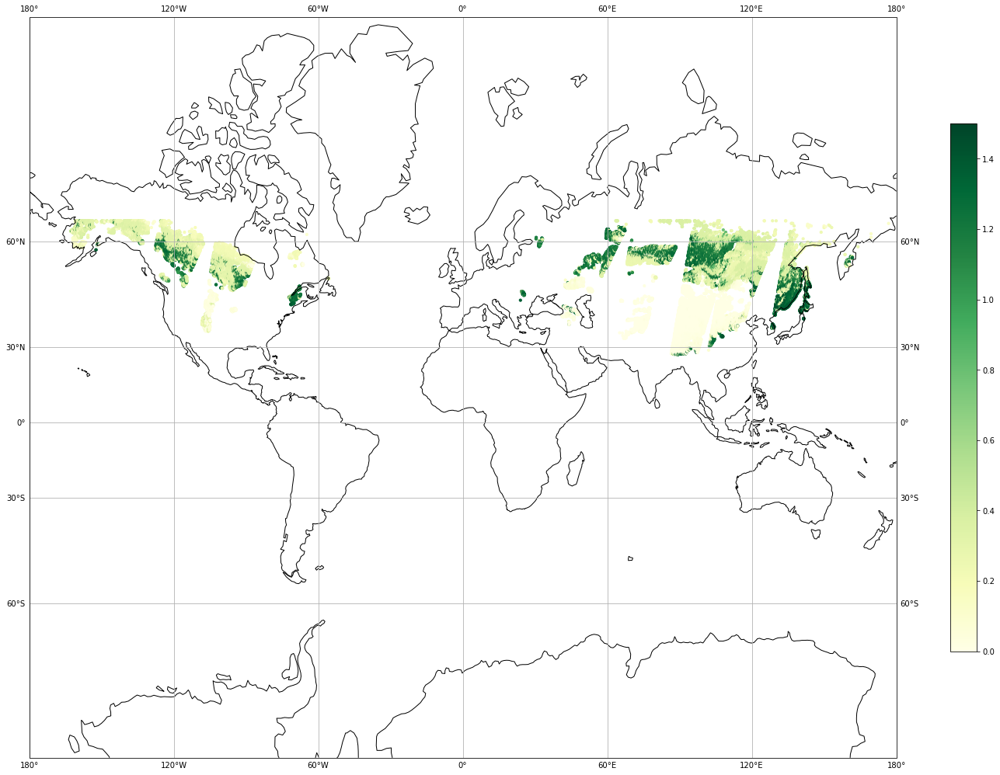

In [423]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

In [ ]:
import plotly.express as px
fig = px.density_mapbox(predict_sample, lat='lat', lon='lon', z='snow_density', radius=1, color_continuous_scale='Blues',
                        center=dict(lat=0, lon=180), zoom=0,
                        mapbox_style="open-street-map")
fig.show()

#### MinMax Scaled

In [306]:
model = DecisionTreeRegressor(random_state=0) 

In [307]:
%%time
model.fit(X_train, y_train)

CPU times: total: 5min 34s
Wall time: 6min 43s


DecisionTreeRegressor(random_state=0)

In [308]:
model.score(X_train, y_train)

1.0

In [309]:
model.score(X_test, y_test)

0.9806436810095522

In [310]:
with open("Models\\DTR\\vod_dtr_model_min_max_scaled_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(model, file)

In [311]:
y_pred = model.predict(X_test)

In [312]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.014975919581300179

In [313]:
mse = mean_squared_error(y_test, y_pred)
mse

0.002769601548325498

In [314]:
rmse = mse**(1/2.0)
rmse

0.05262700398393868

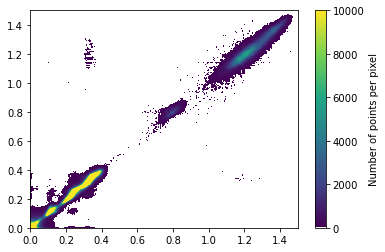

In [315]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [329]:
sample = df[df["date"] == '01_01_2020']

In [330]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,0.797174,62.230810,-162.77490,01_01_2020,0.136579
18329588,176.776952,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,0.845337,62.081207,-162.77490,01_01_2020,0.371299
18329589,181.312867,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,0.873384,62.230810,-162.49481,01_01_2020,1.187509
18329590,183.489251,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,0.842133,62.381150,-162.40146,01_01_2020,0.367274
18329591,182.247955,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,0.940199,61.932335,-162.21474,01_01_2020,0.243427


In [331]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [332]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
18329587,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,62.230810,-162.77490,0.797174
18329588,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,62.081207,-162.77490,0.845337
18329589,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,62.230810,-162.49481,0.873384
18329590,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,62.381150,-162.40146,0.842133
18329591,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,61.932335,-162.21474,0.940199


In [333]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [334]:
y_sample_pred = model.predict(X_sample_scaled)

In [335]:
y_sample_pred

array([0.14080018, 0.37984227, 1.20518452, ..., 0.12584195, 0.12413857,
       0.169586  ])

In [336]:
X_sample["vod"] = y_sample_pred

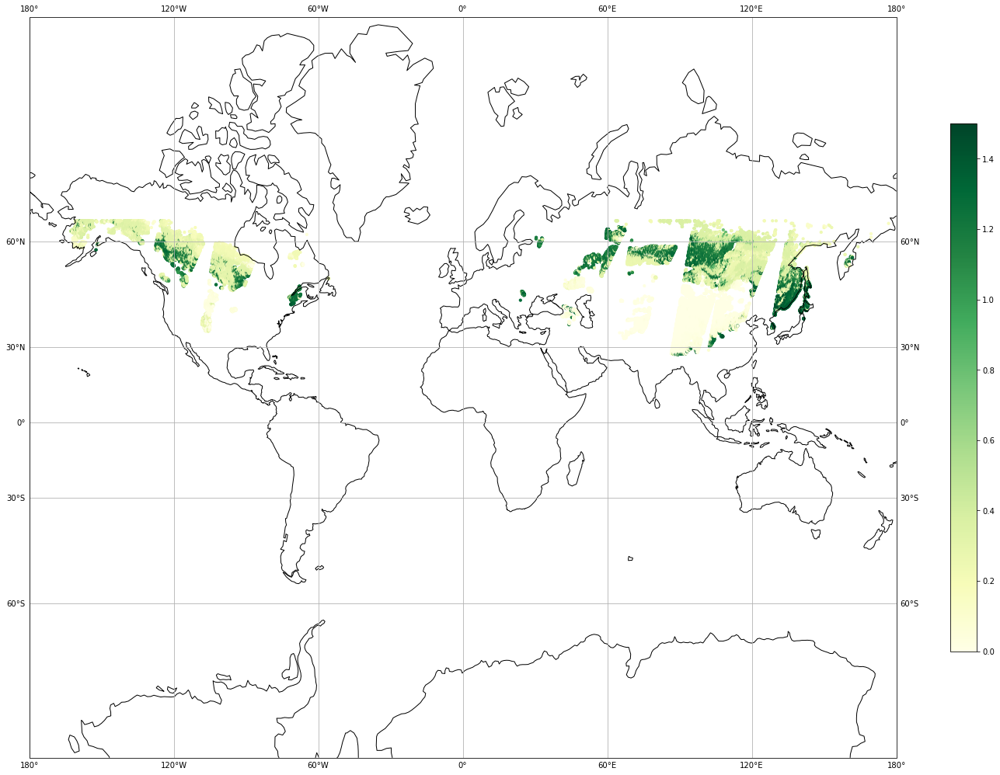

In [337]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

#### Robust Scaled

In [353]:
model = DecisionTreeRegressor(random_state=0) 

In [354]:
%%time
model.fit(X_train, y_train)

CPU times: total: 5min 35s
Wall time: 6min 37s


DecisionTreeRegressor(random_state=0)

In [355]:
model.score(X_train, y_train)

1.0

In [356]:
model.score(X_test, y_test)

0.9802655446568599

In [357]:
with open("Models\\DTR\\vod_dtr_model_robust_scaled_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(model, file)

In [358]:
y_pred = model.predict(X_test)

In [359]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.015028442840844857

In [360]:
mse = mean_squared_error(y_test, y_pred)
mse

0.0028237072400332996

In [361]:
rmse = mse**(1/2.0)
rmse

0.053138566409278484

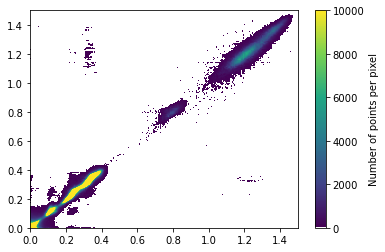

In [362]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [380]:
sample = df[df["date"] == '01_01_2020']

In [381]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,0.797174,62.230810,-162.77490,01_01_2020,0.136579
18329588,176.776952,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,0.845337,62.081207,-162.77490,01_01_2020,0.371299
18329589,181.312867,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,0.873384,62.230810,-162.49481,01_01_2020,1.187509
18329590,183.489251,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,0.842133,62.381150,-162.40146,01_01_2020,0.367274
18329591,182.247955,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,0.940199,61.932335,-162.21474,01_01_2020,0.243427


In [382]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [383]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
18329587,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,62.230810,-162.77490,0.797174
18329588,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,62.081207,-162.77490,0.845337
18329589,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,62.230810,-162.49481,0.873384
18329590,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,62.381150,-162.40146,0.842133
18329591,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,61.932335,-162.21474,0.940199


In [384]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [385]:
y_sample_pred = model.predict(X_sample_scaled)

In [386]:
y_sample_pred

array([0.14080018, 0.37984227, 1.20518452, ..., 0.12644771, 0.12413857,
       0.12332729])

In [387]:
X_sample["vod"] = y_sample_pred

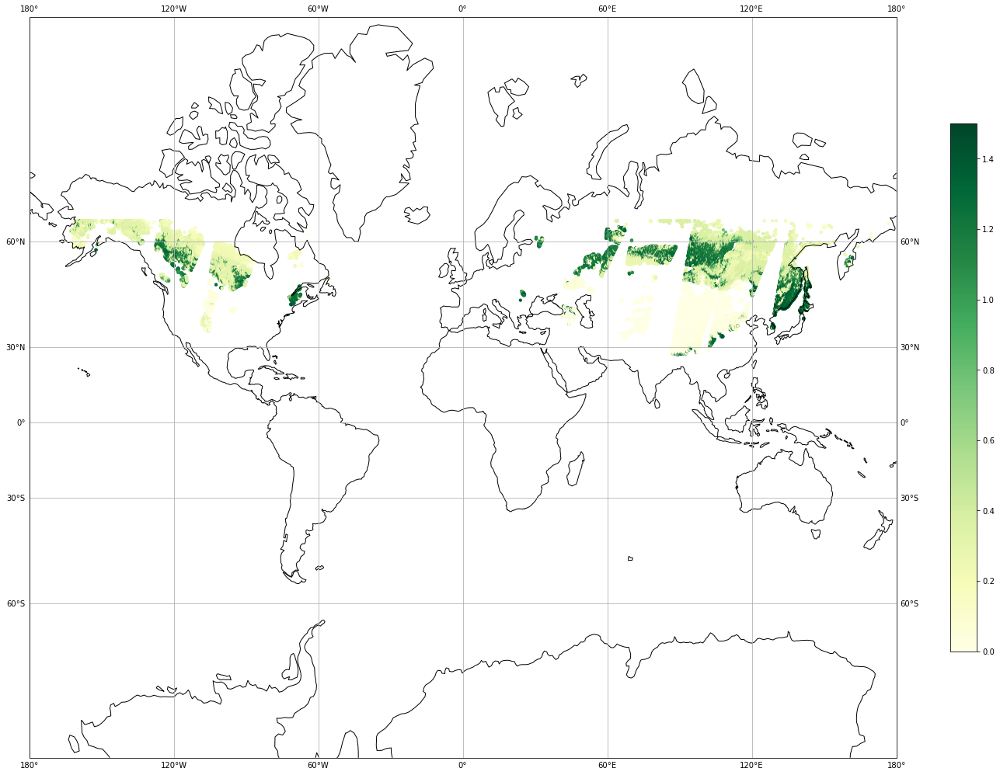

In [388]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

#### Standard Scaled

In [400]:
model = DecisionTreeRegressor(random_state=0) 

In [401]:
%%time
model.fit(X_train, y_train)

CPU times: total: 5min 19s
Wall time: 6min 40s


DecisionTreeRegressor(random_state=0)

In [26]:
model.score(X_train, y_train)

1.0

In [27]:
model.score(X_test, y_test)

0.9803817187070235

In [404]:
with open("Models\\DTR\\vod_dtr_model_standard_scaled_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(model, file)

In [10]:
with open("Models\\DTR\\vod_dtr_model_standard_scaled_2019_train_2020_test.pkl", 'rb') as file:
    model = pickle.load(file)

In [405]:
y_pred = model.predict(X_test)

In [406]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.015017091814694187

In [407]:
mse = mean_squared_error(y_test, y_pred)
mse

0.0028070844601872282

In [408]:
rmse = mse**(1/2.0)
rmse

0.052981925787830966

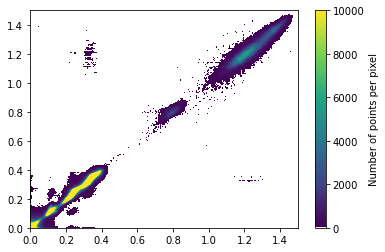

In [409]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [28]:
sample = df[df["date"] == '01_01_2020']

In [29]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,0.797174,62.230810,-162.77490,01_01_2020,0.136579
18329588,176.776952,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,0.845337,62.081207,-162.77490,01_01_2020,0.371299
18329589,181.312867,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,0.873384,62.230810,-162.49481,01_01_2020,1.187509
18329590,183.489251,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,0.842133,62.381150,-162.40146,01_01_2020,0.367274
18329591,182.247955,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,0.940199,61.932335,-162.21474,01_01_2020,0.243427


In [30]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [31]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
18329587,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,62.230810,-162.77490,0.797174
18329588,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,62.081207,-162.77490,0.845337
18329589,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,62.230810,-162.49481,0.873384
18329590,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,62.381150,-162.40146,0.842133
18329591,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,61.932335,-162.21474,0.940199


In [32]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [33]:
y_sample_pred = model.predict(X_sample_scaled)

In [34]:
y_sample_pred

array([0.14080018, 0.37984227, 1.20518452, ..., 0.12616343, 0.12413857,
       0.12332729])

In [35]:
X_sample["vod"] = y_sample_pred

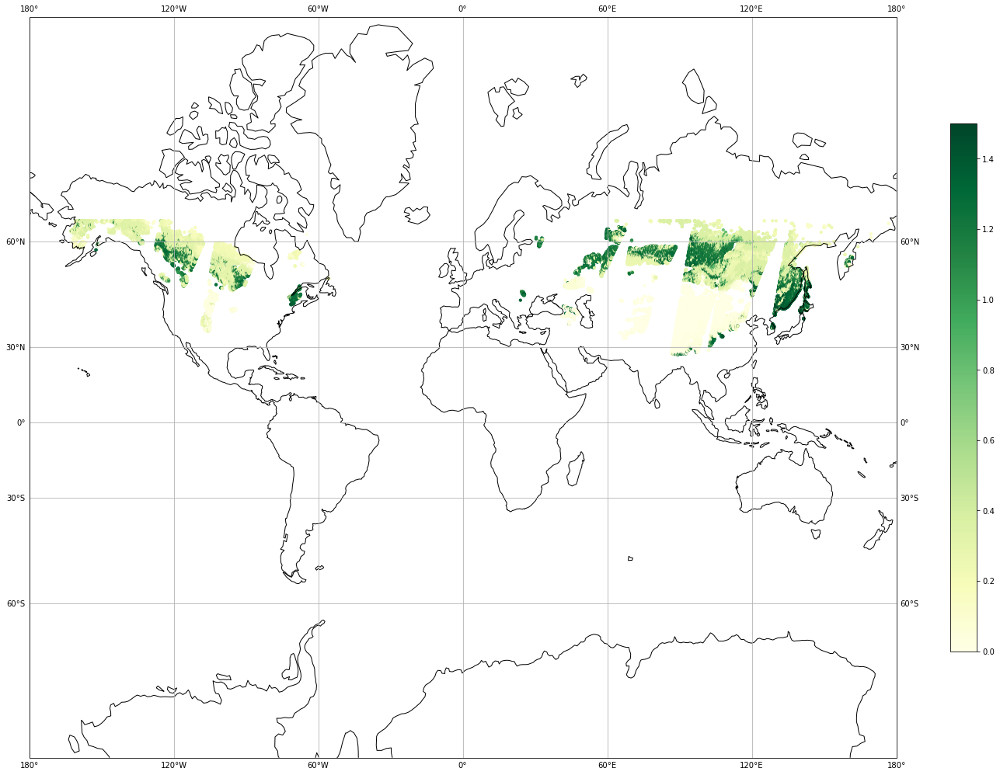

In [36]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

## Random Forest Regressor

### 2019 as Train/Test

In [466]:
base_model = RandomForestRegressor(n_estimators=10, random_state=0)

In [467]:
%%time
base_model.fit(X_train, y_train)

CPU times: total: 37min 24s
Wall time: 41min 16s


RandomForestRegressor(n_estimators=10, random_state=0)

In [468]:
base_model.score(X_train, y_train)

0.9993186983047364

In [469]:
base_model.score(X_test, y_test)

0.9964209074170735

In [470]:
y_pred = base_model.predict(X_test)

In [471]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.003714355095104013

In [472]:
mse = mean_squared_error(y_test, y_pred)
mse

0.0005866436806898741

In [473]:
rmse = mse**(1/2.0)
rmse

0.02422072832699038

In [474]:
with open("Models\\RFR\\vod_rfr_base_model_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(base_model, file)

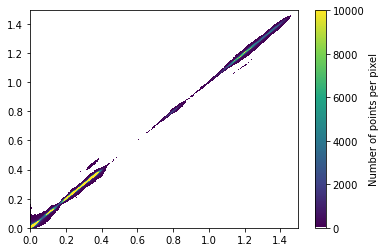

In [475]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [350]:
sample = df[df["date"] == '01_01_2020']

In [476]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,0.797174,62.230810,-162.77490,01_01_2020,0.136579
18329588,176.776952,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,0.845337,62.081207,-162.77490,01_01_2020,0.371299
18329589,181.312867,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,0.873384,62.230810,-162.49481,01_01_2020,1.187509
18329590,183.489251,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,0.842133,62.381150,-162.40146,01_01_2020,0.367274
18329591,182.247955,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,0.940199,61.932335,-162.21474,01_01_2020,0.243427


In [477]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [478]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
18329587,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,62.230810,-162.77490,0.797174
18329588,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,62.081207,-162.77490,0.845337
18329589,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,62.230810,-162.49481,0.873384
18329590,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,62.381150,-162.40146,0.842133
18329591,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,61.932335,-162.21474,0.940199


In [479]:
y_sample_pred = model.predict(X_sample)

In [480]:
y_sample_pred

array([0.23854601, 0.23854601, 0.23854601, ..., 0.10611442, 0.09563398,
       0.09563398])

In [481]:
X_sample["vod"] = y_sample_pred

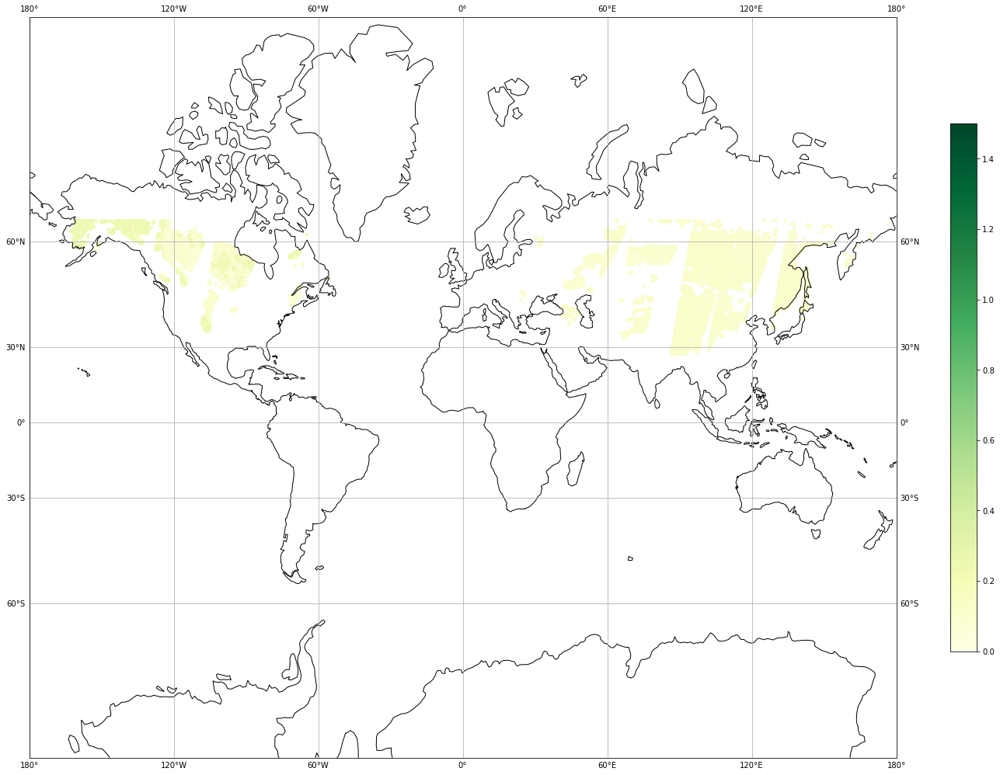

In [482]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

### 2019 as Train and 2020 as Test

In [487]:
base_model_2019_train = RandomForestRegressor(n_estimators=10, random_state=0)

In [488]:
%%time
base_model_2019_train.fit(X_train, y_train)

CPU times: total: 41min 58s
Wall time: 46min 21s


RandomForestRegressor(n_estimators=10, random_state=0)

In [489]:
base_model_2019_train.score(X_train, y_train)

0.9994817548749731

In [490]:
base_model_2019_train.score(X_test, y_test)

0.9871944399250312

In [491]:
y_pred = base_model_2019_train.predict(X_test)

In [492]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.014517215460480896

In [493]:
mse = mean_squared_error(y_test, y_pred)
mse

0.0018322853135614946

In [494]:
rmse = mse**(1/2.0)
rmse

0.042805201945108194

In [495]:
with open("Models\\RFR\\vod_rfr_base_model_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(base_model_2019_train, file)

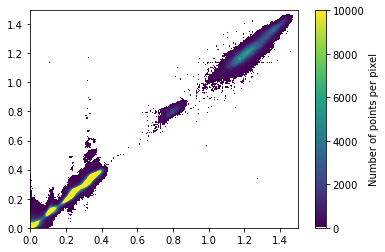

In [496]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [350]:
sample = df[df["date"] == '01_01_2020']

In [497]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,0.797174,62.230810,-162.77490,01_01_2020,0.136579
18329588,176.776952,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,0.845337,62.081207,-162.77490,01_01_2020,0.371299
18329589,181.312867,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,0.873384,62.230810,-162.49481,01_01_2020,1.187509
18329590,183.489251,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,0.842133,62.381150,-162.40146,01_01_2020,0.367274
18329591,182.247955,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,0.940199,61.932335,-162.21474,01_01_2020,0.243427


In [498]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density']]

In [499]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density
18329587,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,62.230810,-162.77490,0.797174
18329588,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,62.081207,-162.77490,0.845337
18329589,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,62.230810,-162.49481,0.873384
18329590,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,62.381150,-162.40146,0.842133
18329591,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,61.932335,-162.21474,0.940199


In [500]:
y_sample_pred = model.predict(X_sample)

In [501]:
y_sample_pred

array([0.23854601, 0.23854601, 0.23854601, ..., 0.10611442, 0.09563398,
       0.09563398])

In [502]:
X_sample["vod"] = y_sample_pred

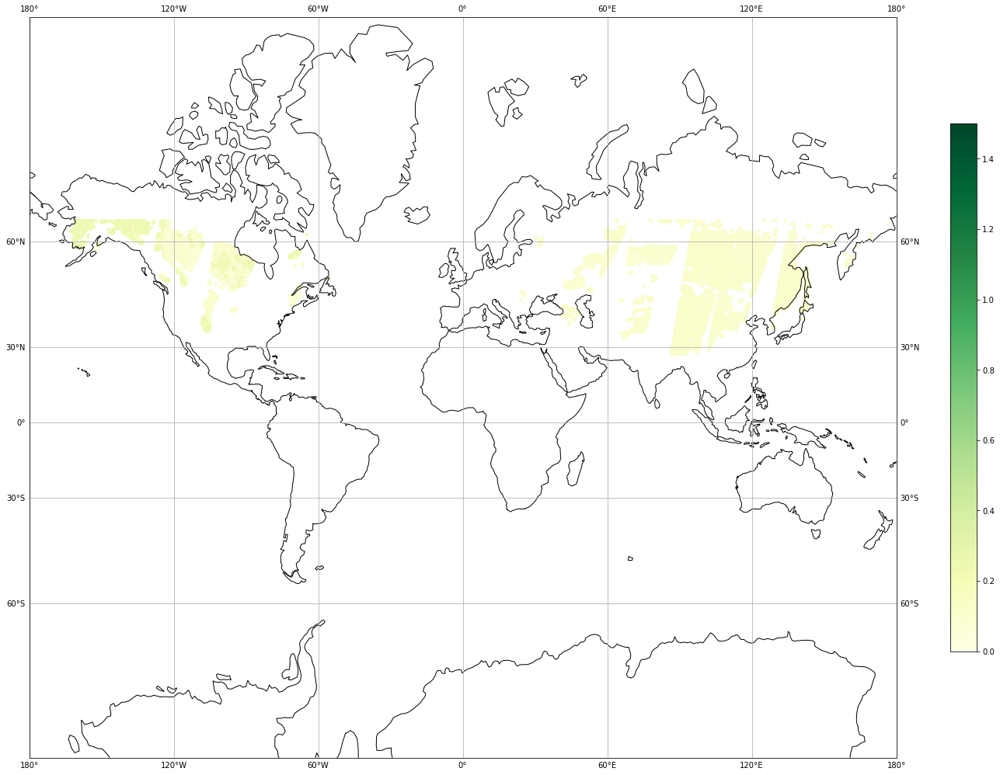

In [505]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

# Snow Density with VOD as input

## Dataset Split

#### Random Test Train Split on only 2019

In [57]:
df1 = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [58]:
X = df1[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]
y = df1['snow_density']

In [59]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, shuffle=True, random_state=0)

#### Train 2019, Test 2020

In [101]:
train = pd.read_csv(os.path.join(dir_path, "train.csv"))

In [102]:
train = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [103]:
train.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,268.206835,273.037231,0.077934,250.853485,255.755310,0.167626,1.250319,0.959070,62.684110,-160.44087,01_01_2019,0.360216
1,161.904102,270.752674,272.944916,0.078347,252.357315,255.754684,0.170824,1.239644,0.973190,62.532246,-160.44087,01_01_2019,0.343348
2,163.183896,270.971431,272.960205,0.079091,254.316711,257.457397,0.176738,1.237796,0.997815,62.381150,-160.44087,01_01_2019,0.363338
3,164.070027,271.314168,272.987762,0.079008,254.165604,258.057922,0.165714,1.237237,0.981988,62.230810,-160.44087,01_01_2019,0.360973
4,158.706063,269.161864,272.945801,0.079000,250.542023,254.916229,0.166220,1.237293,0.953300,62.684110,-160.34750,01_01_2019,0.359798


In [104]:
X_train = train[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]
y_train = train['snow_density']

In [105]:
test = pd.read_csv(os.path.join(dir_path, "test.csv"))

In [105]:
test = df[df["date"].apply(lambda x: x.split('_')[2] == '2020')]

In [106]:
test.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,0.797174,62.230810,-162.77490,01_01_2020,0.136579
18329588,176.776952,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,0.845337,62.081207,-162.77490,01_01_2020,0.371299
18329589,181.312867,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,0.873384,62.230810,-162.49481,01_01_2020,1.187509
18329590,183.489251,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,0.842133,62.381150,-162.40146,01_01_2020,0.367274
18329591,182.247955,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,0.940199,61.932335,-162.21474,01_01_2020,0.243427


In [107]:
X_test = test[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]
y_test = test['snow_density']

## Trying Scaling Techniques

#### MinMax

In [128]:
scaler = MinMaxScaler() 

#### Take 2019 and do train, val and test split

In [42]:
df1 = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [43]:
df1.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,268.206835,273.037231,0.077934,250.853485,255.755310,0.167626,1.250319,0.959070,62.684110,-160.44087,01_01_2019,0.360216
1,161.904102,270.752674,272.944916,0.078347,252.357315,255.754684,0.170824,1.239644,0.973190,62.532246,-160.44087,01_01_2019,0.343348
2,163.183896,270.971431,272.960205,0.079091,254.316711,257.457397,0.176738,1.237796,0.997815,62.381150,-160.44087,01_01_2019,0.363338
3,164.070027,271.314168,272.987762,0.079008,254.165604,258.057922,0.165714,1.237237,0.981988,62.230810,-160.44087,01_01_2019,0.360973
4,158.706063,269.161864,272.945801,0.079000,250.542023,254.916229,0.166220,1.237293,0.953300,62.684110,-160.34750,01_01_2019,0.359798


In [44]:
X = df1[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]
y = df1['snow_density']

In [45]:
X_scaled = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)

In [46]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.20, shuffle=True, random_state=0)

In [47]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
17720940,0.781561,0.941262,0.709649,0.723646,0.716712,0.285109,0.034816,0.843425,0.171725,0.571699,0.186592
11233780,0.907268,0.945543,0.728440,0.722316,0.727172,0.219747,0.116229,0.846516,0.121920,0.428076,0.067156
2485422,0.823962,0.849550,0.700000,0.639282,0.631964,0.307740,0.339076,0.760573,0.242283,0.640580,0.242821
1154291,0.518025,0.803122,0.700000,0.711224,0.705540,0.340568,0.082276,0.800952,0.869780,0.404503,0.082745
6723943,0.641780,0.902755,0.710169,0.681389,0.673606,0.397789,0.025987,0.814403,0.215305,0.602589,0.227649


In [48]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
8175713,0.689661,0.898243,0.700000,0.719632,0.716880,0.315937,0.106072,0.832409,0.873930,0.449685,0.223911
18055958,0.750584,0.919998,0.708403,0.691154,0.690761,0.359609,0.011335,0.832409,0.194812,0.551537,0.108192
4853484,0.627939,0.984761,0.779338,0.717008,0.719574,0.451925,0.040825,0.773244,0.262776,0.542885,0.736916
16883108,0.460363,0.940657,0.701653,0.738804,0.722278,0.320924,0.108938,0.819029,0.847211,0.465421,0.166037
44884,0.696316,0.804377,0.000000,0.640849,0.696834,0.092715,0.032792,0.708750,0.750195,0.823778,0.000000


#### Take whole of 2019 as train and whole 2020 as test

In [129]:
df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']] = scaler.fit_transform(df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']])


In [130]:
df.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,0.908916,0.998302,0.779338,0.710750,0.708752,0.305672,0.124832,0.408674,0.863969,0.054215,01_01_2019,0.240164
1,161.904102,0.955726,0.995804,0.783470,0.715650,0.708749,0.311526,0.123756,0.421018,0.862857,0.054215,01_01_2019,0.228918
2,163.183896,0.959748,0.996218,0.790908,0.722035,0.714708,0.322348,0.123569,0.442547,0.861749,0.054215,01_01_2019,0.242246
3,164.070027,0.966050,0.996963,0.790081,0.721543,0.716810,0.302173,0.123513,0.428711,0.860648,0.054215,01_01_2019,0.240669
4,158.706063,0.926476,0.995828,0.789999,0.709735,0.705815,0.303099,0.123518,0.403630,0.863969,0.054475,01_01_2019,0.239886


In [131]:
train = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [132]:
train.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,0.908916,0.998302,0.779338,0.710750,0.708752,0.305672,0.124832,0.408674,0.863969,0.054215,01_01_2019,0.240164
1,161.904102,0.955726,0.995804,0.783470,0.715650,0.708749,0.311526,0.123756,0.421018,0.862857,0.054215,01_01_2019,0.228918
2,163.183896,0.959748,0.996218,0.790908,0.722035,0.714708,0.322348,0.123569,0.442547,0.861749,0.054215,01_01_2019,0.242246
3,164.070027,0.966050,0.996963,0.790081,0.721543,0.716810,0.302173,0.123513,0.428711,0.860648,0.054215,01_01_2019,0.240669
4,158.706063,0.926476,0.995828,0.789999,0.709735,0.705815,0.303099,0.123518,0.403630,0.863969,0.054475,01_01_2019,0.239886


In [133]:
X_train = train[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]
y_train = train['snow_density']

In [134]:
test = df[df["date"].apply(lambda x: x.split('_')[2] == '2020')]

In [135]:
test.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,0.605666,0.979289,0.725619,0.710505,0.715126,0.305186,0.113270,0.267135,0.860648,0.047730,01_01_2020,0.091060
18329588,176.776952,0.608976,0.971580,0.746666,0.701298,0.703409,0.334429,0.104657,0.309242,0.859552,0.047730,01_01_2020,0.247554
18329589,181.312867,0.594961,0.918358,0.745378,0.709829,0.718960,0.299206,0.105855,0.333763,0.860648,0.048508,01_01_2020,0.791739
18329590,183.489251,0.589092,0.946560,0.737288,0.713899,0.722697,0.275514,0.112478,0.306441,0.861749,0.048768,01_01_2020,0.244870
18329591,182.247955,0.567396,0.862735,0.745613,0.695790,0.703448,0.363539,0.096604,0.392176,0.858461,0.049287,01_01_2020,0.162298


In [136]:
X_test = test[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]
y_test = test['snow_density']

In [137]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
0,0.908916,0.998302,0.779338,0.710750,0.708752,0.305672,0.124832,0.863969,0.054215,0.408674,0.240164
1,0.955726,0.995804,0.783470,0.715650,0.708749,0.311526,0.123756,0.862857,0.054215,0.421018,0.228918
2,0.959748,0.996218,0.790908,0.722035,0.714708,0.322348,0.123569,0.861749,0.054215,0.442547,0.242246
3,0.966050,0.996963,0.790081,0.721543,0.716810,0.302173,0.123513,0.860648,0.054215,0.428711,0.240669
4,0.926476,0.995828,0.789999,0.709735,0.705815,0.303099,0.123518,0.863969,0.054475,0.403630,0.239886


In [138]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
18329587,0.605666,0.979289,0.725619,0.710505,0.715126,0.305186,0.113270,0.860648,0.047730,0.267135,0.091060
18329588,0.608976,0.971580,0.746666,0.701298,0.703409,0.334429,0.104657,0.859552,0.047730,0.309242,0.247554
18329589,0.594961,0.918358,0.745378,0.709829,0.718960,0.299206,0.105855,0.860648,0.048508,0.333763,0.791739
18329590,0.589092,0.946560,0.737288,0.713899,0.722697,0.275514,0.112478,0.861749,0.048768,0.306441,0.244870
18329591,0.567396,0.862735,0.745613,0.695790,0.703448,0.363539,0.096604,0.858461,0.049287,0.392176,0.162298


<AxesSubplot:>

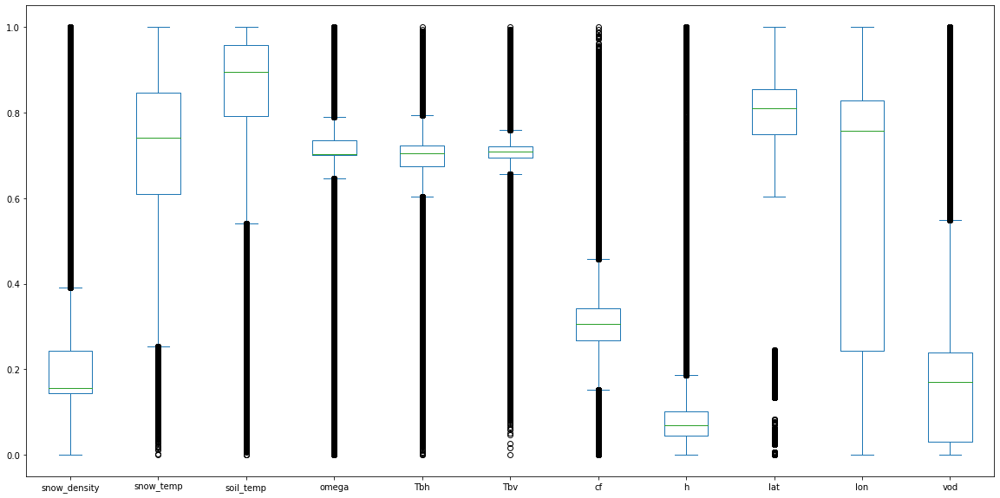

In [224]:
df_minmax_scaled.plot(kind='box', figsize=(20, 10))

#### Robust

In [162]:
scaler = RobustScaler()

#### Take 2019 and do train, val and test split

In [70]:
df1 = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [71]:
df1.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,268.206835,273.037231,0.077934,250.853485,255.755310,0.167626,1.250319,0.959070,62.684110,-160.44087,01_01_2019,0.360216
1,161.904102,270.752674,272.944916,0.078347,252.357315,255.754684,0.170824,1.239644,0.973190,62.532246,-160.44087,01_01_2019,0.343348
2,163.183896,270.971431,272.960205,0.079091,254.316711,257.457397,0.176738,1.237796,0.997815,62.381150,-160.44087,01_01_2019,0.363338
3,164.070027,271.314168,272.987762,0.079008,254.165604,258.057922,0.165714,1.237237,0.981988,62.230810,-160.44087,01_01_2019,0.360973
4,158.706063,269.161864,272.945801,0.079000,250.542023,254.916229,0.166220,1.237293,0.953300,62.684110,-160.34750,01_01_2019,0.359798


In [72]:
X = df1[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]
y = df1['snow_density']

In [73]:
X_scaled = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)

In [74]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.20, shuffle=True, random_state=0)

In [75]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
17720940,0.168703,0.280450,0.201532,0.392603,0.280260,-0.281963,-0.599797,0.317071,-1.003107,0.451021,0.082613
11233780,0.699074,0.306066,0.729715,0.364715,0.686521,-1.139818,0.829793,0.346261,-1.088327,-0.254425,-0.494966
2485422,0.347599,-0.268204,-0.069685,-1.375717,-3.011007,0.015067,4.742910,-0.465382,-0.882379,0.789349,0.354533
1154291,-0.943187,-0.545952,-0.069685,0.132225,-0.153606,0.445917,0.233576,-0.084040,0.191300,-0.370214,-0.419577
6723943,-0.421051,0.050091,0.216156,-0.493120,-1.393788,1.196928,-0.754831,0.042989,-0.928540,0.602746,0.281160


In [77]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
8175713,-0.219035,0.023098,-0.069685,0.308464,0.286795,0.122641,0.651433,0.213038,0.198402,-0.148287,0.263082
18055958,0.038006,0.153244,0.166517,-0.288456,-0.727570,0.695827,-1.012120,0.213038,-0.963604,0.351990,-0.296520
4853484,-0.479448,0.540678,2.160358,0.253457,0.391435,1.907455,-0.494292,-0.345722,-0.847315,0.309492,2.743915
16883108,-1.186469,0.276833,-0.023229,0.710317,0.496428,0.188098,0.701761,0.086672,0.152685,-0.070997,-0.016790
44884,-0.190955,-0.538445,-19.745311,-1.342862,-0.491714,-2.807078,-0.635349,-0.954799,-0.013316,1.689184,-0.819724


#### Take whole of 2019 as train and whole 2020 as test

In [163]:
df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']] = scaler.fit_transform(df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']])


In [164]:
df.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,0.716902,0.632292,2.066673,0.093482,-0.103660,-0.018768,0.948204,-0.357570,0.493368,-1.173027,01_01_2019,0.380111
1,161.904102,0.924634,0.613351,2.177784,0.199158,-0.103748,0.059500,0.929132,-0.293506,0.482420,-1.173027,01_01_2019,0.320323
2,163.183896,0.942483,0.616488,2.377786,0.336847,0.135919,0.204211,0.925830,-0.181778,0.471527,-1.173027,01_01_2019,0.391177
3,164.070027,0.970449,0.622142,2.355562,0.326229,0.220447,-0.065557,0.924831,-0.253585,0.460689,-1.173027,01_01_2019,0.382794
4,158.706063,0.794829,0.613533,2.353343,0.071595,-0.221765,-0.053179,0.924931,-0.383749,0.493368,-1.172593,01_01_2019,0.378631


In [165]:
train = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [166]:
train.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,0.716902,0.632292,2.066673,0.093482,-0.103660,-0.018768,0.948204,-0.357570,0.493368,-1.173027,01_01_2019,0.380111
1,161.904102,0.924634,0.613351,2.177784,0.199158,-0.103748,0.059500,0.929132,-0.293506,0.482420,-1.173027,01_01_2019,0.320323
2,163.183896,0.942483,0.616488,2.377786,0.336847,0.135919,0.204211,0.925830,-0.181778,0.471527,-1.173027,01_01_2019,0.391177
3,164.070027,0.970449,0.622142,2.355562,0.326229,0.220447,-0.065557,0.924831,-0.253585,0.460689,-1.173027,01_01_2019,0.382794
4,158.706063,0.794829,0.613533,2.353343,0.071595,-0.221765,-0.053179,0.924931,-0.383749,0.493368,-1.172593,01_01_2019,0.378631


In [167]:
X_train = train[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]
y_train = train['snow_density']

In [168]:
test = df[df["date"].apply(lambda x: x.split('_')[2] == '2020')]

In [169]:
test.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,-0.628844,0.488143,0.622224,0.088194,0.152715,-0.025272,0.743431,-1.092131,0.460689,-1.183868,01_01_2020,-0.412563
18329588,176.776952,-0.614156,0.429693,1.188158,-0.110352,-0.318561,0.365746,0.590880,-0.873605,0.449904,-1.183868,01_01_2020,0.419395
18329589,181.312867,-0.676350,0.026179,1.153509,0.073632,0.306933,-0.105226,0.612101,-0.746346,0.460689,-1.182567,01_01_2020,3.312426
18329590,183.489251,-0.702396,0.239998,0.935977,0.161392,0.457242,-0.422027,0.729401,-0.888140,0.471527,-1.182134,01_01_2020,0.405129
18329591,182.247955,-0.798676,-0.395543,1.159850,-0.229139,-0.316959,0.754991,0.448262,-0.443193,0.439172,-1.181266,01_01_2020,-0.033844


In [170]:
X_test = test[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]
y_test = test['snow_density']

In [171]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
0,0.716902,0.632292,2.066673,0.093482,-0.103660,-0.018768,0.948204,0.493368,-1.173027,-0.357570,0.380111
1,0.924634,0.613351,2.177784,0.199158,-0.103748,0.059500,0.929132,0.482420,-1.173027,-0.293506,0.320323
2,0.942483,0.616488,2.377786,0.336847,0.135919,0.204211,0.925830,0.471527,-1.173027,-0.181778,0.391177
3,0.970449,0.622142,2.355562,0.326229,0.220447,-0.065557,0.924831,0.460689,-1.173027,-0.253585,0.382794
4,0.794829,0.613533,2.353343,0.071595,-0.221765,-0.053179,0.924931,0.493368,-1.172593,-0.383749,0.378631


In [172]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
18329587,-0.628844,0.488143,0.622224,0.088194,0.152715,-0.025272,0.743431,0.460689,-1.183868,-1.092131,-0.412563
18329588,-0.614156,0.429693,1.188158,-0.110352,-0.318561,0.365746,0.590880,0.449904,-1.183868,-0.873605,0.419395
18329589,-0.676350,0.026179,1.153509,0.073632,0.306933,-0.105226,0.612101,0.460689,-1.182567,-0.746346,3.312426
18329590,-0.702396,0.239998,0.935977,0.161392,0.457242,-0.422027,0.729401,0.471527,-1.182134,-0.888140,0.405129
18329591,-0.798676,-0.395543,1.159850,-0.229139,-0.316959,0.754991,0.448262,0.439172,-1.181266,-0.443193,-0.033844


<AxesSubplot:>

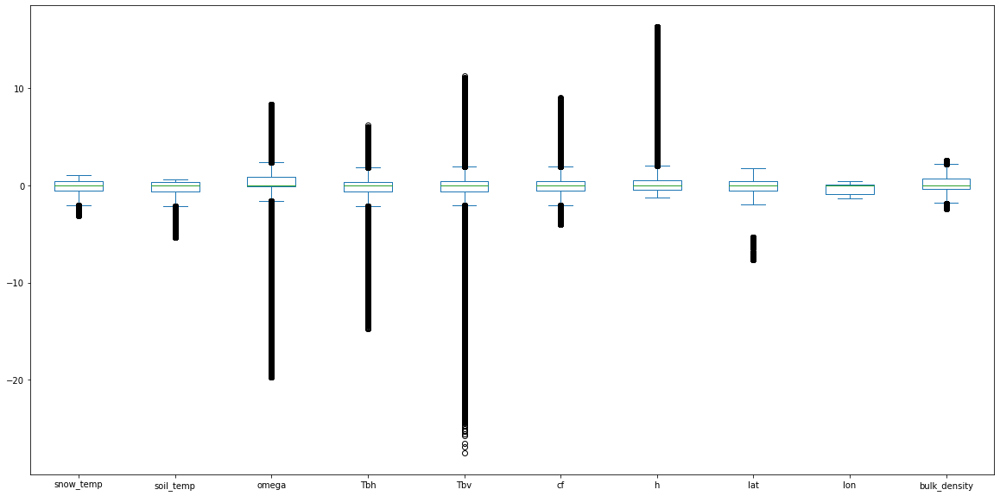

In [150]:
X_train_scaled.plot(kind='box', figsize=(20, 10))

#### Standard

In [196]:
scaler = StandardScaler() 

#### Take 2019 and do train, val and test split

In [98]:
df1 = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [99]:
df1.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,268.206835,273.037231,0.077934,250.853485,255.755310,0.167626,1.250319,0.959070,62.684110,-160.44087,01_01_2019,0.360216
1,161.904102,270.752674,272.944916,0.078347,252.357315,255.754684,0.170824,1.239644,0.973190,62.532246,-160.44087,01_01_2019,0.343348
2,163.183896,270.971431,272.960205,0.079091,254.316711,257.457397,0.176738,1.237796,0.997815,62.381150,-160.44087,01_01_2019,0.363338
3,164.070027,271.314168,272.987762,0.079008,254.165604,258.057922,0.165714,1.237237,0.981988,62.230810,-160.44087,01_01_2019,0.360973
4,158.706063,269.161864,272.945801,0.079000,250.542023,254.916229,0.166220,1.237293,0.953300,62.684110,-160.34750,01_01_2019,0.359798


In [100]:
X = df1[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]
y = df1['snow_density']

In [101]:
X_scaled = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)

In [102]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.20, shuffle=True, random_state=0)

In [103]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
17720940,0.365254,0.645153,0.241296,0.668387,0.397419,-0.251514,-0.865250,0.583841,-1.499111,0.341554,-0.192260
11233780,1.116670,0.677221,0.330183,0.636686,0.714745,-1.011708,0.828445,0.623352,-1.671083,-0.637564,-0.634434
2485422,0.618709,-0.041689,0.195653,-1.341671,-2.173358,0.011701,5.464479,-0.475251,-1.255484,0.811133,0.015912
1154291,-1.210042,-0.389393,0.195653,0.372415,0.058530,0.393502,0.122082,0.040915,0.911184,-0.798271,-0.576719
6723943,-0.470293,0.356774,0.243757,-0.338419,-0.910164,1.059015,-1.048926,0.212856,-1.348636,0.552140,-0.040260


In [104]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
8175713,-0.184082,0.322982,0.195653,0.572746,0.402523,0.107029,0.617134,0.443027,0.925515,-0.490250,-0.054100
18055958,0.180086,0.485908,0.235403,-0.105776,-0.389788,0.614961,-1.353746,0.443027,-1.419395,0.204105,-0.482511
4853484,-0.553029,0.970923,0.570943,0.510220,0.484256,1.688652,-0.740254,-0.313284,-1.184725,0.145121,1.845136
16883108,-1.554717,0.640625,0.203471,1.029535,0.566266,0.165033,0.676760,0.271984,0.833259,-0.382975,-0.268360
44884,-0.144300,-0.379995,-3.115520,-1.304325,-0.205562,-2.489160,-0.907370,-1.137702,0.498272,2.060052,-0.883056


#### Take whole of 2019 as train and whole 2020 as test

In [197]:
df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']] = scaler.fit_transform(df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']])


In [198]:
df.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,1.113262,1.073475,0.569779,0.327774,0.103444,-0.025829,0.983535,-0.759116,0.789650,-1.796875,01_01_2019,0.020741
1,161.904102,1.400972,1.050109,0.589497,0.446137,0.103376,0.042764,0.960934,-0.672687,0.775604,-1.796875,01_01_2019,-0.022064
2,163.183896,1.425694,1.053979,0.624992,0.600355,0.287561,0.169587,0.957021,-0.521954,0.761629,-1.796875,01_01_2019,0.028663
3,164.070027,1.464427,1.060954,0.621048,0.588462,0.352520,-0.066834,0.955837,-0.618830,0.747724,-1.796875,01_01_2019,0.022662
4,158.706063,1.221191,1.050333,0.620654,0.303260,0.012680,-0.055986,0.955955,-0.794435,0.789650,-1.796006,01_01_2019,0.019681


In [199]:
train = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [200]:
train.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,1.113262,1.073475,0.569779,0.327774,0.103444,-0.025829,0.983535,-0.759116,0.789650,-1.796875,01_01_2019,0.020741
1,161.904102,1.400972,1.050109,0.589497,0.446137,0.103376,0.042764,0.960934,-0.672687,0.775604,-1.796875,01_01_2019,-0.022064
2,163.183896,1.425694,1.053979,0.624992,0.600355,0.287561,0.169587,0.957021,-0.521954,0.761629,-1.796875,01_01_2019,0.028663
3,164.070027,1.464427,1.060954,0.621048,0.588462,0.352520,-0.066834,0.955837,-0.618830,0.747724,-1.796875,01_01_2019,0.022662
4,158.706063,1.221191,1.050333,0.620654,0.303260,0.012680,-0.055986,0.955955,-0.794435,0.789650,-1.796006,01_01_2019,0.019681


In [201]:
X_train = train[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]
y_train = train['snow_density']

In [202]:
test = df[df["date"].apply(lambda x: x.split('_')[2] == '2020')]

In [203]:
test.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,-0.750608,0.895647,0.313434,0.321851,0.300468,-0.031529,0.740869,-1.750119,0.747724,-1.818588,01_01_2020,-0.546762
18329588,176.776952,-0.730265,0.823541,0.413870,0.099469,-0.061708,0.311154,0.560089,-1.455303,0.733888,-1.818588,01_01_2020,0.048865
18329589,181.312867,-0.816404,0.325752,0.407721,0.305540,0.418985,-0.101600,0.585237,-1.283617,0.747724,-1.815982,01_01_2020,2.120085
18329590,183.489251,-0.852478,0.589527,0.369116,0.403837,0.534498,-0.379240,0.724243,-1.474913,0.761629,-1.815114,01_01_2020,0.038652
18329591,182.247955,-0.985826,-0.194500,0.408846,-0.033579,-0.060477,0.652284,0.391080,-0.874631,0.720118,-1.813377,01_01_2020,-0.275624


In [204]:
X_test = test[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]
y_test = test['snow_density']

In [205]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
0,1.113262,1.073475,0.569779,0.327774,0.103444,-0.025829,0.983535,0.789650,-1.796875,-0.759116,0.020741
1,1.400972,1.050109,0.589497,0.446137,0.103376,0.042764,0.960934,0.775604,-1.796875,-0.672687,-0.022064
2,1.425694,1.053979,0.624992,0.600355,0.287561,0.169587,0.957021,0.761629,-1.796875,-0.521954,0.028663
3,1.464427,1.060954,0.621048,0.588462,0.352520,-0.066834,0.955837,0.747724,-1.796875,-0.618830,0.022662
4,1.221191,1.050333,0.620654,0.303260,0.012680,-0.055986,0.955955,0.789650,-1.796006,-0.794435,0.019681


In [206]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
18329587,-0.750608,0.895647,0.313434,0.321851,0.300468,-0.031529,0.740869,0.747724,-1.818588,-1.750119,-0.546762
18329588,-0.730265,0.823541,0.413870,0.099469,-0.061708,0.311154,0.560089,0.733888,-1.818588,-1.455303,0.048865
18329589,-0.816404,0.325752,0.407721,0.305540,0.418985,-0.101600,0.585237,0.747724,-1.815982,-1.283617,2.120085
18329590,-0.852478,0.589527,0.369116,0.403837,0.534498,-0.379240,0.724243,0.761629,-1.815114,-1.474913,0.038652
18329591,-0.985826,-0.194500,0.408846,-0.033579,-0.060477,0.652284,0.391080,0.720118,-1.813377,-0.874631,-0.275624


<AxesSubplot:>

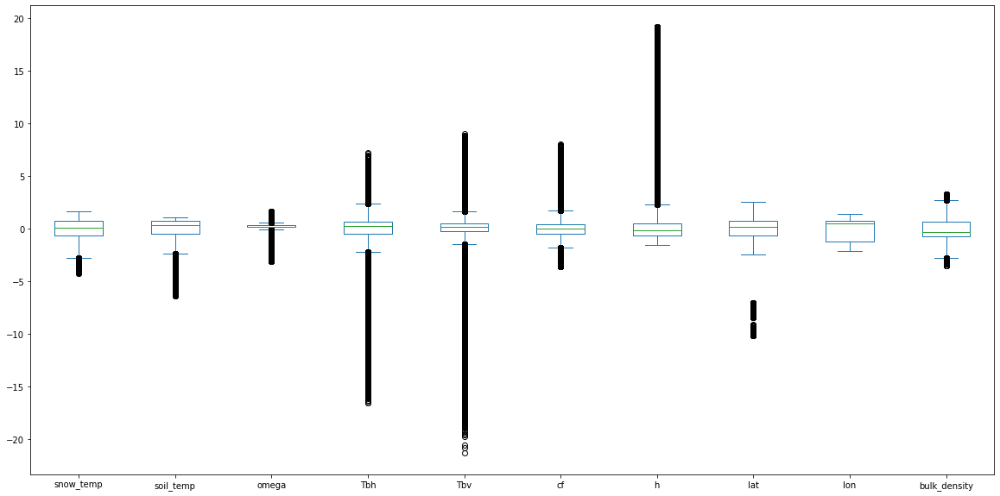

In [296]:
X_train_scaled.plot(kind='box', figsize=(20, 10))

## Actual Data Projection

In [56]:
org = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

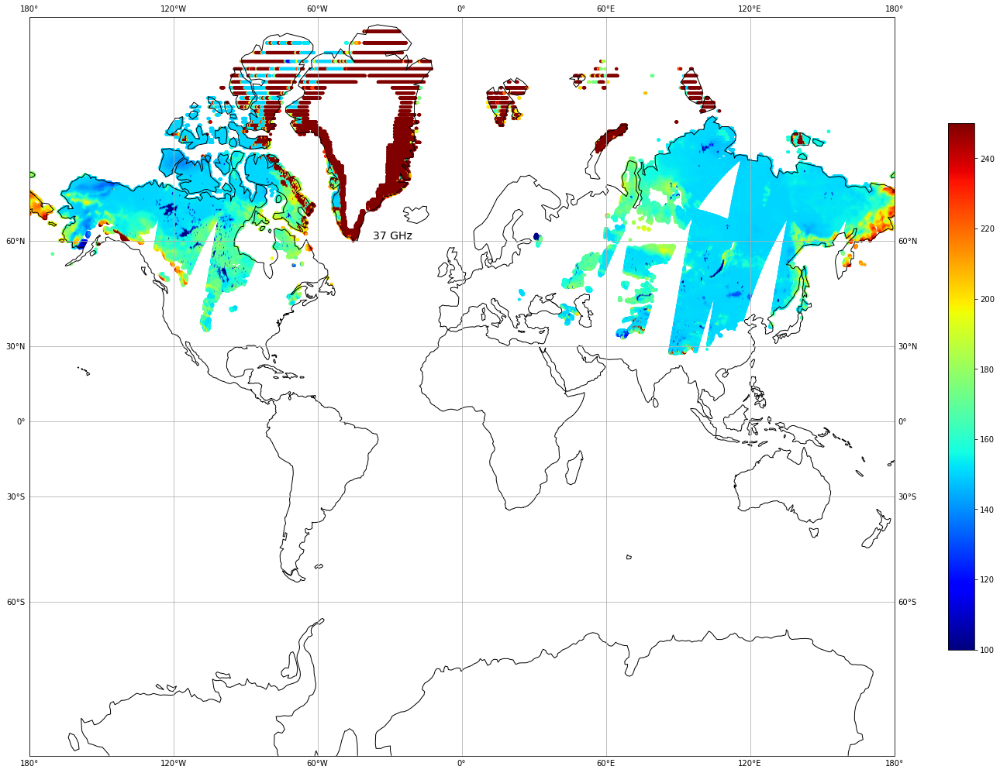

In [64]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(org["lon"], org["lat"], c=org["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

# Model Training

## Decision Tree Regressor

### 2019 as Train/Test

#### Original Data

In [515]:
model = DecisionTreeRegressor(random_state=0) 

In [516]:
%%time
model.fit(X_train, y_train)

CPU times: total: 6min 17s
Wall time: 7min 43s


DecisionTreeRegressor(random_state=0)

In [517]:
model.score(X_train, y_train)

1.0

In [518]:
model.score(X_test, y_test)

0.8748825129049368

In [519]:
with open("Models\\DTR\\sd_with_vod_dtr_model_org_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(model, file)

In [520]:
y_pred = model.predict(X_test)

In [521]:
mae = mean_absolute_error(y_test, y_pred)
mae

5.74934312366881

In [522]:
mse = mean_squared_error(y_test, y_pred)
mse

224.25542285382994

In [523]:
rmse = mse**(1/2.0)
rmse

14.975160194596581

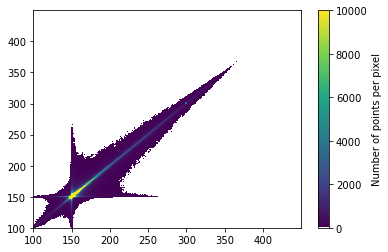

In [524]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [525]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [527]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [534]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]

In [535]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [537]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [538]:
y_sample_pred = model.predict(X_sample)

In [539]:
X_sample["snow_density"] = y_sample_pred

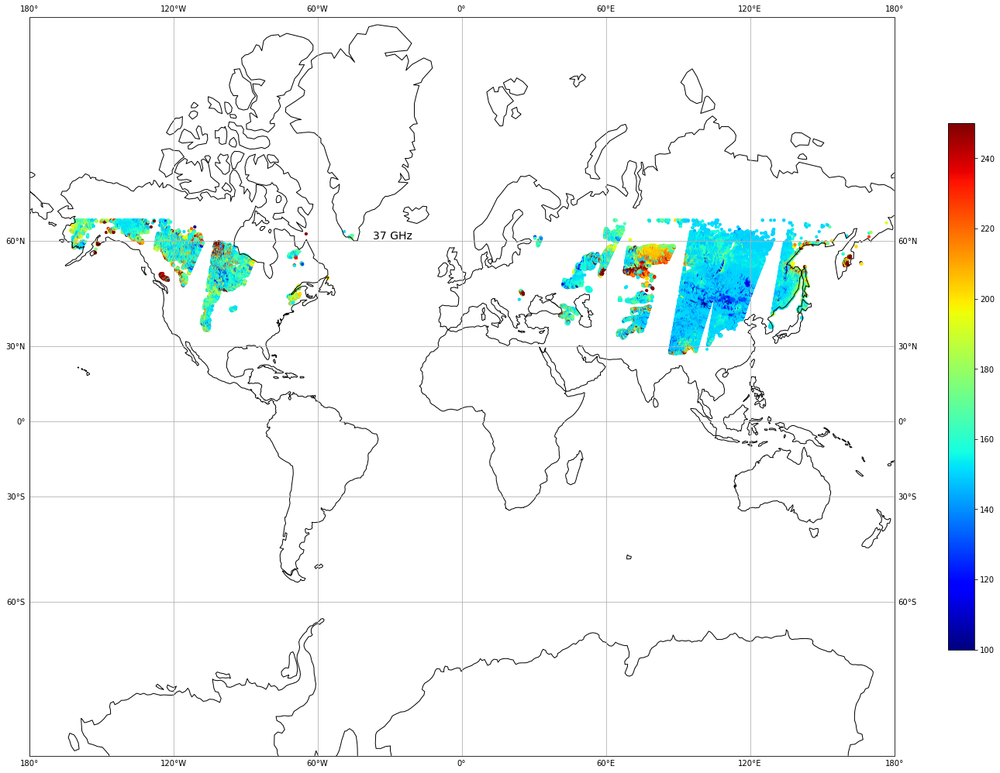

In [540]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

In [ ]:
import plotly.express as px
fig = px.density_mapbox(predict_sample, lat='lat', lon='lon', z='snow_density', radius=1, color_continuous_scale='Blues',
                        center=dict(lat=0, lon=180), zoom=0,
                        mapbox_style="open-street-map")
fig.show()

#### MinMax Scaled

In [49]:
model = DecisionTreeRegressor(random_state=0) 

In [50]:
%%time
model.fit(X_train, y_train)

CPU times: total: 5min 29s
Wall time: 8min 27s


DecisionTreeRegressor(random_state=0)

In [51]:
model.score(X_train, y_train)

1.0

In [52]:
model.score(X_test, y_test)

0.8749211489341748

In [53]:
with open("Models\\DTR\\sd_with_vod_dtr_model_min_max_scaled_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(model, file)

In [54]:
y_pred = model.predict(X_test)

In [55]:
mae = mean_absolute_error(y_test, y_pred)
mae

5.748040139214722

In [56]:
mse = mean_squared_error(y_test, y_pred)
mse

224.18617322873496

In [57]:
rmse = mse**(1/2.0)
rmse

14.972847866345766

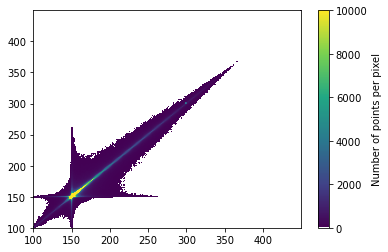

In [58]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [59]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [60]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [61]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]

In [62]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [63]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [64]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [65]:
y_sample_pred = model.predict(X_sample_scaled)

In [66]:
X_sample["snow_density"] = y_sample_pred

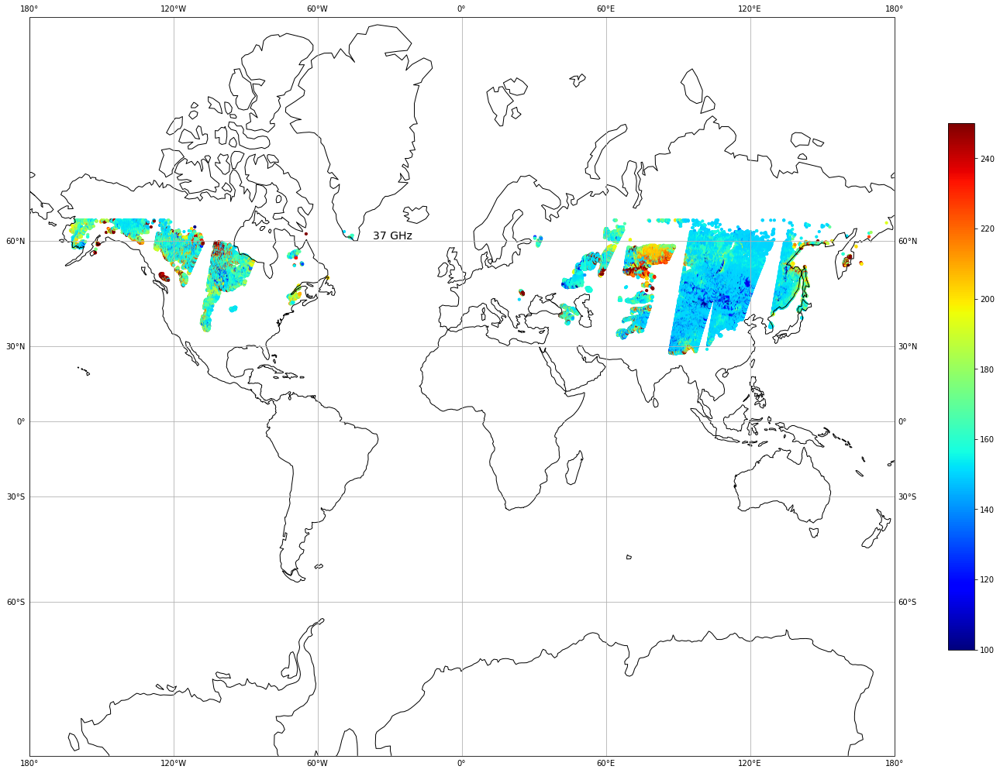

In [67]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

#### Robust Scaled

In [78]:
model = DecisionTreeRegressor(random_state=0) 

In [79]:
%%time
model.fit(X_train, y_train)

CPU times: total: 5min 38s
Wall time: 8min 51s


DecisionTreeRegressor(random_state=0)

In [80]:
model.score(X_train, y_train)

1.0

In [81]:
model.score(X_test, y_test)

0.8746948679790867

In [82]:
with open("Models\\DTR\\sd_with_vod_dtr_model_robust_scaled_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(model, file)

In [83]:
y_pred = model.predict(X_test)

In [84]:
mae = mean_absolute_error(y_test, y_pred)
mae

5.7503278111833875

In [85]:
mse = mean_squared_error(y_test, y_pred)
mse

224.591749878692

In [86]:
rmse = mse**(1/2.0)
rmse

14.986385484121646

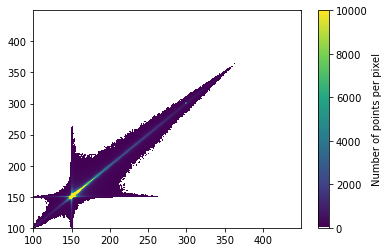

In [87]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [88]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [89]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [90]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]

In [91]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [92]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [93]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [94]:
y_sample_pred = model.predict(X_sample_scaled)

In [95]:
X_sample["snow_density"] = y_sample_pred

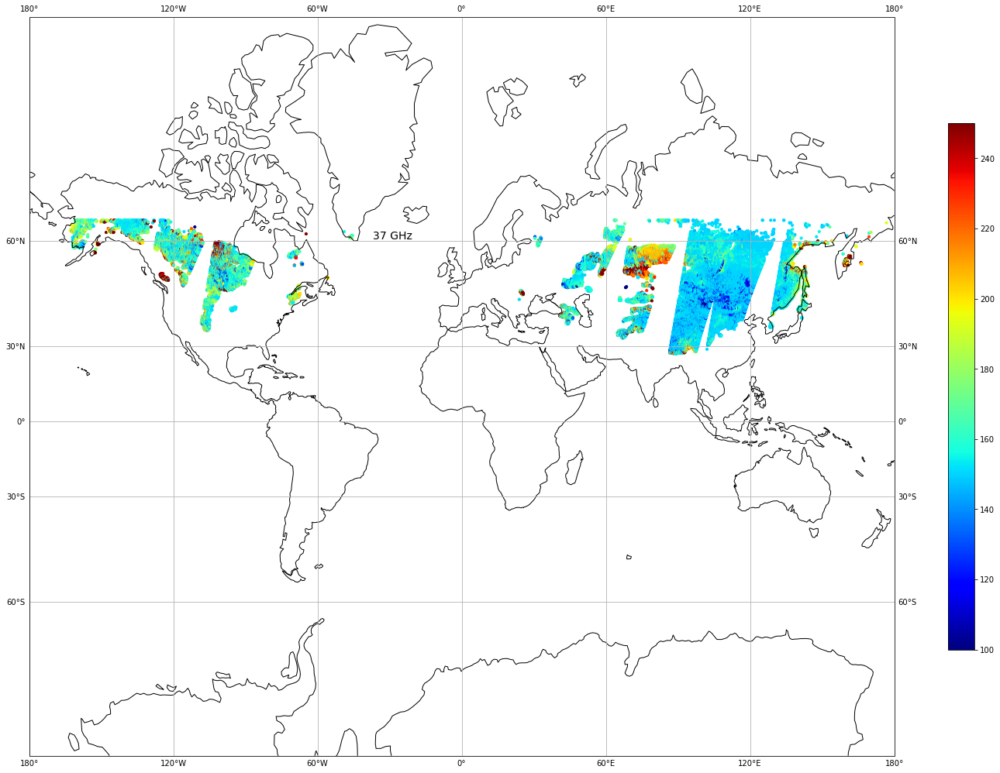

In [96]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

#### Standard Scaled

In [105]:
model = DecisionTreeRegressor(random_state=0) 

In [106]:
%%time
model.fit(X_train, y_train)

CPU times: total: 5min 37s
Wall time: 8min 30s


DecisionTreeRegressor(random_state=0)

In [107]:
model.score(X_train, y_train)

1.0

In [108]:
model.score(X_test, y_test)

0.8749995853599151

In [109]:
with open("Models\\DTR\\sd_with_vod_dtr_model_standard_scaled_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(model, file)

In [110]:
y_pred = model.predict(X_test)

In [111]:
mae = mean_absolute_error(y_test, y_pred)
mae

5.747935524314988

In [112]:
mse = mean_squared_error(y_test, y_pred)
mse

224.04558701469

In [113]:
rmse = mse**(1/2.0)
rmse

14.968152424888316

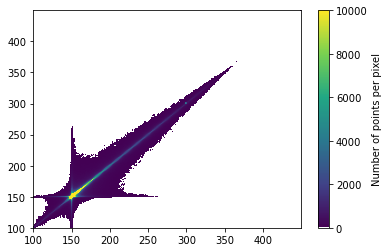

In [114]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [115]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [116]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [117]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]

In [118]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [119]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [120]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [121]:
y_sample_pred = model.predict(X_sample_scaled)

In [122]:
X_sample["snow_density"] = y_sample_pred

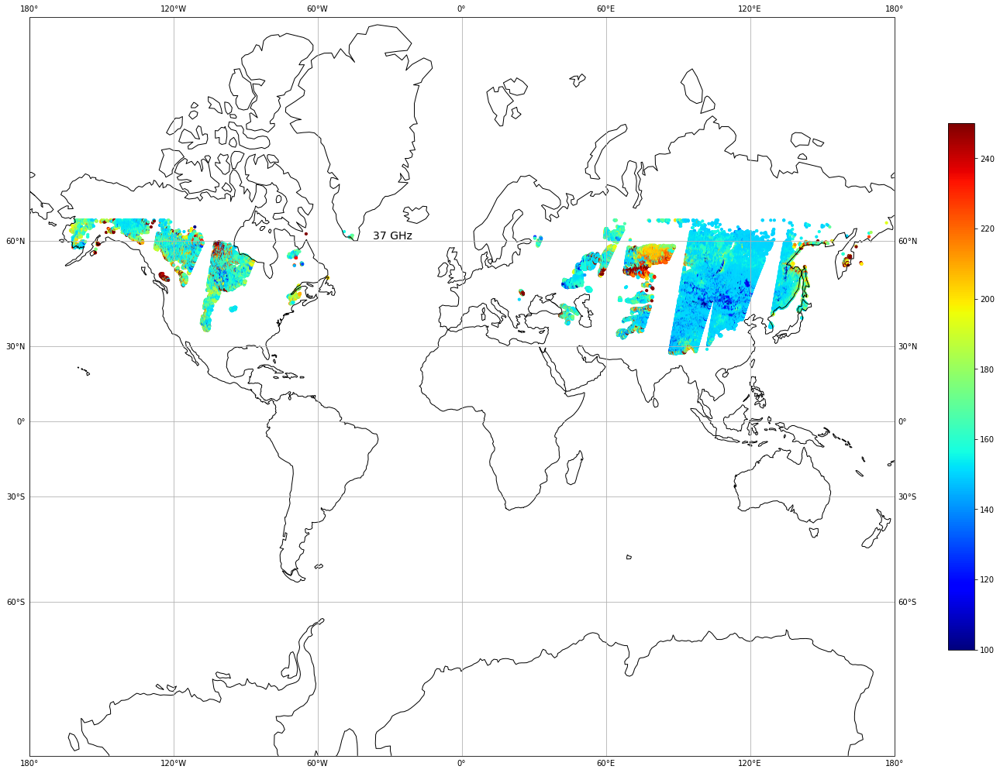

In [123]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

### 2019 as Train and 2020 as Test

#### Original Data

In [585]:
model = DecisionTreeRegressor(random_state=0) 

In [586]:
%%time
model.fit(X_train, y_train)

CPU times: total: 7min 1s
Wall time: 8min 34s


DecisionTreeRegressor(random_state=0)

In [587]:
model.score(X_train, y_train)

1.0

In [588]:
model.score(X_test, y_test)

0.39054371318999315

In [589]:
with open("Models\\DTR\\sd_with_vod_dtr_model_org_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(model, file)

In [590]:
y_pred = model.predict(X_test)

In [591]:
mae = mean_absolute_error(y_test, y_pred)
mae

22.235963954983884

In [592]:
mse = mean_squared_error(y_test, y_pred)
mse

1235.7710976519347

In [593]:
rmse = mse**(1/2.0)
rmse

35.15353606185208

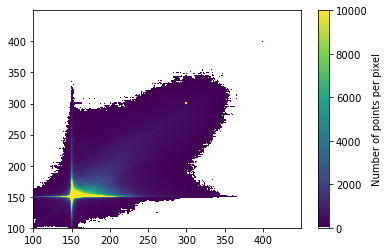

In [594]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [121]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [122]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [595]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]

In [596]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [597]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [598]:
y_sample_pred = model.predict(X_sample)

In [599]:
X_sample["snow_density"] = y_sample_pred

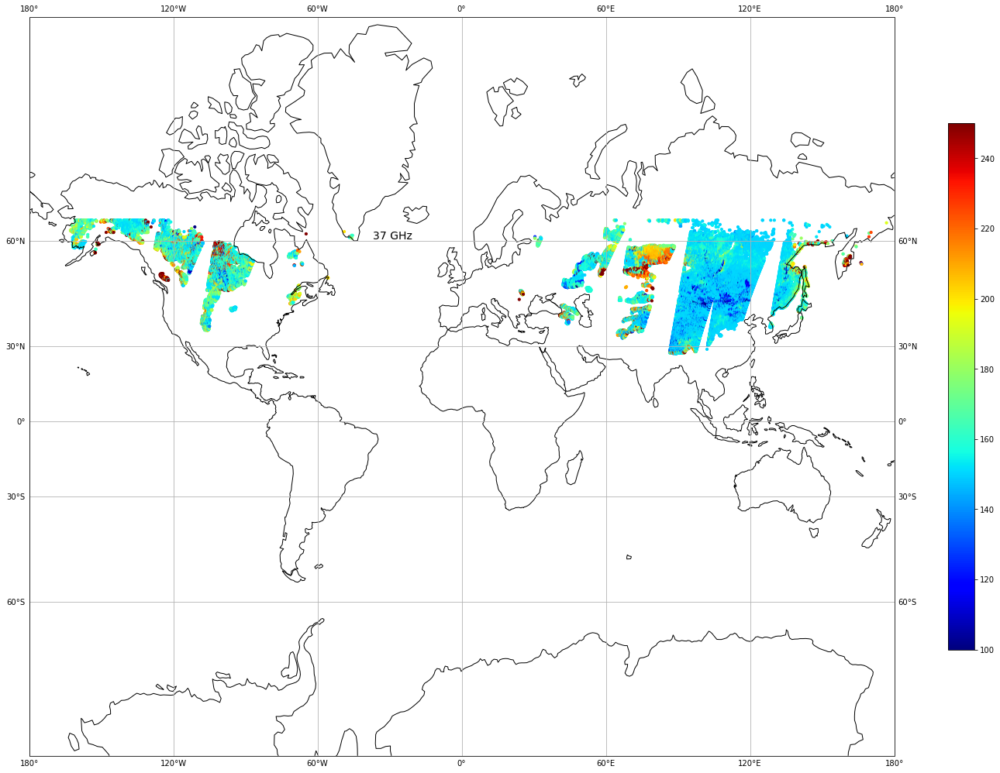

In [600]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

In [ ]:
import plotly.express as px
fig = px.density_mapbox(predict_sample, lat='lat', lon='lon', z='snow_density', radius=1, color_continuous_scale='Blues',
                        center=dict(lat=0, lon=180), zoom=0,
                        mapbox_style="open-street-map")
fig.show()

#### MinMax Scaled

In [139]:
model = DecisionTreeRegressor(random_state=0) 

In [140]:
%%time
model.fit(X_train, y_train)

CPU times: total: 8min 42s
Wall time: 9min 6s


DecisionTreeRegressor(random_state=0)

In [141]:
model.score(X_train, y_train)

1.0

In [142]:
model.score(X_test, y_test)

0.3900057134965834

In [143]:
with open("Models\\DTR\\sd_with_vod_dtr_model_min_max_scaled_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(model, file)

In [144]:
y_pred = model.predict(X_test)

In [145]:
mae = mean_absolute_error(y_test, y_pred)
mae

22.243505128582626

In [146]:
mse = mean_squared_error(y_test, y_pred)
mse

1236.861978960488

In [147]:
rmse = mse**(1/2.0)
rmse

35.16904859333684

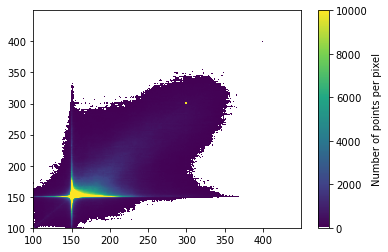

In [148]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [149]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [150]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [151]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]

In [152]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [153]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [154]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [155]:
y_sample_pred = model.predict(X_sample_scaled)

In [156]:
X_sample["snow_density"] = y_sample_pred

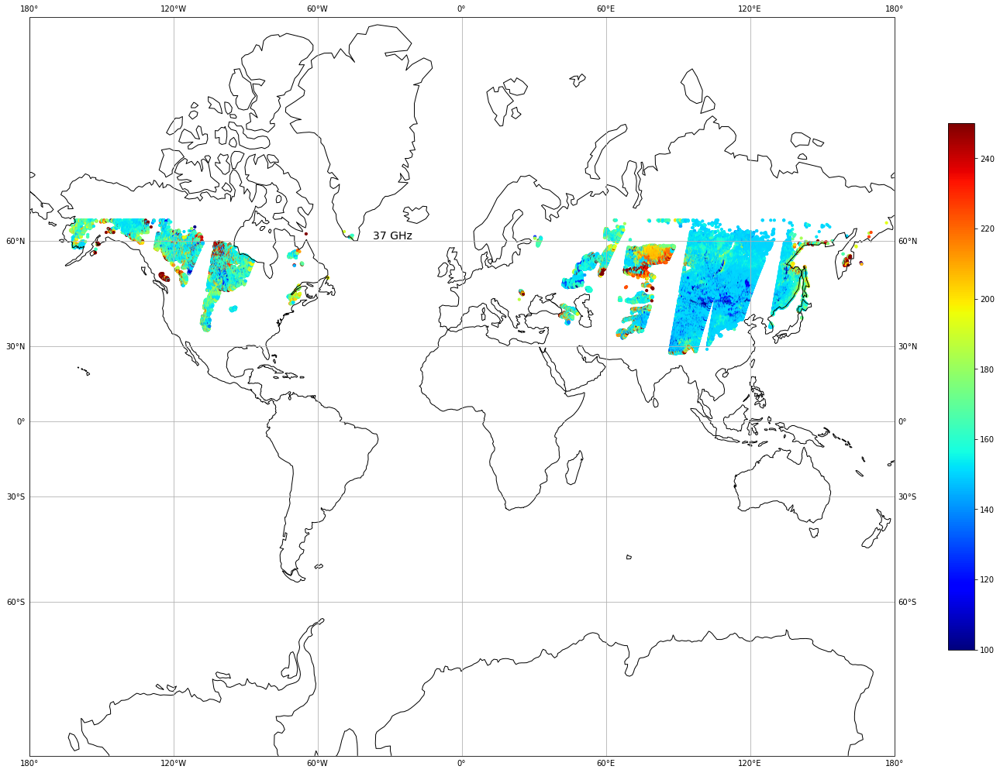

In [157]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

#### Robust Scaled

In [173]:
model = DecisionTreeRegressor(random_state=0) 

In [174]:
%%time
model.fit(X_train, y_train)

CPU times: total: 7min 51s
Wall time: 9min 19s


DecisionTreeRegressor(random_state=0)

In [175]:
model.score(X_train, y_train)

1.0

In [176]:
model.score(X_test, y_test)

0.3900434464075462

In [177]:
with open("Models\\DTR\\sd_with_vod_dtr_model_robust_scaled_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(model, file)

In [178]:
y_pred = model.predict(X_test)

In [179]:
mae = mean_absolute_error(y_test, y_pred)
mae

22.242548856319186

In [180]:
mse = mean_squared_error(y_test, y_pred)
mse

1236.7854693866152

In [181]:
rmse = mse**(1/2.0)
rmse

35.16796083634386

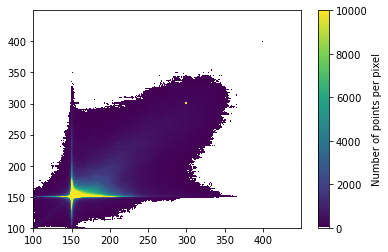

In [182]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [183]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [184]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [185]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]

In [186]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [187]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [188]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [189]:
y_sample_pred = model.predict(X_sample_scaled)

In [190]:
X_sample["snow_density"] = y_sample_pred

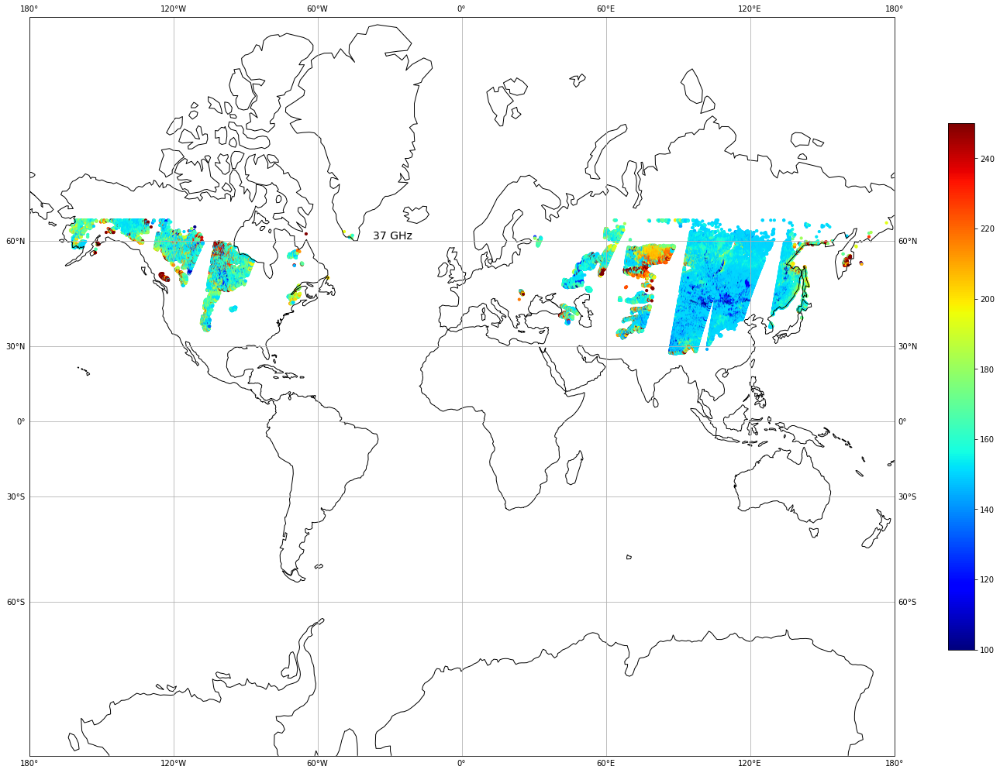

In [191]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

#### Standard Scaled

In [207]:
model = DecisionTreeRegressor(random_state=0) 

In [208]:
%%time
model.fit(X_train, y_train)

CPU times: total: 8min 50s
Wall time: 9min 12s


DecisionTreeRegressor(random_state=0)

In [209]:
model.score(X_train, y_train)

1.0

In [210]:
model.score(X_test, y_test)

0.3907607841035292

In [211]:
with open("Models\\DTR\\sd_with_vod_dtr_model_standard_scaled_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(model, file)

In [212]:
y_pred = model.predict(X_test)

In [213]:
mae = mean_absolute_error(y_test, y_pred)
mae

22.235907485284628

In [214]:
mse = mean_squared_error(y_test, y_pred)
mse

1235.3309513003517

In [215]:
rmse = mse**(1/2.0)
rmse

35.1472751618152

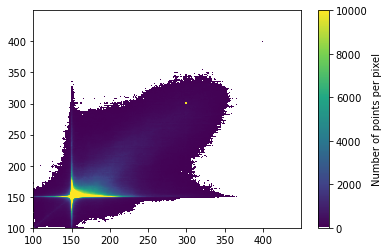

In [216]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [217]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [218]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [219]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]

In [220]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [221]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [222]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [223]:
y_sample_pred = model.predict(X_sample_scaled)

In [224]:
X_sample["snow_density"] = y_sample_pred

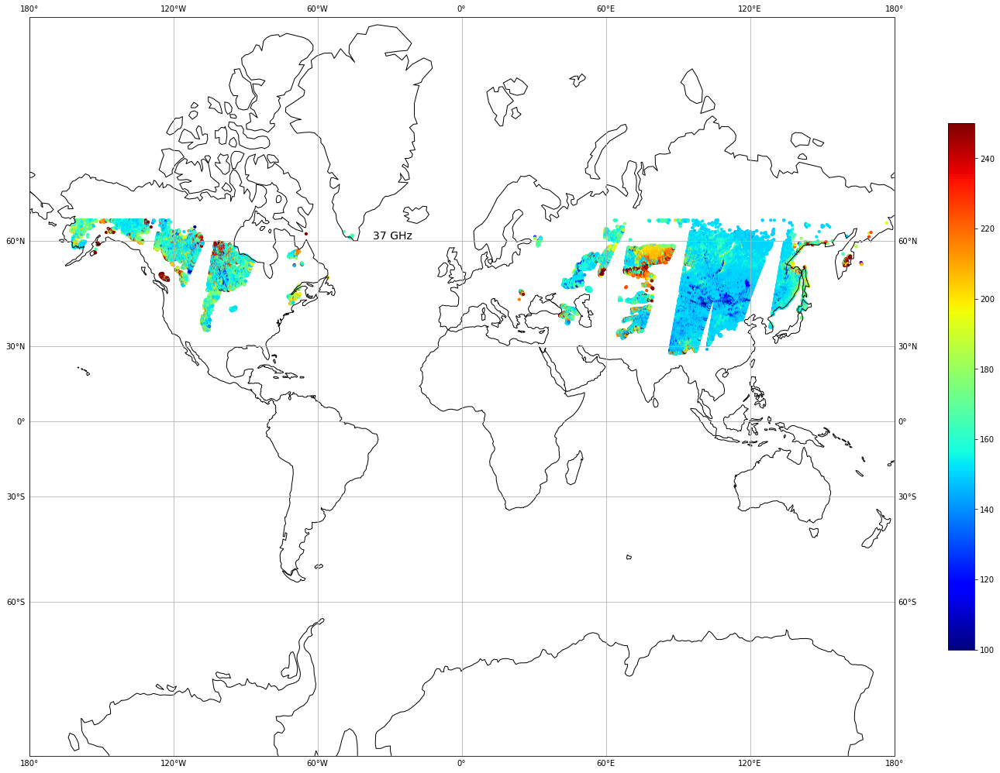

In [225]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

## Random Forest Regressor

### 2019 as Train/Test

In [9]:
base_model = RandomForestRegressor(n_estimators=10, random_state=0)

In [14]:
%%time
base_model.fit(X_train, y_train)

CPU times: total: 40min 11s
Wall time: 51min 23s


RandomForestRegressor(n_estimators=10, random_state=0)

In [15]:
base_model.score(X_train, y_train)

0.9875420391542945

In [16]:
base_model.score(X_test, y_test)

0.9347138789784056

In [17]:
y_pred = base_model.predict(X_test)

In [18]:
mae = mean_absolute_error(y_test, y_pred)
mae

5.218723936478184

In [19]:
mse = mean_squared_error(y_test, y_pred)
mse

117.01615030886957

In [20]:
rmse = mse**(1/2.0)
rmse

10.817400348922543

In [21]:
with open("Models\\RFR\\sd_with_vod_rfr_base_model_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(base_model, file)

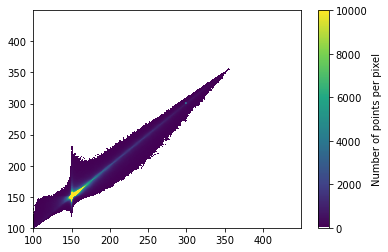

In [22]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [23]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [24]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [25]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]

In [26]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [27]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [28]:
y_sample_pred = base_model.predict(X_sample)

In [29]:
X_sample["snow_density"] = y_sample_pred

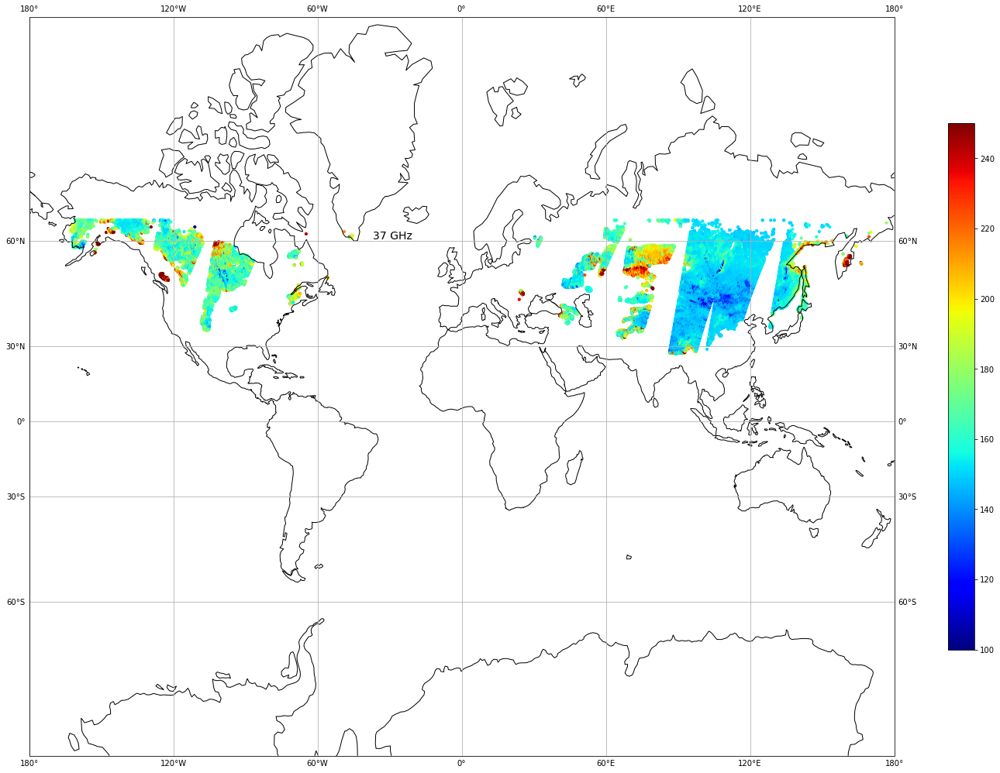

In [30]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

### 2019 as Train and 2020 as Test

In [37]:
base_model_2019_train = RandomForestRegressor(n_estimators=10, random_state=0)

In [38]:
%%time
base_model_2019_train.fit(X_train, y_train)

CPU times: total: 46min 54s
Wall time: 59min 44s


RandomForestRegressor(n_estimators=10, random_state=0)

In [39]:
base_model_2019_train.score(X_train, y_train)

0.9886865564598227

In [40]:
base_model_2019_train.score(X_test, y_test)

0.533668712285563

In [41]:
y_pred = base_model_2019_train.predict(X_test)

In [42]:
mae = mean_absolute_error(y_test, y_pred)
mae

19.735970602055996

In [43]:
mse = mean_squared_error(y_test, y_pred)
mse

945.562035801856

In [44]:
rmse = mse**(1/2.0)
rmse

30.749992452061772

In [45]:
with open("Models\\RFR\\sd_with_vod_rfr_base_model_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(base_model_2019_train, file)

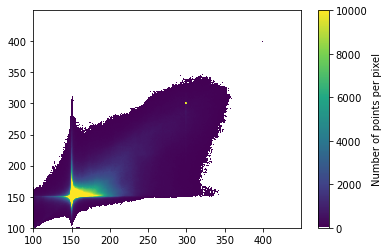

In [46]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [47]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [48]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [49]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'vod']]

In [50]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [51]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [52]:
y_sample_pred = base_model_2019_train.predict(X_sample)

In [53]:
X_sample["snow_density"] = y_sample_pred

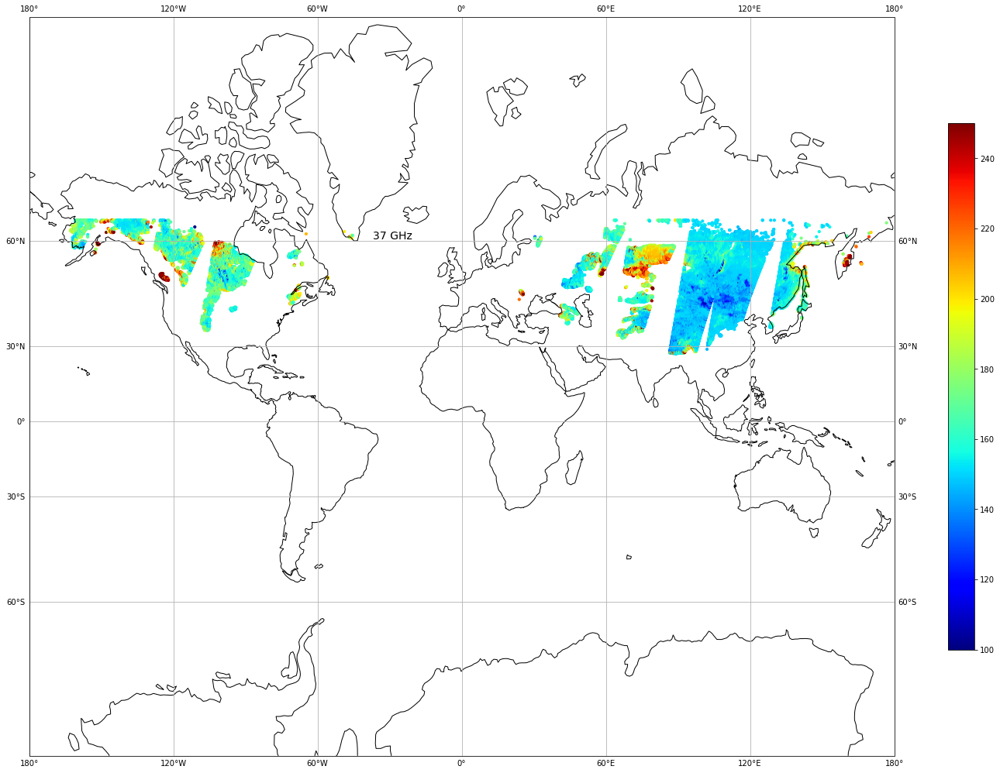

In [54]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["snow_density"], vmin=100, vmax=250, cmap='jet', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

# VOD with Snow Density

## Dataset Split

#### Random Test Train Split on only 2019

In [129]:
df1 = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [130]:
X = df1[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]
y = df1['vod']

In [131]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, shuffle=True, random_state=0)

#### Train 2019, Test 2020

In [483]:
train = pd.read_csv(os.path.join(dir_path, "train.csv"))

In [22]:
train = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [23]:
train.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,268.206835,273.037231,0.077934,250.853485,255.755310,0.167626,1.250319,0.959070,62.684110,-160.44087,01_01_2019,0.360216
1,161.904102,270.752674,272.944916,0.078347,252.357315,255.754684,0.170824,1.239644,0.973190,62.532246,-160.44087,01_01_2019,0.343348
2,163.183896,270.971431,272.960205,0.079091,254.316711,257.457397,0.176738,1.237796,0.997815,62.381150,-160.44087,01_01_2019,0.363338
3,164.070027,271.314168,272.987762,0.079008,254.165604,258.057922,0.165714,1.237237,0.981988,62.230810,-160.44087,01_01_2019,0.360973
4,158.706063,269.161864,272.945801,0.079000,250.542023,254.916229,0.166220,1.237293,0.953300,62.684110,-160.34750,01_01_2019,0.359798


In [24]:
X_train = train[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]
y_train = train['vod']

In [25]:
test = pd.read_csv(os.path.join(dir_path, "test.csv"))

In [26]:
test = df[df["date"].apply(lambda x: x.split('_')[2] == '2020')]

In [27]:
test.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,179.471841,251.714131,272.334656,0.072562,250.778229,257.576721,0.167360,1.135705,0.797174,62.230810,-162.77490,01_01_2020,0.136579
18329588,176.776952,251.894138,272.049774,0.074667,247.952805,254.228546,0.183340,1.050320,0.845337,62.081207,-162.77490,01_01_2020,0.371299
18329589,181.312867,251.131931,270.083069,0.074538,250.570999,258.672363,0.164092,1.062198,0.873384,62.230810,-162.49481,01_01_2020,1.187509
18329590,183.489251,250.812725,271.125214,0.073729,251.819885,259.740234,0.151145,1.127852,0.842133,62.381150,-162.40146,01_01_2020,0.367274
18329591,182.247955,249.632770,268.027618,0.074561,246.262390,254.239929,0.199248,0.970495,0.940199,61.932335,-162.21474,01_01_2020,0.243427


In [28]:
X_test = test[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]
y_test = test['vod']

## Trying Scaling Techniques

#### MinMax

In [10]:
scaler = MinMaxScaler() 

#### Take 2019 and do train, val and test split

In [ ]:
df1 = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [232]:
df1.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,268.206835,273.037231,0.077934,250.853485,255.755310,0.167626,1.250319,0.959070,62.684110,-160.44087,01_01_2019,0.360216
1,161.904102,270.752674,272.944916,0.078347,252.357315,255.754684,0.170824,1.239644,0.973190,62.532246,-160.44087,01_01_2019,0.343348
2,163.183896,270.971431,272.960205,0.079091,254.316711,257.457397,0.176738,1.237796,0.997815,62.381150,-160.44087,01_01_2019,0.363338
3,164.070027,271.314168,272.987762,0.079008,254.165604,258.057922,0.165714,1.237237,0.981988,62.230810,-160.44087,01_01_2019,0.360973
4,158.706063,269.161864,272.945801,0.079000,250.542023,254.916229,0.166220,1.237293,0.953300,62.684110,-160.34750,01_01_2019,0.359798


In [233]:
X = df1[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]
y = df1['vod']

In [234]:
X_scaled = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)

In [235]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.20, shuffle=True, random_state=0)

In [236]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
17720940,0.781561,0.941262,0.709649,0.723646,0.716712,0.285109,0.034816,0.843425,0.171725,0.571699,0.151176
11233780,0.907268,0.945543,0.728440,0.722316,0.727172,0.219747,0.116229,0.846516,0.121920,0.428076,0.612096
2485422,0.823962,0.849550,0.700000,0.639282,0.631964,0.307740,0.339076,0.760573,0.242283,0.640580,0.143646
1154291,0.518025,0.803122,0.700000,0.711224,0.705540,0.340568,0.082276,0.800952,0.869780,0.404503,0.148200
6723943,0.641780,0.902755,0.710169,0.681389,0.673606,0.397789,0.025987,0.814403,0.215305,0.602589,0.181608


In [237]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
8175713,0.689661,0.898243,0.700000,0.719632,0.716880,0.315937,0.106072,0.832409,0.873930,0.449685,0.203013
18055958,0.750584,0.919998,0.708403,0.691154,0.690761,0.359609,0.011335,0.832409,0.194812,0.551537,0.167756
4853484,0.627939,0.984761,0.779338,0.717008,0.719574,0.451925,0.040825,0.773244,0.262776,0.542885,0.093778
16883108,0.460363,0.940657,0.701653,0.738804,0.722278,0.320924,0.108938,0.819029,0.847211,0.465421,0.146549
44884,0.696316,0.804377,0.000000,0.640849,0.696834,0.092715,0.032792,0.708750,0.750195,0.823778,0.148178


#### Take whole of 2019 as train and whole 2020 as test

In [11]:
df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']] = scaler.fit_transform(df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']])


In [12]:
df.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,0.166630,0.908916,0.998302,0.779338,0.710750,0.708752,0.305672,0.124832,0.408674,0.863969,0.054215,01_01_2019,0.360216
1,0.176869,0.955726,0.995804,0.783470,0.715650,0.708749,0.311526,0.123756,0.421018,0.862857,0.054215,01_01_2019,0.343348
2,0.180525,0.959748,0.996218,0.790908,0.722035,0.714708,0.322348,0.123569,0.442547,0.861749,0.054215,01_01_2019,0.363338
3,0.183057,0.966050,0.996963,0.790081,0.721543,0.716810,0.302173,0.123513,0.428711,0.860648,0.054215,01_01_2019,0.360973
4,0.167732,0.926476,0.995828,0.789999,0.709735,0.705815,0.303099,0.123518,0.403630,0.863969,0.054475,01_01_2019,0.359798


In [13]:
train = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [14]:
train.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,0.166630,0.908916,0.998302,0.779338,0.710750,0.708752,0.305672,0.124832,0.408674,0.863969,0.054215,01_01_2019,0.360216
1,0.176869,0.955726,0.995804,0.783470,0.715650,0.708749,0.311526,0.123756,0.421018,0.862857,0.054215,01_01_2019,0.343348
2,0.180525,0.959748,0.996218,0.790908,0.722035,0.714708,0.322348,0.123569,0.442547,0.861749,0.054215,01_01_2019,0.363338
3,0.183057,0.966050,0.996963,0.790081,0.721543,0.716810,0.302173,0.123513,0.428711,0.860648,0.054215,01_01_2019,0.360973
4,0.167732,0.926476,0.995828,0.789999,0.709735,0.705815,0.303099,0.123518,0.403630,0.863969,0.054475,01_01_2019,0.359798


In [15]:
X_train = train[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]
y_train = train['vod']

In [16]:
test = df[df["date"].apply(lambda x: x.split('_')[2] == '2020')]

In [17]:
test.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,0.227062,0.605666,0.979289,0.725619,0.710505,0.715126,0.305186,0.113270,0.267135,0.860648,0.047730,01_01_2020,0.136579
18329588,0.219363,0.608976,0.971580,0.746666,0.701298,0.703409,0.334429,0.104657,0.309242,0.859552,0.047730,01_01_2020,0.371299
18329589,0.232323,0.594961,0.918358,0.745378,0.709829,0.718960,0.299206,0.105855,0.333763,0.860648,0.048508,01_01_2020,1.187509
18329590,0.238541,0.589092,0.946560,0.737288,0.713899,0.722697,0.275514,0.112478,0.306441,0.861749,0.048768,01_01_2020,0.367274
18329591,0.234994,0.567396,0.862735,0.745613,0.695790,0.703448,0.363539,0.096604,0.392176,0.858461,0.049287,01_01_2020,0.243427


In [18]:
X_test = test[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]
y_test = test['vod']

In [19]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
0,0.908916,0.998302,0.779338,0.710750,0.708752,0.305672,0.124832,0.863969,0.054215,0.408674,0.166630
1,0.955726,0.995804,0.783470,0.715650,0.708749,0.311526,0.123756,0.862857,0.054215,0.421018,0.176869
2,0.959748,0.996218,0.790908,0.722035,0.714708,0.322348,0.123569,0.861749,0.054215,0.442547,0.180525
3,0.966050,0.996963,0.790081,0.721543,0.716810,0.302173,0.123513,0.860648,0.054215,0.428711,0.183057
4,0.926476,0.995828,0.789999,0.709735,0.705815,0.303099,0.123518,0.863969,0.054475,0.403630,0.167732


In [20]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
18329587,0.605666,0.979289,0.725619,0.710505,0.715126,0.305186,0.113270,0.860648,0.047730,0.267135,0.227062
18329588,0.608976,0.971580,0.746666,0.701298,0.703409,0.334429,0.104657,0.859552,0.047730,0.309242,0.219363
18329589,0.594961,0.918358,0.745378,0.709829,0.718960,0.299206,0.105855,0.860648,0.048508,0.333763,0.232323
18329590,0.589092,0.946560,0.737288,0.713899,0.722697,0.275514,0.112478,0.861749,0.048768,0.306441,0.238541
18329591,0.567396,0.862735,0.745613,0.695790,0.703448,0.363539,0.096604,0.858461,0.049287,0.392176,0.234994


<AxesSubplot:>

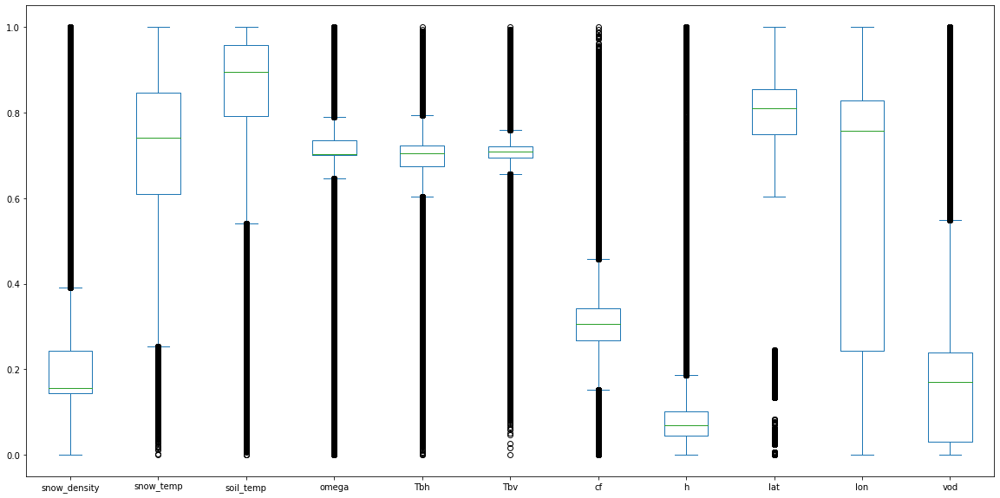

In [224]:
df_minmax_scaled.plot(kind='box', figsize=(20, 10))

#### Robust

In [95]:
scaler = RobustScaler()

#### Take 2019 and do train, val and test split

In [96]:
df1 = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [97]:
df1.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,268.206835,273.037231,0.077934,250.853485,255.755310,0.167626,1.250319,0.959070,62.684110,-160.44087,01_01_2019,0.360216
1,161.904102,270.752674,272.944916,0.078347,252.357315,255.754684,0.170824,1.239644,0.973190,62.532246,-160.44087,01_01_2019,0.343348
2,163.183896,270.971431,272.960205,0.079091,254.316711,257.457397,0.176738,1.237796,0.997815,62.381150,-160.44087,01_01_2019,0.363338
3,164.070027,271.314168,272.987762,0.079008,254.165604,258.057922,0.165714,1.237237,0.981988,62.230810,-160.44087,01_01_2019,0.360973
4,158.706063,269.161864,272.945801,0.079000,250.542023,254.916229,0.166220,1.237293,0.953300,62.684110,-160.34750,01_01_2019,0.359798


In [98]:
X = df1[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]
y = df1['vod']

In [99]:
X_scaled = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)

In [100]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.20, shuffle=True, random_state=0)

In [101]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
17720940,0.168703,0.280450,0.201532,0.392603,0.280260,-0.281963,-0.599797,0.317071,-1.003107,0.451021,-0.058351
11233780,0.699074,0.306066,0.729715,0.364715,0.686521,-1.139818,0.829793,0.346261,-1.088327,-0.254425,4.612597
2485422,0.347599,-0.268204,-0.069685,-1.375717,-3.011007,0.015067,4.742910,-0.465382,-0.882379,0.789349,-0.134659
1154291,-0.943187,-0.545952,-0.069685,0.132225,-0.153606,0.445917,0.233576,-0.084040,0.191300,-0.370214,-0.088512
6723943,-0.421051,0.050091,0.216156,-0.493120,-1.393788,1.196928,-0.754831,0.042989,-0.928540,0.602746,0.250045


In [102]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
8175713,-0.219035,0.023098,-0.069685,0.308464,0.286795,0.122641,0.651433,0.213038,0.198402,-0.148287,0.466972
18055958,0.038006,0.153244,0.166517,-0.288456,-0.727570,0.695827,-1.012120,0.213038,-0.963604,0.351990,0.109671
4853484,-0.479448,0.540678,2.160358,0.253457,0.391435,1.907455,-0.494292,-0.345722,-0.847315,0.309492,-0.640013
16883108,-1.186469,0.276833,-0.023229,0.710317,0.496428,0.188098,0.701761,0.086672,0.152685,-0.070997,-0.105238
44884,-0.190955,-0.538445,-19.745311,-1.342862,-0.491714,-2.807078,-0.635349,-0.954799,-0.013316,1.689184,-0.088731


#### Take whole of 2019 as train and whole 2020 as test

In [46]:
df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']] = scaler.fit_transform(df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']])


In [47]:
df.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,0.012455,0.716902,0.632292,2.066673,0.093482,-0.103660,-0.018768,0.948204,-0.357570,0.493368,-1.173027,01_01_2019,0.360216
1,0.095371,0.924634,0.613351,2.177784,0.199158,-0.103748,0.059500,0.929132,-0.293506,0.482420,-1.173027,01_01_2019,0.343348
2,0.124981,0.942483,0.616488,2.377786,0.336847,0.135919,0.204211,0.925830,-0.181778,0.471527,-1.173027,01_01_2019,0.363338
3,0.145484,0.970449,0.622142,2.355562,0.326229,0.220447,-0.065557,0.924831,-0.253585,0.460689,-1.173027,01_01_2019,0.360973
4,0.021378,0.794829,0.613533,2.353343,0.071595,-0.221765,-0.053179,0.924931,-0.383749,0.493368,-1.172593,01_01_2019,0.359798


In [48]:
train = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [49]:
train.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,0.012455,0.716902,0.632292,2.066673,0.093482,-0.103660,-0.018768,0.948204,-0.357570,0.493368,-1.173027,01_01_2019,0.360216
1,0.095371,0.924634,0.613351,2.177784,0.199158,-0.103748,0.059500,0.929132,-0.293506,0.482420,-1.173027,01_01_2019,0.343348
2,0.124981,0.942483,0.616488,2.377786,0.336847,0.135919,0.204211,0.925830,-0.181778,0.471527,-1.173027,01_01_2019,0.363338
3,0.145484,0.970449,0.622142,2.355562,0.326229,0.220447,-0.065557,0.924831,-0.253585,0.460689,-1.173027,01_01_2019,0.360973
4,0.021378,0.794829,0.613533,2.353343,0.071595,-0.221765,-0.053179,0.924931,-0.383749,0.493368,-1.172593,01_01_2019,0.359798


In [50]:
X_train = train[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]
y_train = train['vod']

In [51]:
test = df[df["date"].apply(lambda x: x.split('_')[2] == '2020')]

In [52]:
test.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,0.501836,-0.628844,0.488143,0.622224,0.088194,0.152715,-0.025272,0.743431,-1.092131,0.460689,-1.183868,01_01_2020,0.136579
18329588,0.439484,-0.614156,0.429693,1.188158,-0.110352,-0.318561,0.365746,0.590880,-0.873605,0.449904,-1.183868,01_01_2020,0.371299
18329589,0.544431,-0.676350,0.026179,1.153509,0.073632,0.306933,-0.105226,0.612101,-0.746346,0.460689,-1.182567,01_01_2020,1.187509
18329590,0.594786,-0.702396,0.239998,0.935977,0.161392,0.457242,-0.422027,0.729401,-0.888140,0.471527,-1.182134,01_01_2020,0.367274
18329591,0.566066,-0.798676,-0.395543,1.159850,-0.229139,-0.316959,0.754991,0.448262,-0.443193,0.439172,-1.181266,01_01_2020,0.243427


In [53]:
X_test = test[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]
y_test = test['vod']

In [54]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
0,0.716902,0.632292,2.066673,0.093482,-0.103660,-0.018768,0.948204,0.493368,-1.173027,-0.357570,0.012455
1,0.924634,0.613351,2.177784,0.199158,-0.103748,0.059500,0.929132,0.482420,-1.173027,-0.293506,0.095371
2,0.942483,0.616488,2.377786,0.336847,0.135919,0.204211,0.925830,0.471527,-1.173027,-0.181778,0.124981
3,0.970449,0.622142,2.355562,0.326229,0.220447,-0.065557,0.924831,0.460689,-1.173027,-0.253585,0.145484
4,0.794829,0.613533,2.353343,0.071595,-0.221765,-0.053179,0.924931,0.493368,-1.172593,-0.383749,0.021378


In [55]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
18329587,-0.628844,0.488143,0.622224,0.088194,0.152715,-0.025272,0.743431,0.460689,-1.183868,-1.092131,0.501836
18329588,-0.614156,0.429693,1.188158,-0.110352,-0.318561,0.365746,0.590880,0.449904,-1.183868,-0.873605,0.439484
18329589,-0.676350,0.026179,1.153509,0.073632,0.306933,-0.105226,0.612101,0.460689,-1.182567,-0.746346,0.544431
18329590,-0.702396,0.239998,0.935977,0.161392,0.457242,-0.422027,0.729401,0.471527,-1.182134,-0.888140,0.594786
18329591,-0.798676,-0.395543,1.159850,-0.229139,-0.316959,0.754991,0.448262,0.439172,-1.181266,-0.443193,0.566066


<AxesSubplot:>

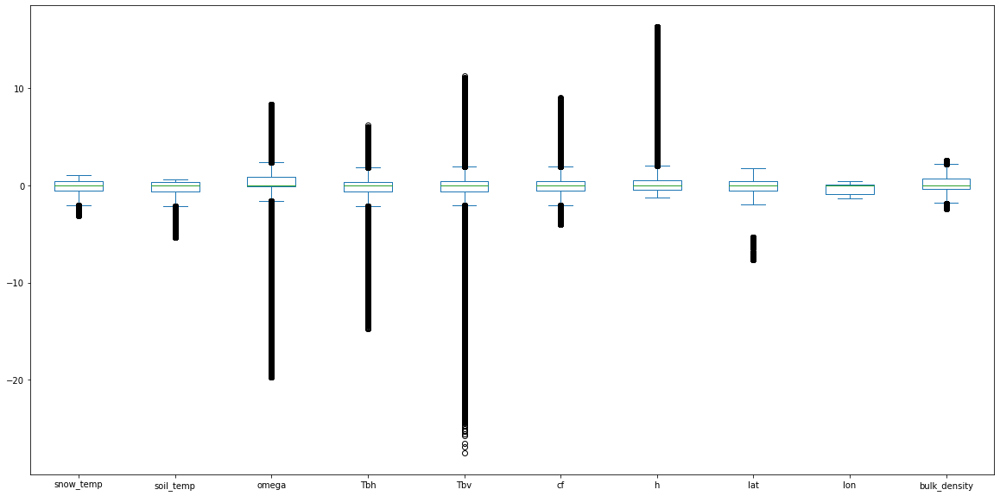

In [150]:
X_train_scaled.plot(kind='box', figsize=(20, 10))

#### Standard

In [127]:
scaler = StandardScaler() 

#### Take 2019 and do train, val and test split

In [299]:
df1 = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [300]:
df1.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,158.320411,268.206835,273.037231,0.077934,250.853485,255.755310,0.167626,1.250319,0.959070,62.684110,-160.44087,01_01_2019,0.360216
1,161.904102,270.752674,272.944916,0.078347,252.357315,255.754684,0.170824,1.239644,0.973190,62.532246,-160.44087,01_01_2019,0.343348
2,163.183896,270.971431,272.960205,0.079091,254.316711,257.457397,0.176738,1.237796,0.997815,62.381150,-160.44087,01_01_2019,0.363338
3,164.070027,271.314168,272.987762,0.079008,254.165604,258.057922,0.165714,1.237237,0.981988,62.230810,-160.44087,01_01_2019,0.360973
4,158.706063,269.161864,272.945801,0.079000,250.542023,254.916229,0.166220,1.237293,0.953300,62.684110,-160.34750,01_01_2019,0.359798


In [301]:
X = df1[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]
y = df1['vod']

In [302]:
X_scaled = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)

In [303]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.20, shuffle=True, random_state=0)

In [304]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
17720940,0.365254,0.645153,0.241296,0.668387,0.397419,-0.251514,-0.865250,0.583841,-1.499111,0.341554,-0.526953
11233780,1.116670,0.677221,0.330183,0.636686,0.714745,-1.011708,0.828445,0.623352,-1.671083,-0.637564,3.285860
2485422,0.618709,-0.041689,0.195653,-1.341671,-2.173358,0.011701,5.464479,-0.475251,-1.255484,0.811133,-0.589241
1154291,-1.210042,-0.389393,0.195653,0.372415,0.058530,0.393502,0.122082,0.040915,0.911184,-0.798271,-0.551573
6723943,-0.470293,0.356774,0.243757,-0.338419,-0.910164,1.059015,-1.048926,0.212856,-1.348636,0.552140,-0.275215


In [305]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
8175713,-0.184082,0.322982,0.195653,0.572746,0.402523,0.107029,0.617134,0.443027,0.925515,-0.490250,-0.098141
18055958,0.180086,0.485908,0.235403,-0.105776,-0.389788,0.614961,-1.353746,0.443027,-1.419395,0.204105,-0.389799
4853484,-0.553029,0.970923,0.570943,0.510220,0.484256,1.688652,-0.740254,-0.313284,-1.184725,0.145121,-1.001753
16883108,-1.554717,0.640625,0.203471,1.029535,0.566266,0.165033,0.676760,0.271984,0.833259,-0.382975,-0.565226
44884,-0.144300,-0.379995,-3.115520,-1.304325,-0.205562,-2.489160,-0.907370,-1.137702,0.498272,2.060052,-0.551751


#### Take whole of 2019 as train and whole 2020 as test

In [128]:
df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']] = scaler.fit_transform(df[['snow_temp', 'soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']])


In [129]:
df.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,-0.464310,1.113262,1.073475,0.569779,0.327774,0.103444,-0.025829,0.983535,-0.759116,0.789650,-1.796875,01_01_2019,0.360216
1,-0.382225,1.400972,1.050109,0.589497,0.446137,0.103376,0.042764,0.960934,-0.672687,0.775604,-1.796875,01_01_2019,0.343348
2,-0.352911,1.425694,1.053979,0.624992,0.600355,0.287561,0.169587,0.957021,-0.521954,0.761629,-1.796875,01_01_2019,0.363338
3,-0.332614,1.464427,1.060954,0.621048,0.588462,0.352520,-0.066834,0.955837,-0.618830,0.747724,-1.796875,01_01_2019,0.360973
4,-0.455477,1.221191,1.050333,0.620654,0.303260,0.012680,-0.055986,0.955955,-0.794435,0.789650,-1.796006,01_01_2019,0.359798


In [130]:
train = df[df["date"].apply(lambda x: x.split('_')[2] == '2019')]

In [131]:
train.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,-0.464310,1.113262,1.073475,0.569779,0.327774,0.103444,-0.025829,0.983535,-0.759116,0.789650,-1.796875,01_01_2019,0.360216
1,-0.382225,1.400972,1.050109,0.589497,0.446137,0.103376,0.042764,0.960934,-0.672687,0.775604,-1.796875,01_01_2019,0.343348
2,-0.352911,1.425694,1.053979,0.624992,0.600355,0.287561,0.169587,0.957021,-0.521954,0.761629,-1.796875,01_01_2019,0.363338
3,-0.332614,1.464427,1.060954,0.621048,0.588462,0.352520,-0.066834,0.955837,-0.618830,0.747724,-1.796875,01_01_2019,0.360973
4,-0.455477,1.221191,1.050333,0.620654,0.303260,0.012680,-0.055986,0.955955,-0.794435,0.789650,-1.796006,01_01_2019,0.359798


In [132]:
X_train = train[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]
y_train = train['vod']

In [133]:
test = df[df["date"].apply(lambda x: x.split('_')[2] == '2020')]

In [134]:
test.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
18329587,0.020167,-0.750608,0.895647,0.313434,0.321851,0.300468,-0.031529,0.740869,-1.750119,0.747724,-1.818588,01_01_2020,0.136579
18329588,-0.041560,-0.730265,0.823541,0.413870,0.099469,-0.061708,0.311154,0.560089,-1.455303,0.733888,-1.818588,01_01_2020,0.371299
18329589,0.062336,-0.816404,0.325752,0.407721,0.305540,0.418985,-0.101600,0.585237,-1.283617,0.747724,-1.815982,01_01_2020,1.187509
18329590,0.112186,-0.852478,0.589527,0.369116,0.403837,0.534498,-0.379240,0.724243,-1.474913,0.761629,-1.815114,01_01_2020,0.367274
18329591,0.083754,-0.985826,-0.194500,0.408846,-0.033579,-0.060477,0.652284,0.391080,-0.874631,0.720118,-1.813377,01_01_2020,0.243427


In [135]:
X_test = test[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]
y_test = test['vod']

In [136]:
X_train.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
0,1.113262,1.073475,0.569779,0.327774,0.103444,-0.025829,0.983535,0.789650,-1.796875,-0.759116,-0.464310
1,1.400972,1.050109,0.589497,0.446137,0.103376,0.042764,0.960934,0.775604,-1.796875,-0.672687,-0.382225
2,1.425694,1.053979,0.624992,0.600355,0.287561,0.169587,0.957021,0.761629,-1.796875,-0.521954,-0.352911
3,1.464427,1.060954,0.621048,0.588462,0.352520,-0.066834,0.955837,0.747724,-1.796875,-0.618830,-0.332614
4,1.221191,1.050333,0.620654,0.303260,0.012680,-0.055986,0.955955,0.789650,-1.796006,-0.794435,-0.455477


In [137]:
X_test.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
18329587,-0.750608,0.895647,0.313434,0.321851,0.300468,-0.031529,0.740869,0.747724,-1.818588,-1.750119,0.020167
18329588,-0.730265,0.823541,0.413870,0.099469,-0.061708,0.311154,0.560089,0.733888,-1.818588,-1.455303,-0.041560
18329589,-0.816404,0.325752,0.407721,0.305540,0.418985,-0.101600,0.585237,0.747724,-1.815982,-1.283617,0.062336
18329590,-0.852478,0.589527,0.369116,0.403837,0.534498,-0.379240,0.724243,0.761629,-1.815114,-1.474913,0.112186
18329591,-0.985826,-0.194500,0.408846,-0.033579,-0.060477,0.652284,0.391080,0.720118,-1.813377,-0.874631,0.083754


<AxesSubplot:>

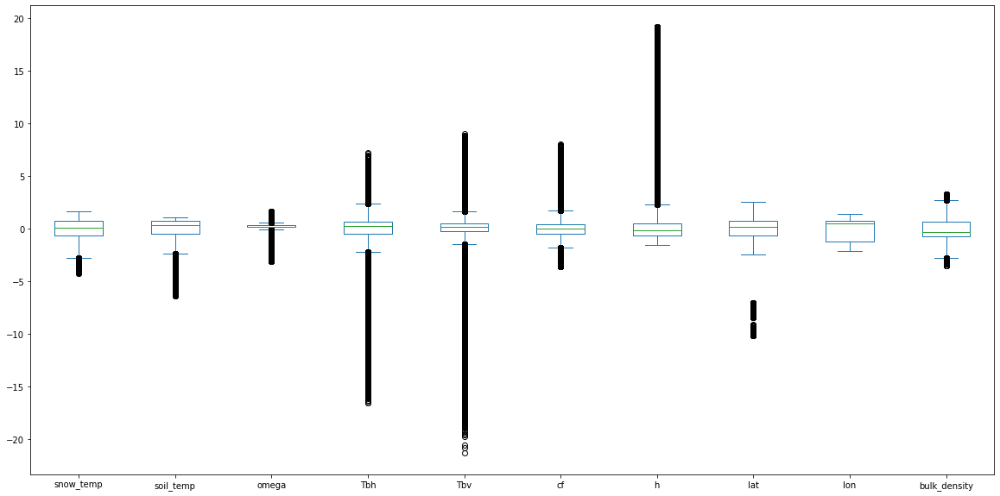

In [296]:
X_train_scaled.plot(kind='box', figsize=(20, 10))

## Actual Data Projection

In [226]:
org = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

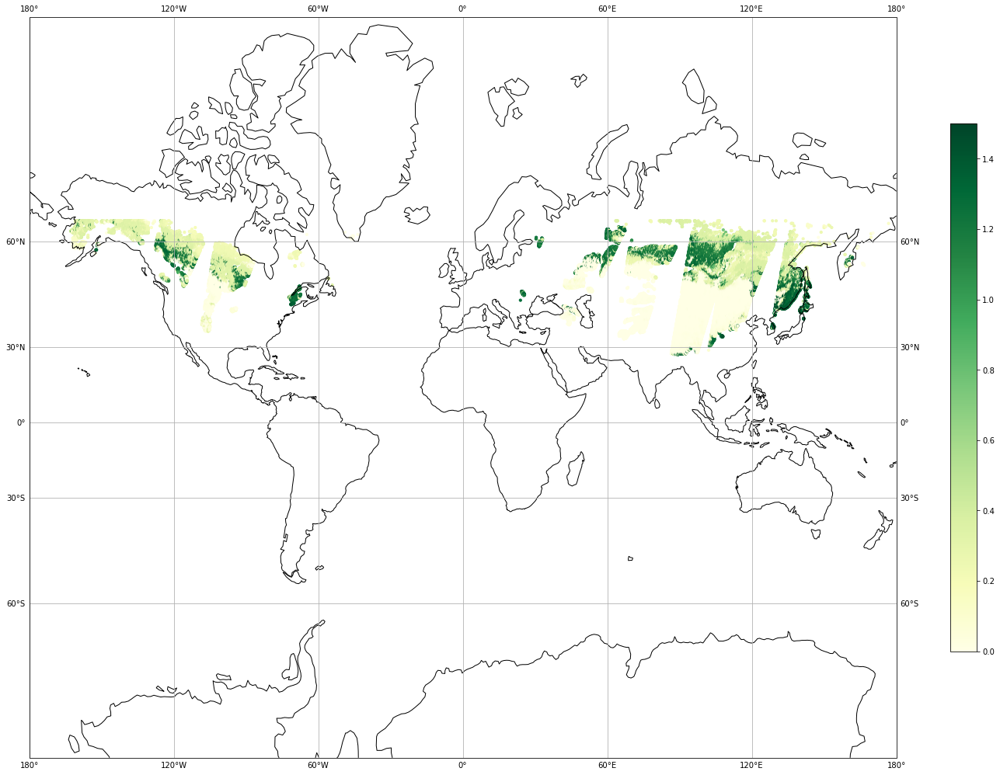

In [227]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(org["lon"], org["lat"], c=org["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

# Model Training

## Decision Tree Regressor

### 2019 as Train/Test

#### Original Data

In [115]:
model = DecisionTreeRegressor(random_state=0) 

In [116]:
%%time
model.fit(X_train, y_train)

CPU times: total: 6min 4s
Wall time: 7min 26s


DecisionTreeRegressor(random_state=0)

In [117]:
model.score(X_train, y_train)

1.0

In [118]:
model.score(X_test, y_test)

0.9940418076197383

In [119]:
with open("Models\\DTR\\vod_with_sd_dtr_model_org_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(model, file)

In [120]:
y_pred = model.predict(X_test)

In [121]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.0030492393323682853

In [122]:
mse = mean_squared_error(y_test, y_pred)
mse

0.000976598349226564

In [123]:
rmse = mse**(1/2.0)
rmse

0.03125057358236108

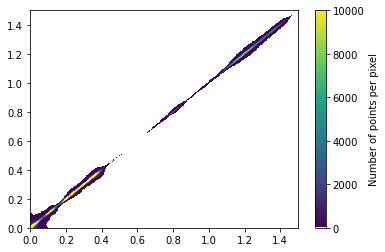

In [124]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [125]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [126]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [127]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]

In [130]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
39,244.261797,270.503662,0.067910,231.016602,251.182404,0.179635,0.498984,71.477135,-179.95332,0.668143,170.456981
40,241.000862,270.230011,0.067927,233.697037,251.819366,0.176907,0.524938,71.258770,-179.95332,0.668137,181.107467
41,242.431032,266.311371,0.068000,216.514282,239.150436,0.176647,0.538826,71.042830,-179.95332,0.678965,170.088242
52,247.576282,272.519745,0.068023,241.342239,254.537231,0.171793,0.719783,68.806526,-179.95332,0.633985,238.976149
54,239.590240,272.849518,0.060000,241.404099,251.667358,0.159154,0.873595,68.423706,-179.95332,0.746153,226.491759


In [129]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [131]:
y_sample_pred = model.predict(X_sample)

In [132]:
y_sample_pred

array([0.00708705, 0.11983018, 0.11442958, ..., 0.11027069, 0.03354469,
       0.03354469])

In [133]:
X_sample["vod"] = y_sample_pred

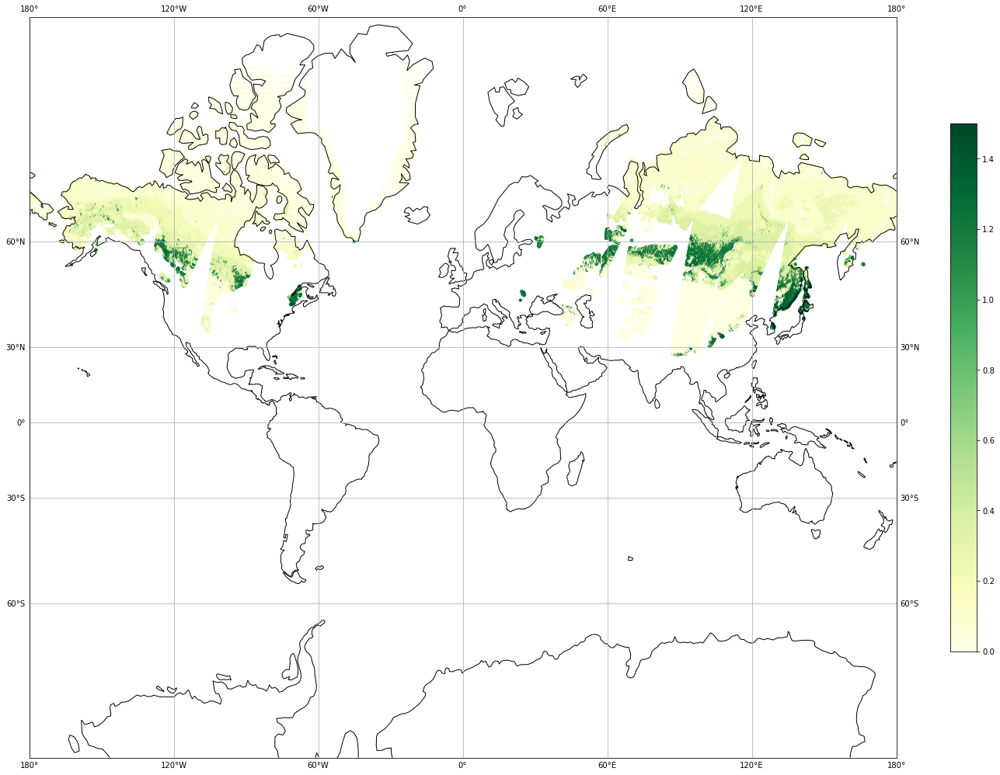

In [134]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

In [ ]:
import plotly.express as px
fig = px.density_mapbox(X_sample, lat='lat', lon='lon', z='vod', radius=1, color_continuous_scale='YlGn',
                        center=dict(lat=0, lon=180), zoom=0,
                        mapbox_style="open-street-map")
fig.show()

#### MinMax Scaled

In [238]:
model = DecisionTreeRegressor(random_state=0) 

In [239]:
%%time
model.fit(X_train, y_train)

CPU times: total: 6min 12s
Wall time: 7min 23s


DecisionTreeRegressor(random_state=0)

In [240]:
model.score(X_train, y_train)

1.0

In [241]:
model.score(X_test, y_test)

0.9927996109279458

In [242]:
with open("Models\\DTR\\vod_with_sd_dtr_model_min_max_scaled_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(model, file)

In [243]:
y_pred = model.predict(X_test)

In [244]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.0034420232269920313

In [245]:
mse = mean_squared_error(y_test, y_pred)
mse

0.0011802049401513615

In [246]:
rmse = mse**(1/2.0)
rmse

0.03435411096435711

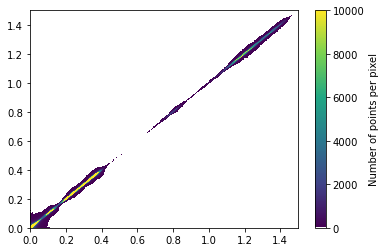

In [247]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [248]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [249]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [250]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]

In [251]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [252]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [253]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [254]:
y_sample_pred = model.predict(X_sample_scaled)

In [255]:
y_sample_pred

array([0.10678834, 0.11983018, 0.05829007, ..., 0.11027069, 0.10887843,
       0.10887843])

In [256]:
X_sample["vod"] = y_sample_pred

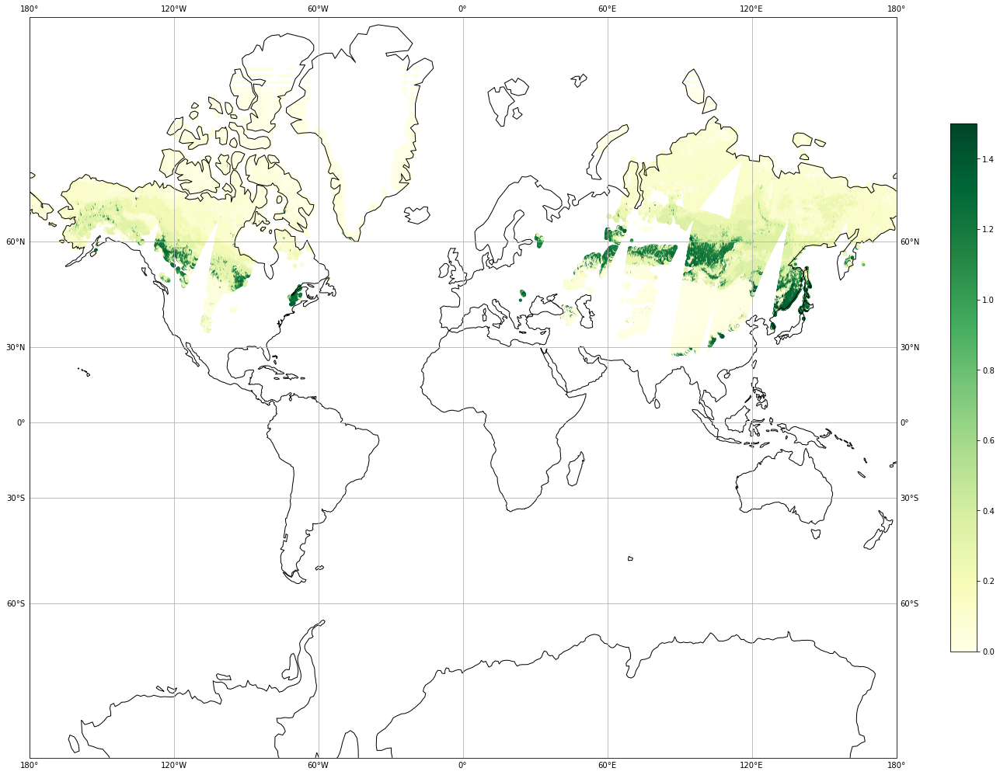

In [257]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

#### Robust Scaled

In [103]:
model = DecisionTreeRegressor(random_state=0) 

In [104]:
%%time
model.fit(X_train, y_train)

CPU times: total: 7min 9s
Wall time: 8min 25s


DecisionTreeRegressor(random_state=0)

In [105]:
model.score(X_train, y_train)

1.0

In [106]:
model.score(X_test, y_test)

0.9937871197609988

In [107]:
with open("Models\\DTR\\vod_with_sd_dtr_model_robust_scaled_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(model, file)

In [108]:
y_pred = model.predict(X_test)

In [109]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.0031237457989462857

In [110]:
mse = mean_squared_error(y_test, y_pred)
mse

0.0010183438529865678

In [111]:
rmse = mse**(1/2.0)
rmse

0.031911500324907444

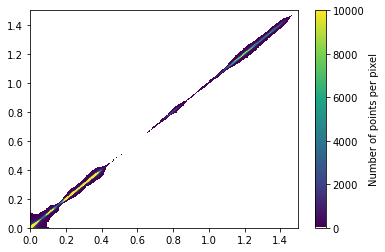

In [112]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [113]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [114]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [115]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]

In [116]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [117]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [118]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [119]:
y_sample_pred = model.predict(X_sample_scaled)

In [120]:
y_sample_pred

array([0.11983018, 0.11983018, 0.05533162, ..., 0.09690727, 0.09975558,
       0.09975558])

In [121]:
X_sample["vod"] = y_sample_pred

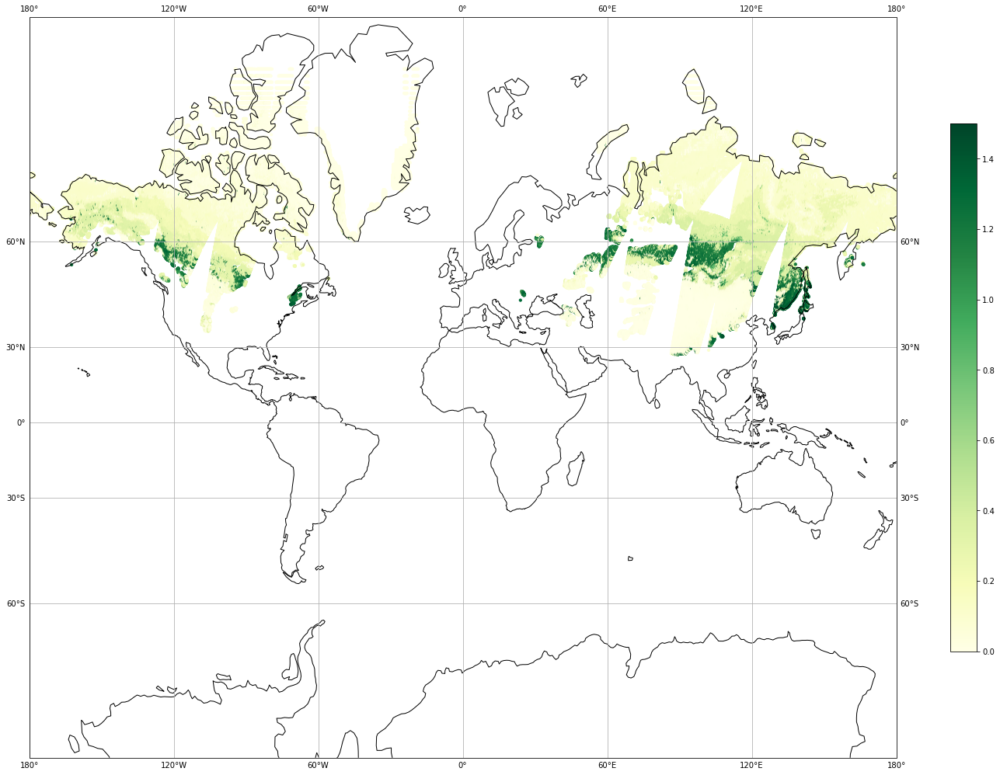

In [122]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

#### Standard Scaled

In [306]:
model = DecisionTreeRegressor(random_state=0) 

In [307]:
%%time
model.fit(X_train, y_train)

CPU times: total: 6min 53s
Wall time: 7min 26s


DecisionTreeRegressor(random_state=0)

In [308]:
model.score(X_train, y_train)

1.0

In [309]:
model.score(X_test, y_test)

0.993776619189197

In [310]:
with open("Models\\DTR\\vod_with_sd_dtr_model_standard_scaled_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(model, file)

In [311]:
y_pred = model.predict(X_test)

In [312]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.003122550279418035

In [313]:
mse = mean_squared_error(y_test, y_pred)
mse

0.00102006498591296

In [314]:
rmse = mse**(1/2.0)
rmse

0.03193845622307002

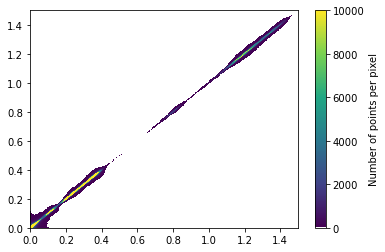

In [315]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [316]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [317]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [318]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]

In [319]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [320]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [321]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [322]:
y_sample_pred = model.predict(X_sample_scaled)

In [323]:
y_sample_pred

array([0.11442958, 0.11983018, 0.05533162, ..., 0.09690727, 0.09975558,
       0.09975558])

In [324]:
X_sample["vod"] = y_sample_pred

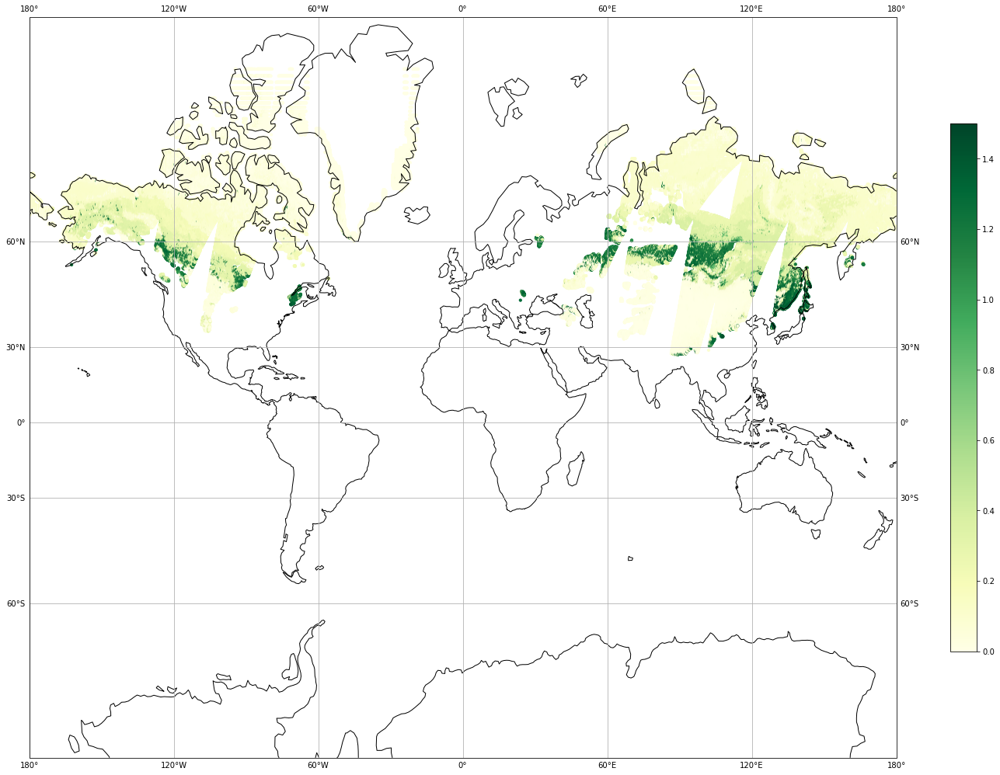

In [325]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

### 2019 as Train and 2020 as Test

#### Original Data

In [344]:
model = DecisionTreeRegressor(random_state=0) 

In [186]:
%%time
model.fit(X_train, y_train)

CPU times: total: 6min 30s
Wall time: 8min 7s


DecisionTreeRegressor(random_state=0)

In [187]:
model.score(X_train, y_train)

1.0

In [188]:
model.score(X_test, y_test)

0.9777423821488459

In [189]:
with open("Models\\DTR\\vod_with_sd_dtr_model_org_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(model, file)

In [190]:
y_pred = model.predict(X_test)

In [191]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.01553510025142161

In [192]:
mse = mean_squared_error(y_test, y_pred)
mse

0.003184734292352542

In [193]:
rmse = mse**(1/2.0)
rmse

0.05643345011916728

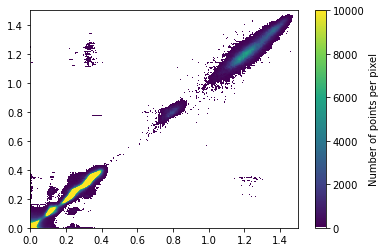

In [194]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [125]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [184]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [195]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]

In [196]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [197]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [198]:
y_sample_pred = model.predict(X_sample)

In [199]:
y_sample_pred

array([0.0249888 , 0.11983018, 0.05533162, ..., 0.09682374, 0.09975558,
       0.09975558])

In [200]:
X_sample["vod"] = y_sample_pred

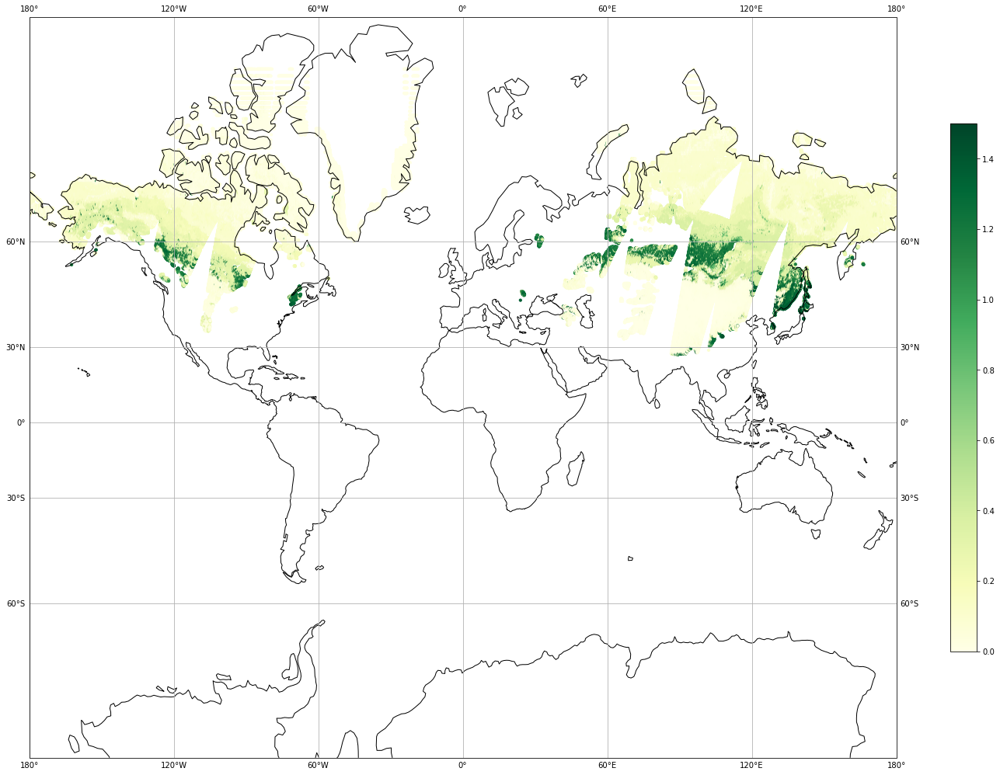

In [201]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

In [ ]:
import plotly.express as px
fig = px.density_mapbox(predict_sample, lat='lat', lon='lon', z='snow_density', radius=1, color_continuous_scale='Blues',
                        center=dict(lat=0, lon=180), zoom=0,
                        mapbox_style="open-street-map")
fig.show()

#### MinMax Scaled

In [21]:
model = DecisionTreeRegressor(random_state=0) 

In [22]:
%%time
model.fit(X_train, y_train)

CPU times: total: 7min 28s
Wall time: 8min 18s


DecisionTreeRegressor(random_state=0)

In [23]:
model.score(X_train, y_train)

1.0

In [24]:
model.score(X_test, y_test)

0.9777905448041977

In [25]:
with open("Models\\DTR\\vod_with_sd_dtr_model_min_max_scaled_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(model, file)

In [26]:
y_pred = model.predict(X_test)

In [27]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.01553072629429331

In [28]:
mse = mean_squared_error(y_test, y_pred)
mse

0.0031778429322287687

In [29]:
rmse = mse**(1/2.0)
rmse

0.05637235964751492

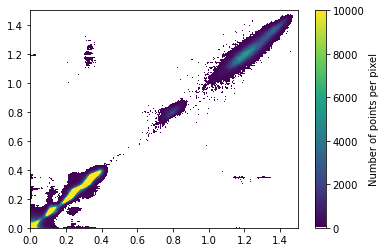

In [30]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [31]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [32]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [33]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]

In [34]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [35]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [36]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [37]:
y_sample_pred = model.predict(X_sample_scaled)

In [38]:
y_sample_pred

array([0.11983018, 0.11983018, 0.05533162, ..., 0.10887843, 0.10887843,
       0.00241002])

In [39]:
X_sample["vod"] = y_sample_pred

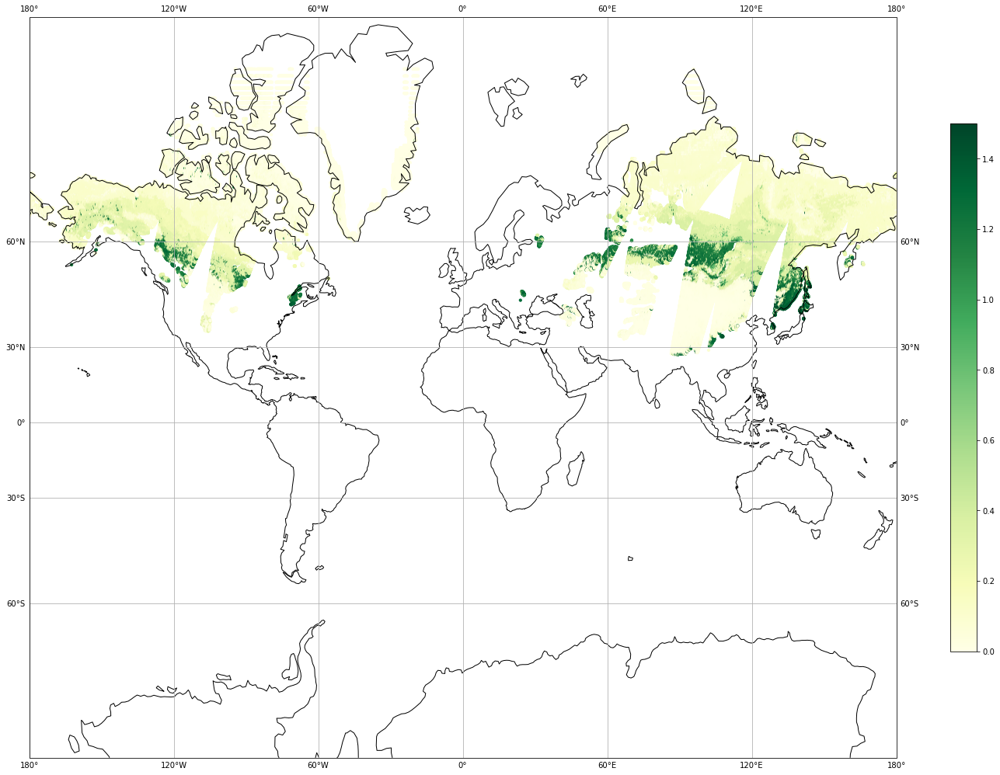

In [40]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

#### Robust Scaled

In [56]:
model = DecisionTreeRegressor(random_state=0) 

In [57]:
%%time
model.fit(X_train, y_train)

CPU times: total: 7min 4s
Wall time: 8min 54s


DecisionTreeRegressor(random_state=0)

In [58]:
model.score(X_train, y_train)

1.0

In [59]:
model.score(X_test, y_test)

0.978053554102887

In [225]:
with open("Models\\DTR\\vod_with_sd_dtr_model_robust_scaled_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(model, file)

In [61]:
y_pred = model.predict(X_test)

In [62]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.015493056572367986

In [63]:
mse = mean_squared_error(y_test, y_pred)
mse

0.003140210210778297

In [64]:
rmse = mse**(1/2.0)
rmse

0.05603757855919809

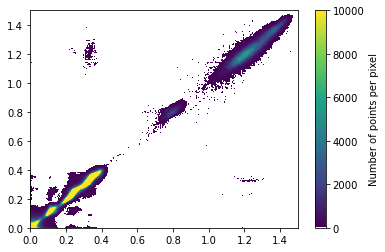

In [65]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [66]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [67]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [68]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]

In [69]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [70]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [71]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [72]:
y_sample_pred = model.predict(X_sample_scaled)

In [73]:
y_sample_pred

array([0.10193081, 0.10193081, 0.05533162, ..., 0.09690727, 0.09975558,
       0.03773982])

In [74]:
X_sample["vod"] = y_sample_pred

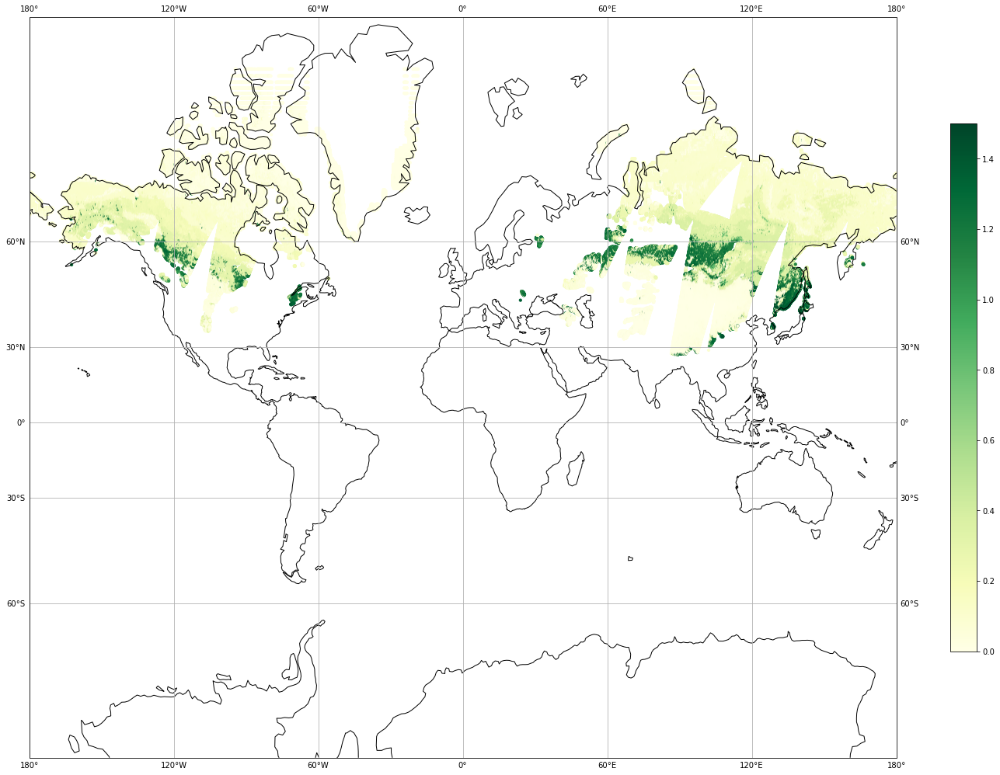

In [75]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

#### Standard Scaled

In [138]:
model = DecisionTreeRegressor(random_state=0) 

In [139]:
%%time
model.fit(X_train, y_train)

CPU times: total: 7min 55s
Wall time: 8min 15s


DecisionTreeRegressor(random_state=0)

In [140]:
model.score(X_train, y_train)

1.0

In [141]:
model.score(X_test, y_test)

0.9778240691425107

In [142]:
with open("Models\\DTR\\vod_with_sd_dtr_model_standard_scaled_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(model, file)

In [143]:
y_pred = model.predict(X_test)

In [144]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.015521311157477439

In [145]:
mse = mean_squared_error(y_test, y_pred)
mse

0.0031730460976992065

In [146]:
rmse = mse**(1/2.0)
rmse

0.05632979760037494

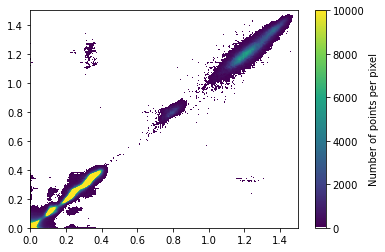

In [147]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [148]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [149]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [150]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]

In [151]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [152]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [153]:
X_sample_scaled = pd.DataFrame(scaler.transform(X_sample), columns=X_sample.columns)

In [154]:
y_sample_pred = model.predict(X_sample_scaled)

In [155]:
y_sample_pred

array([0.11983018, 0.11983018, 0.05533162, ..., 0.09690727, 0.09975558,
       0.03773982])

In [156]:
X_sample["vod"] = y_sample_pred

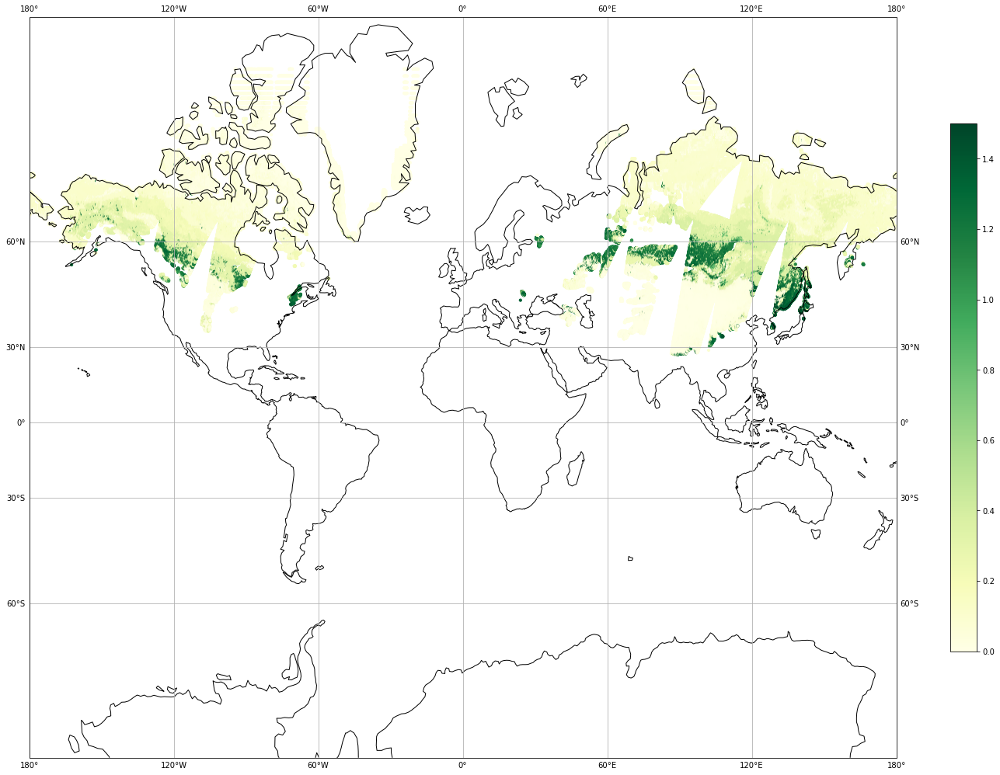

In [157]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

## Random Forest Regressor

### 2019 as Train/Test

In [241]:
base_model = RandomForestRegressor(n_estimators=10, random_state=0)

In [242]:
%%time
base_model.fit(X_train, y_train)

CPU times: total: 36min 11s
Wall time: 47min 33s


RandomForestRegressor(n_estimators=10, random_state=0)

In [243]:
base_model.score(X_train, y_train)

0.9992560542785611

In [244]:
base_model.score(X_test, y_test)

0.9961215788790598

In [245]:
y_pred = base_model.predict(X_test)

In [246]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.0036502857262792564

In [247]:
mse = mean_squared_error(y_test, y_pred)
mse

0.0006357061710298679

In [248]:
rmse = mse**(1/2.0)
rmse

0.025213214214571452

In [249]:
with open("Models\\RFR\\vod_with_sd_rfr_base_model_2019_test_train_split_80_20.pkl", 'wb') as file:
    pickle.dump(base_model, file)

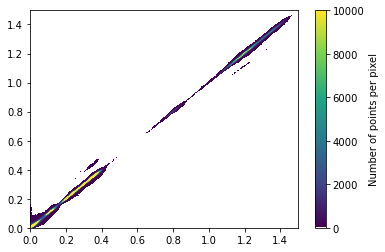

In [250]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [125]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [251]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [252]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]

In [253]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,NaN,NaN


In [254]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [255]:
y_sample_pred = model.predict(X_sample)

In [256]:
y_sample_pred

array([0.00204113, 0.00204113, 0.00204113, ..., 0.10000982, 0.10000982,
       0.10000982])

In [257]:
X_sample["vod"] = y_sample_pred

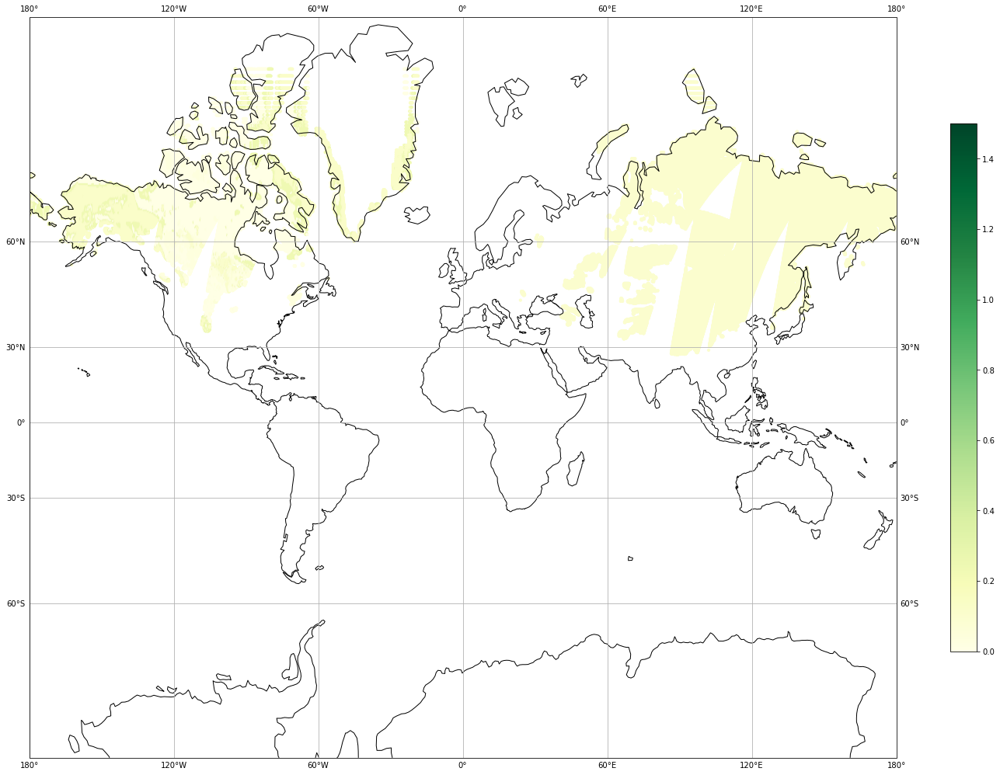

In [258]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

### 2019 as Train and 2020 as Test

In [265]:
base_model_2019_train = RandomForestRegressor(n_estimators=10, random_state=0)

In [266]:
%%time
base_model_2019_train.fit(X_train, y_train)

CPU times: total: 40min 21s
Wall time: 52min 33s


RandomForestRegressor(n_estimators=10, random_state=0)

In [267]:
base_model_2019_train.score(X_train, y_train)

0.999428417334366

In [268]:
base_model_2019_train.score(X_test, y_test)

0.9859948405617496

In [269]:
y_pred = base_model_2019_train.predict(X_test)

In [270]:
mae = mean_absolute_error(y_test, y_pred)
mae

0.015075133977077193

In [271]:
mse = mean_squared_error(y_test, y_pred)
mse

0.0020039301524151345

In [272]:
rmse = mse**(1/2.0)
rmse

0.04476527842441209

In [273]:
with open("Models\\RFR\\vod_with_sd_rfr_base_model_2019_train_2020_test.pkl", 'wb') as file:
    pickle.dump(base_model_2019_train, file)

In [31]:
with open("Models\\RFR\\vod_with_sd_rfr_base_model_2019_train_2020_test.pkl", "rb") as file:
    base_model_2019_train = pickle.load(file)

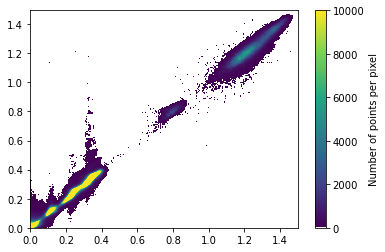

In [274]:
fig = plt.figure()

white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, vmin=0, vmax=10000)
fig.colorbar(density, label='Number of points per pixel')
plt.show()

In [51]:
sample = pd.read_csv(os.path.join(dir_path, "01_01_2020_projection.csv"))

In [52]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.65642,-179.95332,01_01_2020,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.95421,-179.95332,01_01_2020,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.32521,-179.95332,01_01_2020,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.75034,-179.95332,01_01_2020,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.21760,-179.95332,01_01_2020,NaN


In [47]:
X_sample = sample[['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density']]

In [50]:
X_sample.head()

,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,lat,lon,bulk_density,snow_density
39,244.261797,270.503662,0.067910,231.016602,251.182404,0.179635,0.498984,71.477135,-179.95332,0.668143,170.456981
40,241.000862,270.230011,0.067927,233.697037,251.819366,0.176907,0.524938,71.258770,-179.95332,0.668137,181.107467
41,242.431032,266.311371,0.068000,216.514282,239.150436,0.176647,0.538826,71.042830,-179.95332,0.678965,170.088242
52,247.576282,272.519745,0.068023,241.342239,254.537231,0.171793,0.719783,68.806526,-179.95332,0.633985,238.976149
54,239.590240,272.849518,0.060000,241.404099,251.667358,0.159154,0.873595,68.423706,-179.95332,0.746153,226.491759


In [49]:
X_sample.dropna(axis=0, how='any', inplace=True)

In [37]:
y_sample_pred = base_model_2019_train.predict(X_sample)

In [55]:
y_sample_pred

array([0.15544038, 0.11875006, 0.08059098, ..., 0.10633937, 0.09116471,
       0.08501687])

In [39]:
X_sample["vod"] = y_sample_pred

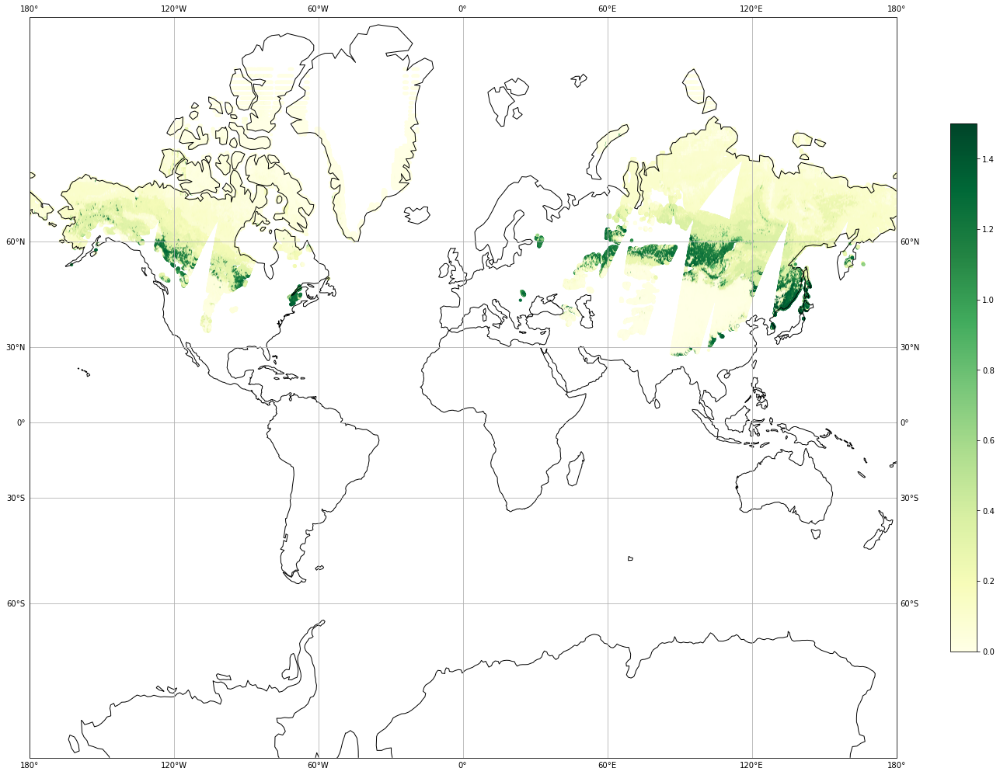

In [40]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(X_sample["lon"], X_sample["lat"], c=X_sample["vod"], vmin=0, vmax=1.5, cmap='YlGn', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
#ax1.text(-37, 60.5, '37 GHz', fontsize=14, transform=ccrs.PlateCarree())
cbar = plt.colorbar(plot1, shrink = .5)

In [58]:
sample.head()

,snow_density,snow_temp,soil_temp,omega,Tbh,Tbv,cf,h,bulk_density,lat,lon,date,vod,vod_pred,vod_pred_difference
39,170.456981,244.261797,270.503662,0.067910,231.016602,251.182404,0.179635,0.498984,0.668143,71.477135,-179.95332,01_01_2020,NaN,0.155440,NaN
40,181.107467,241.000862,270.230011,0.067927,233.697037,251.819366,0.176907,0.524938,0.668137,71.258770,-179.95332,01_01_2020,NaN,0.118750,NaN
41,170.088242,242.431032,266.311371,0.068000,216.514282,239.150436,0.176647,0.538826,0.678965,71.042830,-179.95332,01_01_2020,NaN,0.080591,NaN
52,238.976149,247.576282,272.519745,0.068023,241.342239,254.537231,0.171793,0.719783,0.633985,68.806526,-179.95332,01_01_2020,NaN,0.109071,NaN
54,226.491759,239.590240,272.849518,0.060000,241.404099,251.667358,0.159154,0.873595,0.746153,68.423706,-179.95332,01_01_2020,NaN,0.077950,NaN


In [53]:
sample.dropna(axis=0, subset=['snow_temp','soil_temp', 'omega', 'Tbh', 'Tbv', 'cf', 'h', 'lat', 'lon', 'bulk_density', 'snow_density'], inplace=True)

In [56]:
sample["vod_pred"] = y_sample_pred

In [57]:
sample["vod_pred_difference"] = sample["vod"] - sample["vod_pred"]

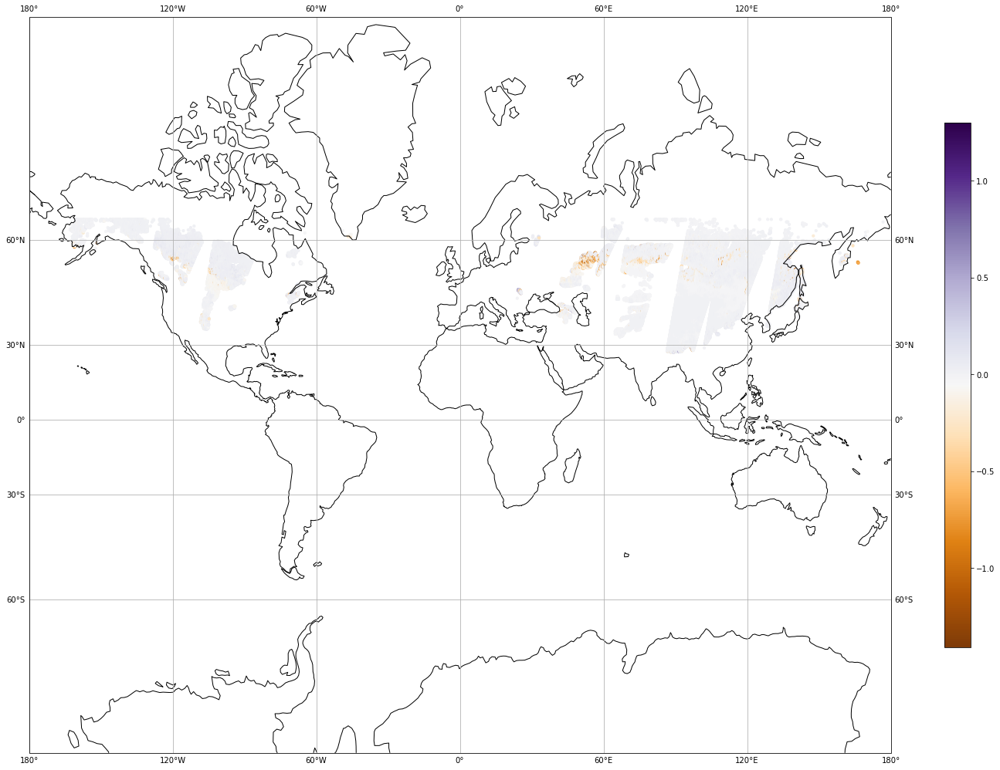

In [59]:
# %% Visualizing The data
fig = plt.figure(figsize=(25, 25))
ax1 = plt.subplot(111, projection=ccrs.Mercator())
#plot1 = plt.contourf(Lon, Lat, Data1, 10, cmap = 'Blues', vmin=100, vmax=450, transform=ccrs.PlateCarree())
plot1 = plt.scatter(sample["lon"], sample["lat"], c=sample["vod_pred_difference"], cmap='PuOr', s=10, transform=ccrs.PlateCarree())
ax1.set_global()
ax1.coastlines()
ax1.gridlines(draw_labels = True)
#ax1.set_extent([-180, 180, -90, 90])
#ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())  
cbar = plt.colorbar(plot1, shrink = .5)